# MultiOmics RNA + ATAC for Chao dataset emphasis on OL population (MORNAATACCOL) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACCOL 4 notebook**

<hr>

Related paper : [Mimitou et al. (2020)](https://www.biorxiv.org/content/10.1101/2020.09.08.286914v1)

Data used in this notebook :

In [ ]:
#/Castelo_Branco/NGSDATA/EAE_multiomics_EAMM_250521/Processed_data/ARC2
#/Castelo_Branco/NGSDATA/EAE_late_multiomics_CZ_030721/Processed_data
#only the filtered_feature_bc_matrix repositories, atac_fragments.tsv.gz and atac_fragments.tsv.gz.tbi

#/Castelo_Branco/NGSDATA/Datasets_from_literature

#Memory needed for a full run : 120Gb

In [ ]:
#Early1          = P21208_1003_EAE_ARC
#PeakCtrl2       = P21208_1004_EAE_ARC
#Peak2           = P21208_1005_EAE_ARC
#Late1           = MORNAATACC_1003
#EarlyCtrl2      = P23605_1002
#Peak3           = P23605_1003
#PeakCtrl3       = P23605_1004
#EarlyCtrl3      = P24115_1001
#EarlyFemale3    = P24115_1002
#EarlyMale3      = P24115_1003
#Late2           = P25316_1001
#LateCtrl2       = P25316_1002
#Late3           = P25316_1003
#LateCtrl3       = P25316_1004
#PeakMale4        = P27208_1001
#PeakFemale4      = P27208_1002
#LateMale4        = P27208_1003
#LateFemale4      = P27208_1004

## 0. Environment status

In [5]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [3]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [4]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              20
On-line CPU(s) list: 0-19
Thread(s) per core:  1
Core(s) per socket:  10
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               79
Model name:          Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz
Stepping:            1
CPU MHz:             2735.498
CPU max MHz:         3100.0000
CPU min MHz:         1200.0000
BogoMIPS:            4390.12
Virtualization:      VT-x
L1d cache:           640 KiB
L1i cache:           640 KiB
L2 cache:            5 MiB
L3 cache:            50 MiB
NUMA node0 CPU(s):   0-9
NUMA node1 CPU(s):   10-19
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_t

In [5]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

128374


In [ ]:
apt list --installed

In [ ]:
pip list

In [9]:
jupyter --version

Selected Jupyter core packages...
IPython          : 7.30.1
ipykernel        : 6.6.0
ipywidgets       : 7.6.5
jupyter_client   : 7.1.0
jupyter_core     : 4.9.1
jupyter_server   : 1.13.1
jupyterlab       : 3.1.17
nbclient         : 0.5.9
nbconvert        : 6.2.0
nbformat         : 5.1.3
notebook         : 6.4.6
qtconsole        : 5.2.2
traitlets        : 5.1.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [2]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(ggplot2)
library(caret)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(scales)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

#Doublet determination
#Cannot be installed through conda
library(DoubletFinder)

library(textclean)
library(mclust)

#ArchR
library(ArchR)
library(TxDb.Mmusculus.UCSC.mm10.knownGene)

library(muscat)
library(SingleCellExperiment)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

Attaching SeuratObject

Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following objects are masked from ‘package:base’:

    I, expand.grid, unname


Loading required package: IRanges

Loading required package: GenomeInfoDb

Loading requir

In [3]:
sessionInfo()

R version 4.2.3 (2023-03-15)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.4 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.9.0
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.9.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] EnhancedVolcano_1.16.0                   
 [2] DESeq2_1.38.3                            
 [3] Matrix.utils_0.9.8                       
 [4] limma_3.54.2                             
 [5] UpSetR_1.4.0                             
 [6] scater_1.26.1                            
 [7] scuttle_1.8.4                            
 [8] Sing

### 1.2 Functions

In [4]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, slot = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = slot == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = GetAssayData(object = object, slot = slot))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", slot,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", slot, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = GetAssayData(object = object, slot = slot)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

### 1.3 Set up R parameters

In [5]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [6]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#B0BFB0
#8FA38F
#6E876E
#536553
#374337

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [7]:
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl1", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "EarlyMale3", "EarlyFemale3")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4")

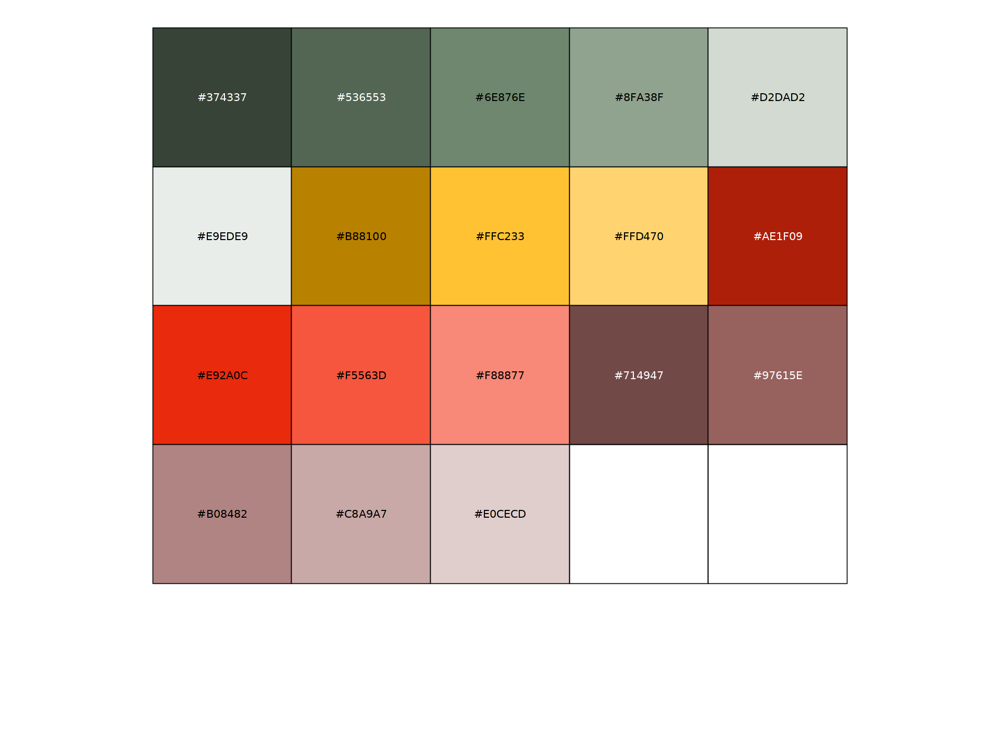

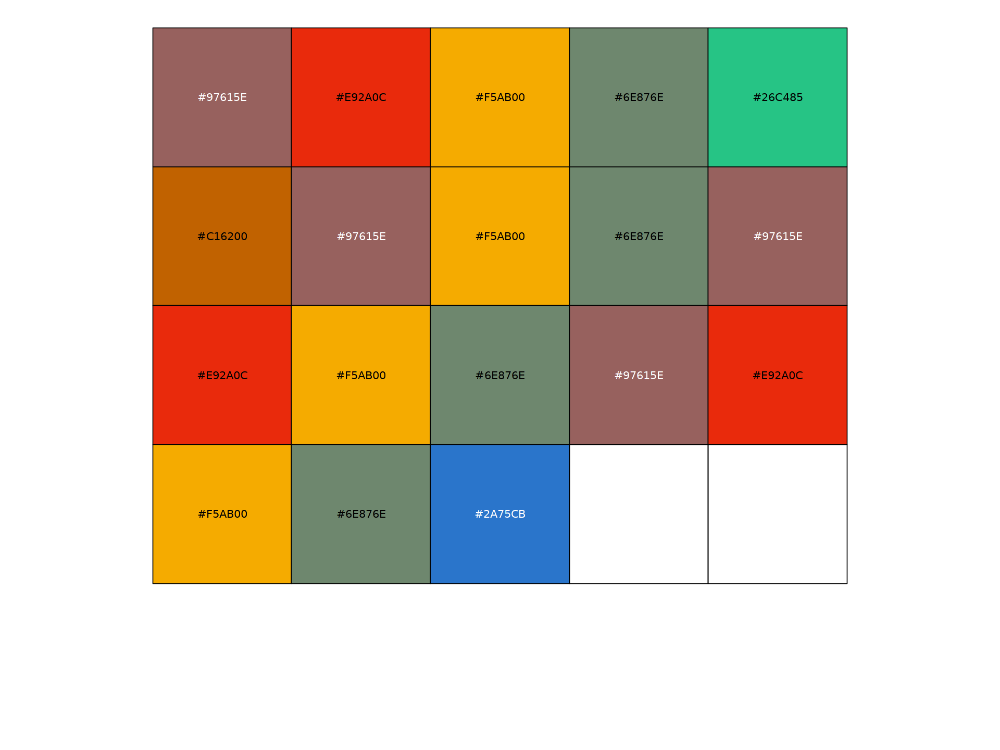

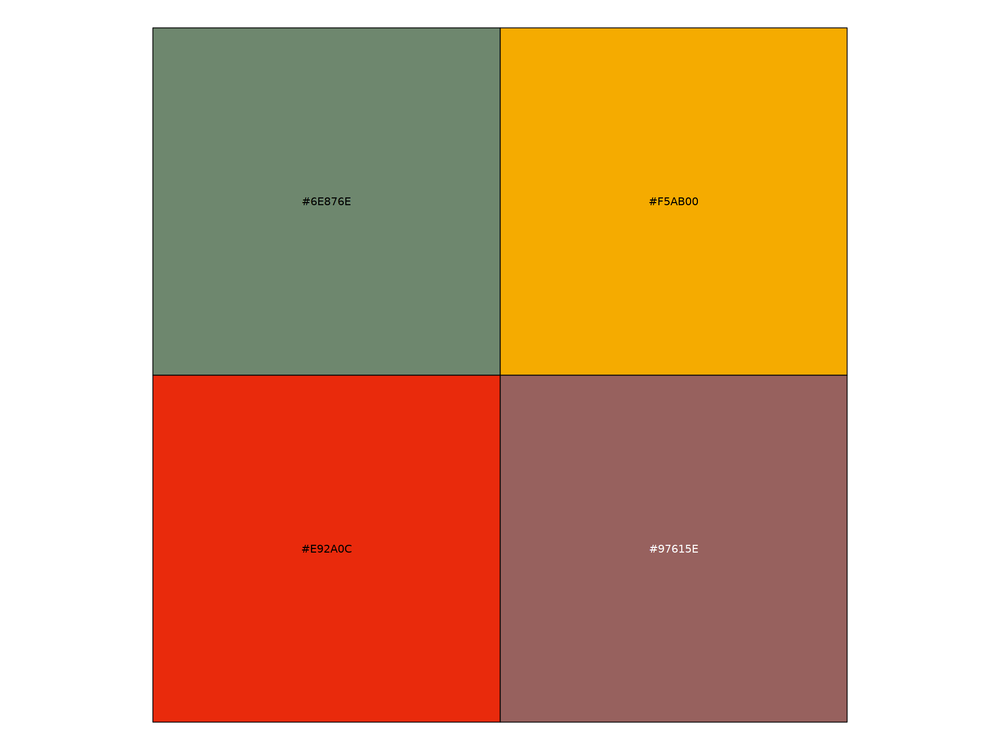

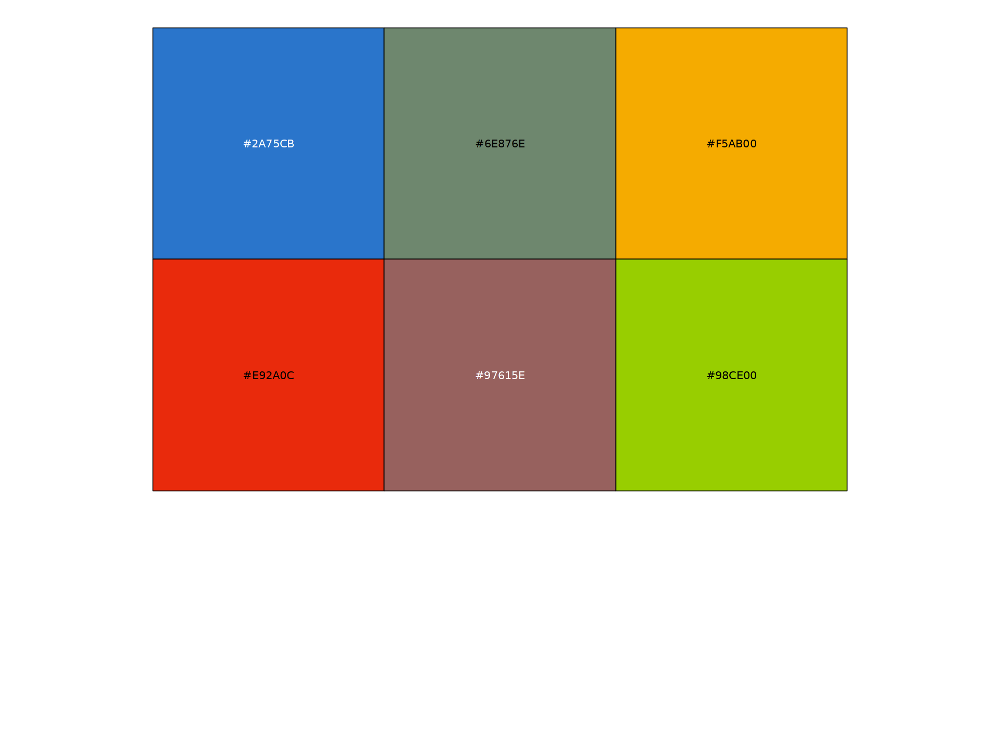

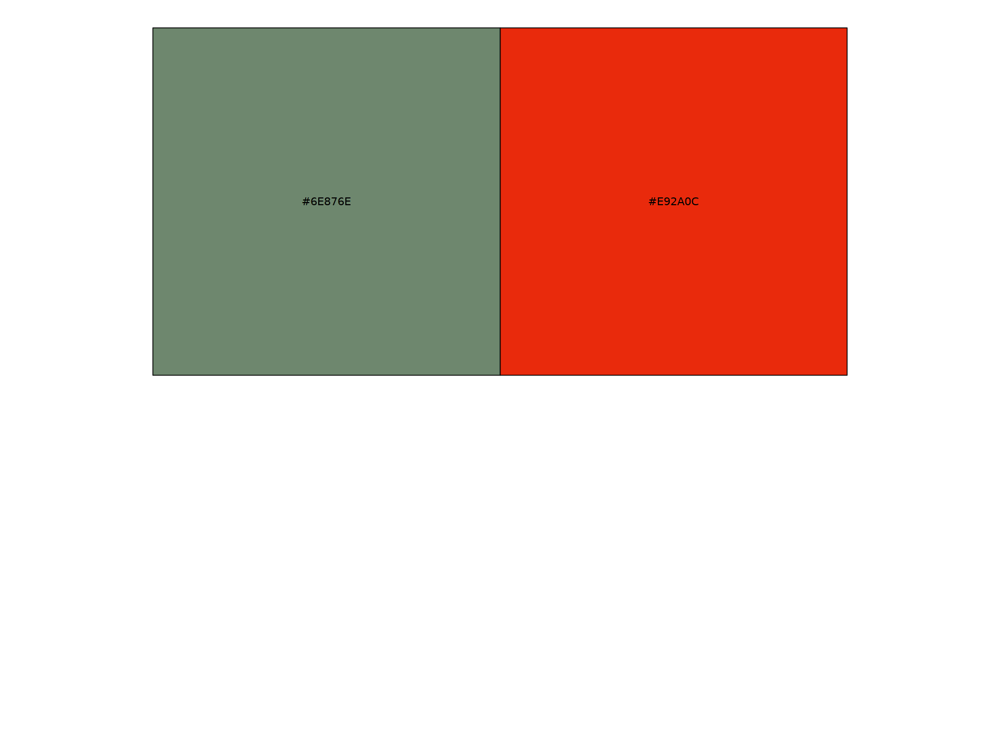

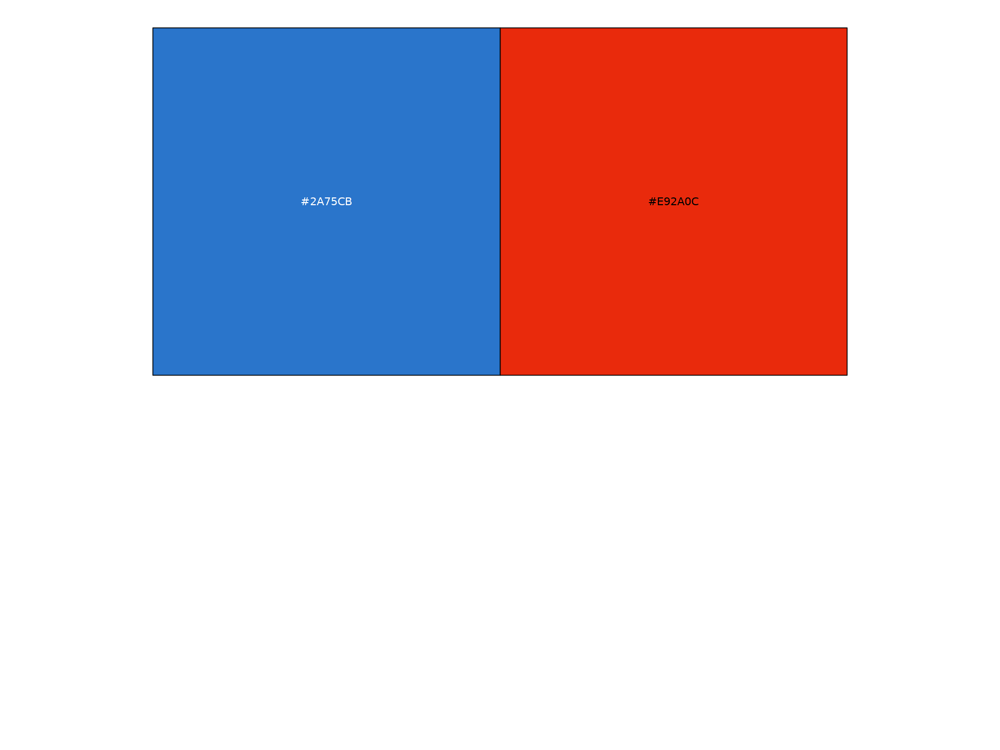

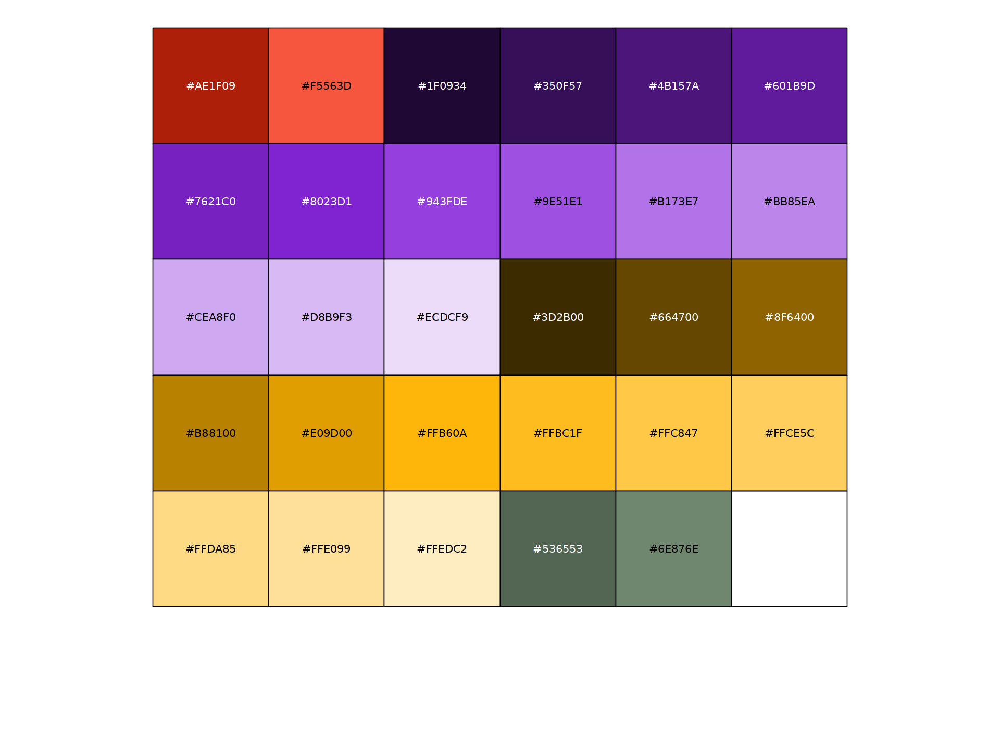

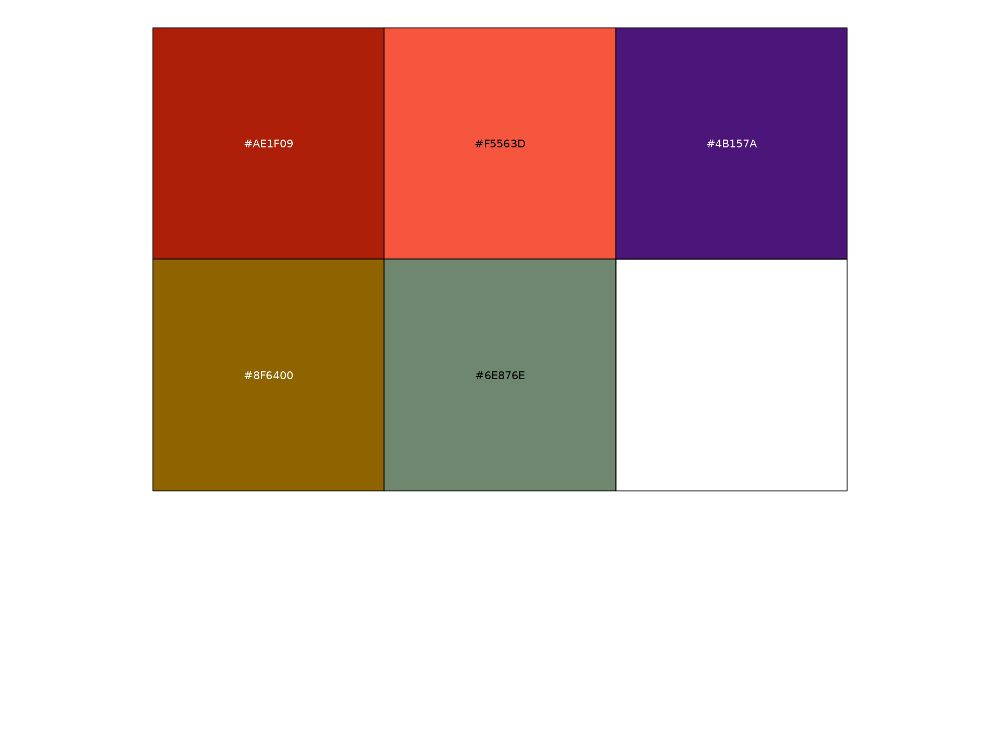

In [8]:
orig.ident_colors <- c("#374337", "#536553", "#6E876E", "#8FA38F", "#D2DAD2", "#E9EDE9", "#B88100", "#FFC233", "#FFD470", "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD")
names(orig.ident_colors) <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors)
orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#97615E", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#2A75CB")
names(orig.ident_colors_contrast) <- c("EarlyCtrl2", "EarlyCtrl3", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3", "Early1", "EarlyMale3", "EarlyFemale3", "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Late1", "Late2","Late3", "LateMale4", "LateFemale4")
show_col(orig.ident_colors_contrast)

orig.ident_merge_colors <- c("#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Ctrl", "Early", "Peak", "Late")
show_col(orig.ident_merge_colors)

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6")
show_col(batch_colors)

model_colors <- c("#6E876E", "#E92A0C")
names(model_colors) <- c("Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#2A75CB", "#E92A0C")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("M", "F")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

cellType_OL_colors <- c("#AE1F09","#F5563D", "#1F0934", "#350F57", "#4B157A", "#601B9D", "#7621C0", "#8023D1", "#943FDE", "#9E51E1", "#B173E7", "#BB85EA", "#CEA8F0", "#D8B9F3", "#ECDCF9","#3D2B00", "#664700", "#8F6400", "#B88100", "#E09D00", "#FFB60A", "#FFBC1F", "#FFC847", "#FFCE5C", "#FFDA85", "#FFE099", "#FFEDC2"
,"#536553", "#6E876E")
names(cellType_OL_colors) <- c("OPC", "COP", "MOL56-α","MOL56-β","MOL56-γ","MOL56-δ","MOL56-ε","MOL56-ζ","MOL56-η","MOL56-θ","MOL56-ι","MOL56-κ","MOL56-λ","MOL56-μ","MOL56-ν","MOL2-α","MOL2-β","MOL2-γ","MOL2-δ","MOL2-ε","MOL2-ζ","MOL2-η","MOL2-θ","MOL2-ι","MOL2-κ","MOL2-λ","MOL2-μ",
 "MOL1-α", "MOL1-β")
show_col(cellType_OL_colors)

cellType_OL_merge_colors <- c("#AE1F09","#F5563D","#4B157A","#8F6400", "#6E876E")
names(cellType_OL_merge_colors) <- c("OPC", "COP", "MOL56", "MOL2", "MOL1")
show_col(cellType_OL_merge_colors)

In [9]:
%put OS_path_datasets OS_path_outputs OS_path_inputs

In [9]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [10]:
MORNAATACCOL <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL.rds"))

In [11]:
MORNAATACCOL@meta.data <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL_annot_CHAO.rds"))

## 3. OL dynamics

https://hbctraining.github.io/DGE_workshop/lessons/04_DGE_DESeq2_analysis.html#:~:text=The%20DESeq2%20dispersion%20estimates%20are,only%20based%20on%20their%20variance

https://support.bioconductor.org/p/9143599/

### 3.1 Temporal time course (DGE)

#### 3.1.1 MOL56

In [341]:
cluster_choice = "MOL56"

In [342]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [343]:
table_sample_low <- table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

named integer(0)

In [344]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [345]:
table_group_low <-table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

named integer(0)

In [346]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [347]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [348]:
DefaultAssay(tmp) <- "GenePromAcc"

In [349]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [350]:
DefaultAssay(tmp) <- "RNA"

In [351]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [352]:
dynamics_genes <- c("Txnrd3","Clrn1","Gm20515","Gja1","Gm27153","Gprasp2","Maged2","B4galt4","Ngfr","Insyn2a","Cdh8","Nucb2","Gm48512","Deptor","Asphd1","4930426I24Rik","Gm34299","Ptprt","Limk1","Eps8l2","Wnt5b","Pabpc5","Adgrv1","4930419G24Rik","Gm26936","Slc7a15","Gm13905","4930565N06Rik","Gm47271","Gm17160","Rwdd3","Gm3764","Gm6994","Kctd4","1700085D07Rik","2410021H03Rik","Tmem81","Nid1","5830418P13Rik","9330175M20Rik","Gm12146","Qpct","C630043F03Rik","Mvd","Gm48342","Gm39129","Sh3bp4","Gm32122","Slc1a5","C1qtnf4","Armcx6","9630009A06Rik","Bcas3os1","1700063D05Rik","Fmnl3","C730002L08Rik","Gm26724","Paqr7","Gm28376","Gm48370","Gm29502","Enpp1","Per3","Gm26743","Slc4a4","Gm13684","Mgat4c","Nell2","Ccdc153","Rmst","Gm44686","Hist1h1e","Dnm3os","Gm43376","Gm13708","Mia","Rnf152","Tenm4","Mfsd13b","Gm34590","Col9a1","Gm15398","9330111N05Rik","Gng8","5330438D12Rik","Eya2","Dse","Gabra3","Gm37459","4930512B01Rik","Lrrtm3","Nyap2","Nat8f1","Scg5","Dhcr24","Hmgcs1","Hmgcr","Gm28501","Pla2g7","Msmo1","Fdft1","Sqle","Syn2","Bex2","Psat1","Etv1","Atp1a2","Gm10401","Aldh1l2","Oasl1","Sez6l2","Scd1","Lrtm1","Scg3","Fam183b","Hint1","Eid2","Ceacam1","Tlr3","Pcsk2","Nfkbia","Samhd1","Mov10","3110082J24Rik","Gm45890","Fndc5","Begain","Htr2b","Idi1","Arl4d","4930445B16Rik","Fam181b","Bbox1","Socs1","Kirrel2","Gm15813","Fbxo2","Pim3","Kctd13","Phtf1os","Ntsr2","2810457G06Rik","Gm28221","Etv6","Gabra2","Gm28379","Pdzk1","Gm15956","Mrgpra2b","Cp","Gm13572","Gm26672","Spry2","Gm15601","Gm19466","Maneal","Gm44777","Sgsm1","Gm37756","Serpinb9","Ndst4","Gm37165","Drd2","Mfsd4a","Ddx58","Gm29361","Hapln2","Cxcl10","Acsl6","Cab39l","Itgad","Ptger4","Galntl6","Scrg1","Nmi","Nap1l3","Gstm1","Chdh","Pcp4l1","Sppl2b","Slc14a1","Cavin2","Mrgpra1","Slc6a11","Errfi1","Anln","Gm26879","Pon2","Gm17638","Sema3e","Gm5820","Htra1","Rsad2","Gm10076","Mrgpra9","Rbl1","Mfsd2a","1700094J05Rik","1700022I11Rik","Gm15886","Cacng5","Kdr","Lpo","Irf1","Casp7","C1ql3","Pmvk","Gstm6","Slc38a2","Ccdc152","Herc6","4930414N06Rik","Hist2h2aa1","Srsf2","Spry1","Efemp1","Mgst2","Insig1","Agt","Nsdhl","Enc1","Lrrtm2","Rfng","Tubb2a","Ccl2","Jmjd8","Stk16","F3","1700094M23Rik","Gm26854","Hsd17b10","Tshb","Noc4l","AC156546.1","Lrrtm1","Gjb6","Slc35b1","Gm43464","Gm27252","Gpr37l1","Cplx2","Gm11772","Gm44866","Snhg1","Selenop","Dalrd3","Got1","Gm31305","Rpgrip1","Enho","Sparcl1","Arpc1a","Pmm1","Rpl8","Ywhab","Mlc1","Stard4","Fau","Pml","Ablim1","Sdf2l1","Tpd52l1","Gstk1","Sox9","Gm36043","Kcnk1","Rab5if","Ccr9","Defb47","Gm32036","Romo1","Gm44850","Cdk6","Cetn2","Gas5","Slc25a29","Slc39a12","Ramp1","Gm33255","Hey1","Gm17089","Slc24a5","Rack1","Gm32568","Brip1","Map7d2","Cdh24","Slc1a2","Col16a1","A930037H05Rik","Fth1","Pigh","AW047730","Nfkbib","Daglb","Lefty1","Rps25","Rps12","Oaz3","Mettl23","Ccne2","Cebpd","Higd1a","Fgfrl1","A230056P14Rik","Zfp771","Gm34408","Rpl37","Cdiptos","Dbi","Fam57a","Acat2","Mcl1","Manf","Lrp11","Rpl29","Rpl13","Bricd5","Sc5d","Krt10","2410004B18Rik","Lypla2","Mitd1","Kcnj16","Wfdc18","Acd","Slc7a10","Nubp2","Gm15559","Tril","Tmem255a","Gm42917","Bach2os","Lss","Slc25a5","Wdr54","Ttyh1","Ccdc24","Gm9895","St6galnac5","Gm15657","Gm14858","Cldn10","C530005A16Rik","Slc25a22","Slc9a3r1","Gm46332","Gfap","Ticam1","Mt3","Avpi1","Gpd1","Txn1","Gm38642","Zbtb45","H2-DMa","Cdr2l","Nrxn3","Hist2h3c1","Parp3","Olfm2","Irgq","Ddah1","Psmb10","Mvk","Sdc4","Smpdl3a","Hap1","Tubb4b","Mdk","Efemp2","Gsta4","Tapbp","Cd74","Igfbp2","Fen1","Plac8","Ucp2","Oscp1","Timeless","Tmsb10","Lbh","Sptbn2","Gadd45g","Wfdc17","S100a6","Dpp7","Ssbp4","Aff2","Fyb","Hist2h3c2","Ier5l","Tcirg1","Kif9","Gpnmb","Gm20559","Vim","Kcnma1","Sec61g","Fn1","Tmem150a","Serpine2","Ncf2","Ppp1cc","Snhg3","1500009C09Rik","Cebpa","Ddit4","Kars","Ndrg2","Smim4","Atp8a2","Tubb2b","Ifi30","Hdhd3","Fabp7","Gmpr","Ebp","Crip2","Cenpj","1600014C10Rik","Ppif","Spag5","Tuba1a","Rgs1","Ficd","Pygm","Ctsc","Ier3","Cadps2","Rnd2","Arrdc2","Dtnb","Unc13a","Rbm3","Ccdc122","Casq1","Flot1","Adam15","Smox","Cercam","Ang","Ppp1r1b","Tnfaip8","Slc9a3","Sema4a","Samd9l","Pycard","Ptprr","Psmb8","Ppara","Abhd15","Pdk4","Apol9b","Gm6034","Plin3","Gdap1","H2-Q6","Gbp4","Fam43a","Pnpla2","B2m","Adam9","Phyhd1","9530082P21Rik","Maob","Nt5e","Cd300lf","Ddx60","Ncan","Clybl","Ptprn2","Fam171a1","Saa3","Zbp1","4930599N23Rik","Ifit2","Gm42067","Tmem132d","Neat1","Fxyd7","AY036118","Klk6","H2-Q7","Nr4a1","Gm4951","Zfp808","Sgk3","Ifitm3","Elavl2","Mroh3","Ifi27","Cd24a","Zc3h12a","Trim21","Bst2","Shfl","Foxp2","Gbp8","Slc7a11","Timp3","Olfr56","Arg1","Tgtp1","Stat2","Gbp6","Cd44","H2-Aa","Apln","Garnl3","Gm4841","9930111J21Rik2","Trim56","Them6","Pappa","Mlkl","Aldoc","Eef1akmt4","Hif3a","Lrrc8a","B3galnt1","Nap1l5","Snca","Gm13052","Capg","Tspan4","Hmgcll1","Snx10","Tap2","Pbxip1","Lcat","Gbp5","Me1","Idnk","Mgst1","Pla2g3","Pcnx2","Gbp9","Maml3","Jade2","Pdzrn4","Chst2","Pigo","Garem2","Ube2l6","B3galt5","Ly6c1","Fap","Gale","Ppl","Timp1","H1f0","Strip2","St3gal3","Akr1b10","Lynx1","Psmb9","Slc6a8","Rab3c","Ifi47","Junb","Ogfr","Timp4","Bcat1","Ifih1","Alk","Slc12a4","Slc16a2","Megf11","Gdap1l1","Syne2","Rassf4","Tapbpl","Nek6","Hspb1","Rnf217","Sbno2","Fam13a","Dmrta1","Crmp1","Gbp7","Gabrb3","Klc3","H2-T22","Ccl5","Mpeg1","Fxyd3","Slc4a2","Ehd3","Il20rb","F830016B08Rik","Gm16174","Trf","H2-D1","Tubb3","Fads2","H2-T24","Zfp7","Rasip1","Elmod1","Acsl5","Hist1h4h","Ankrd13a","Rgs20","Cebpb","Stambpl1","Chil1","Gbp3","Snx22","Lcn2","Gm12216","Pfkm","Tap1","Dtx3l","Irf9","Cybb","Cfb","Aacs","Fosl2","Mgp","Cldn14","Baalc","Gm12185","H2-K1","Ifi44","Znfx1","Uba7","Selenom","Nlrc5","Dner","Rnf125","H2-T23","Trim34a","Cxcl14","Phf21b","Rnpep","Parp12","Nde1","Rnf31","Arhgef26","Mmd","Hist1h2be","Hfe","Pon3","Sat1","Ogdhl","Apol9a","4930420G21Rik","Plin5","Dlgap1","Eif2ak2","Dbndd2","Maff","Galnt17","Itih5","B4galt6","Ptpn18","Xaf1","Asap2","Rtp4","Cd38","Oas2","Ada","Cdh22","Slfn9","S100a10","Ifit1bl2","Fam214a","Smpd3","Yap1","9330199G10Rik","Lgi4","Acsbg1","Nptxr","Gch1","Sgk1","Tnfrsf1a","Slfn8","Mt2","Serpina3g","Socs3","Ighm","Gm45716","Ifit1","Aox1","Ly6a","Tvp23a","Kcnc3","Slc39a14","Ifit3","Spp1","Fxyd5","Trafd1","Bcl2a1b","Psme2","Oasl2","Card10","Mrgpre","Sdc3","Lhfpl4","Itpr1","Mns1","Gm13919","Acot11","Gm6145","2610028E06Rik","Matn1","Ifi27l2a","Rab37","Ldlr","Ccrl2","H2-M3","Gm19684","Mrgpra6","Ndn","Serpina3n","Gm50237","Itgb7","Kcnb1","Vwa5a","Tgm2","C1ra","Lgals9","Parp9","AA467197","Erap1","Trim30d","Axl","Gm16175","Rnf213","Fcer1g","H2-Q4","Ric3","Sult1a1","AW112010","Parp10","Nod1","Gli2","Pacsin1","Far2","Bcl3","H2-Ab1","Rbm43","Lipe","9330175E14Rik","Alox5","Gpx1","Rhbdl1","Hist1h1c","Irgm1","Zfp872","Adar","Zfp365","Trim25","9530077C05Rik","Pabpc1l","Ly6e","Efcab1","Usp18","Zbtb7b","Cmtm7","Snap25","AI506816","Dock2","C1qc","Ifnar2","Cd274","Grik3","Parp11","Lyz2","Bcl6","Adipor2","Il18bp","Mt1","Dlg3","Klf9","Gm42743","Apod","Podxl","Tuba4a","Trim69","Serping1","Trim12a","Slc7a14","Abca8a","Il15ra","Fam124a","Vav2","Hist1h4i","Irf8","Psg16","Irf7","Abcb1b","Isg15","Cox7a1","Mapk8ip2","Cela1","Pros1","Tgfb3","Stat1","Oas1a","2210408F21Rik","Efr3b","Oas1c","Zfand4","Plvap","Ctsh","Dhx58","Fam107a","Ifi35","Iigp1","Irgm2","Stat3","Rnf19b","Ppm1e","C4b","Flnc","4933412E12Rik","Ciita","Chil3","Dnajc27","Lgals3bp","Shisa5","Il12rb1","Trib1","Klf15","Kcnip1","Tmem28","Pcsk2os1","Shc1","Cdkn1a","Ttc9b","Oas1g","C230035I16Rik","Tor3a","Ctnna2","Hmox1","Cmpk2","Ldlrap1","Plin4","Zfp488","Gda","Unc79","Sez6","Ifit3b","Stmn3","Gm43091","Gm11437","Gm16675","Paqr8","Abca7","1810044D09Rik","Msrb1","H2-Eb1","Cxcl9","Trim12c","Slc25a18","Tgtp2","Map3k8","Tspo","Igtp","Zfas1","Nudt7","Parp14","Zc3hav1","Enah","Matn2","Tmem140","Apeh","Dbx2","Lgals1","Mafb","Slc9a3r2","Apoc1","Gm44148","Tmem268","Slit3","Hddc2","Pou6f1","Faap20","Zbtb11os1","Etfbkmt","Gm19935","Tead3","1700113H08Rik","Klk9","Mtus2","Psme1","Rragd","Dclre1c","Gm45871","Gm45356","Rbp1","Lsp1","Cd68","Iqank1","Ccl6","Apoc2","Emp3","Carmil1","Lgals3","Abracl","A630001O12Rik","2010315B03Rik","Cdk15","Slit2","Bmp5","Ptprg","Tnxb","Rdh9","Gpr158","Vmn2r57","Med12l","Alms1","4930488L21Rik","Ranbp17","Syt4","Sobp","Zfp52","Pde3a","Ccdc191","Reps2","Ano3","Dock7","Fmn2","5033421B08Rik","Cdc14b","Nalcn","Pde3b","Nhs","Dmrtc1a","Platr25","Gm44899","Klhdc8a","Txndc5","Mmp16","Upp2","Zfpm2","Gm28905","Gm19705","Lekr1","AI182371","Prkn","Ppp2r2b","Nova2","Slc2a13","Pde1a","Poc1b","5430403G16Rik","Scube3","Zfp964","Rnf150","Bmp1","Sel1l3","Dmd","Disc1","4931428F04Rik","Prkd1","Fggy","Slc39a11","A330015K06Rik","Ehbp1","Masp1","Sytl5","Amy1","Jpx","Map3k5","Gm5141","Stpg2","Irak1bp1","Dap","Nexmif","Ephx1","Dgka","Syde2","Spocd1","Gm816","Adgrb2","H2afy2","Gm29514","1700087I21Rik","Ddx4","Gm13889","Depdc1b","Gm47469","Gm31812","Adra1a","Tcf7l1","Lypd6","Cul7","Lhfpl3","Hpcal1","Arhgef19","Arhgef40","1700112D23Rik","Mcam","Sema4f","Gm43581","Fcnaos","Mpped2","Synpo","Gm41333","Pdk1","Pacs1","Unc13b","Adam11","Kank1","Phlda1","Gm5087","Asap3","Adgrl1","Gm31152","Gsta3","Tafa2","Vav3","Top1mt","Jam2","Tmem163","Casp3","Capn6","Osbpl10","Fam83f","Mcm8","Ust","St3gal6","Klhl32","Atcay","Cyp26b1","Padi2","Rab34","Igsf8","6030443J06Rik","Slc22a21","E230016M11Rik","Reep1","Mid2","Cnbd2","Dennd2c","Tmem178","Ntrk2","Ephb2","Zfr2","Gm16998","Tshz3","Pak3","A830019P07Rik","Gm43329","Htatip2","Lingo2","Smarca1","Islr","Rgs16","Arrdc1","Smad3","Renbp","Nrcam","Ttc9","Gm35733","Coro2b","Sox4","Bdkrb2","Gm40841","Nckap5l","Mybl1","Sdc1","Zfand1","Eda2r","2310002F09Rik","Pard6g","Zfp704","Plat","G630018N14Rik","Tns1","Zfp202","Dpp6","Spdya","Opalin","Cntfr","Zfp827","Jhy","Ptpro","5430402O13Rik","Bfsp2","Itk","Gulp1","Man1a","L2hgdh","Cdkn1c","Vamp5","Col6a1","Chsy3","Chadl","Kctd15","Optn","Ablim2","Gm4924","Elf4","Supt3","Adam18","Anxa7","Anxa2","Eno2","Kank2","Itpripl2","Rras2","Abca1","Fkbp9","Gap43","Uprt","3830408C21Rik","Anxa4","Parvb","Stard6","Tmtc4","Tmem141","Zfp810","Ahdc1","Pdzrn3","Myo1c","Gm10010","Kirrel3","Sox12","Traf3","Ralgps1","Msn","Bri3bp","4930593A02Rik","Jade3","Plxna4","Acads","Ltbp4","Trio","Inava","Smim3","D630045J12Rik","Sbk3","Nlgn2","Nnat","Glb1","Gm26881","Tenm3","Aebp1","Fignl2","Tmem176a","Ripor1","Jcad","Catspere2","Lamc1","Cpne8","Gm12976","Smurf1","Efs","Tgfbi","Gm28529","Dock6","Bfsp1","Gm43331","Nedd4l","Atp8b5","Tnfrsf1b","Vamp8","Auts2","Snx21","Shmt1","Adamtsl3","Aff3","Prickle3","Lctl","Shroom4","Socs2","Plxna1","Bbc3","Dnm1","Lpar1","1700012D14Rik","Rbm11","Ralgps2","Cd200","Rarb","Inppl1","Wwc2","Nol3","Faxc","6720489N17Rik","Astn2","Diaph3","Nebl","Klf12","Kcnj3","Rp1","Ddah2","Gm30085","Shcbp1l","Csmd2","Hoxc6","Rhbdl3","Slc35d2","Gm14280","Kcnd2","Grid2","Zdhhc18","Spsb2","Pde10a","4930471L23Rik","Akip1","Aard","Npr1","Zfp467","N4bp2l1","Sugct","Gm39526","Gm12092","Col27a1","Steap3","Cox6b2","Ptpn14","E430024P14Rik","Mblac2","Rgsl1","Primpol","Sh3rf3","Jph4","Apoe","Nckap5","AC163347.1","Foxp4","Grasp","Gm26543","Mgll","Lims2","Pde11a","Sacs","Rapsn","Serp2","Dgkz","Piezo2","A330102I10Rik","Usp11","Cacnb1","Cacna1c","Sox5","Igsf3","Rimklb","Slc30a1","Tmem176b","Tenm2","Tsc22d1","Btbd11","Plekha6","Col7a1","Gpr45","Cdkl3","Runx1","Noxo1","Synpr","Uap1l1","Cacnb3","Abca5","Hps1","Kctd8","Ltbp3","Dzip1","Col6a2","Gpsm1","Gm15912","Cmtm3","Trim47","Rxrg","Zdhhc15","Tram2","Ptprs","Vat1","A930017K11Rik","Naglu","Panx1","Macrod1","Prom1","Cdyl2","Rassf3","C77080","Nmnat3","Galk1","Nynrin","Serf1","Trerf1","Lrfn4","Vegfb","Tbc1d2","Plxna2","Bbs2","Vwa3b","Klf11","Dus4l","Nr1d2","Gm16124","Slk","Acad12","Adam12","Ttc28","Cage1","Shq1","Daam1","D730003I15Rik","A530072M11Rik","Rnase4","Zfp692","Ccdc171","Ccdc150","Nuak1","Podxl2","Tmod1","Gm38250","Grik5","Zc3h6","Cdyl","Adamts2","Dusp11","Gm14634","Crtac1","1700028E10Rik","Fam186a","Lhpp","Sgms2","Stau2","Fam228a","Pde7a","Zswim5","Plekhg2","Pfkfb4","Kcnq5","2810410L24Rik","Gpld1","Nav2","Zmat1","Epb41l4a","Gm15943","N4bp2","Mtcl1","Prtg","Dgat2","Ppfibp1","Rad51b","C230037L18Rik","Atrnl1","Ing2","Gpc1","Ccdc15","E2f3","Ccdc62","Ago4","2610316D01Rik","Fbn2","Dubr","Erlin1","Gm45159","Rexo5","Fam13c","Gm536","Bend3","Cep112","Psd2","Epha4","Gm15246","Rhoq","Prickle1","Grk5","Ccnd3","Gm26843","Cnksr2","5330413P13Rik","Teddm2","Brca2","Caprin2","Ttc3","Zfand5","Stn1","Gm49519","Hoxd9","Poln","Gm16759","Tmem8b","1700029J07Rik","Gm10687","Plppr3","Myof","Zfp341","Clhc1","Gm12743","Gm24362","Atp8b1","Pde4a","Clmn","Nectin2","Syne1","Jazf1","Ahi1","Cct6b","Zbed5","Fgd3","Mipol1","C030029H02Rik","9530051G07Rik","Myrip","Bend6","Tgfbr1","Carmil3","Gm43666","B230206H07Rik","Gpr137c","Lcorl","Trmt10a","Cux2","4933406C10Rik","Sema4d","Runx2","Fnip2","Fmn1","Agbl3","Plekha5","4930432B10Rik","Zfp300","Gm7467","Zmiz1os1","Crnde","Gm41492","Tpk1","Mgat5","Hspa12a","Lrriq3","Epb41l4b","Hebp1","Gm26901","Shd","Bmf","Sh3gl3","Mttp","Setd4","Ahrr","A230057D06Rik","Gm10863","Slc4a7","Gm17382","Trp53","Fhit","Psd3","Rab7b","Arhgap20","Pik3r3","Tmem106c","Gm4221","Zbtb4","Rad9b","T2","Myh10","Gm36849","Efcab5")

In [353]:
gene_list <- dynamics_genes

##### 3.1.1.1 Heatmaps

In [354]:
Idents(object = tmp) <- "orig.ident"

In [355]:
sample_names <- levels(tmp$orig.ident)

In [356]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [357]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [358]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [359]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [360]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [361]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [362]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [363]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [364]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [365]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [366]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [367]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [368]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [369]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [370]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [371]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [372]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

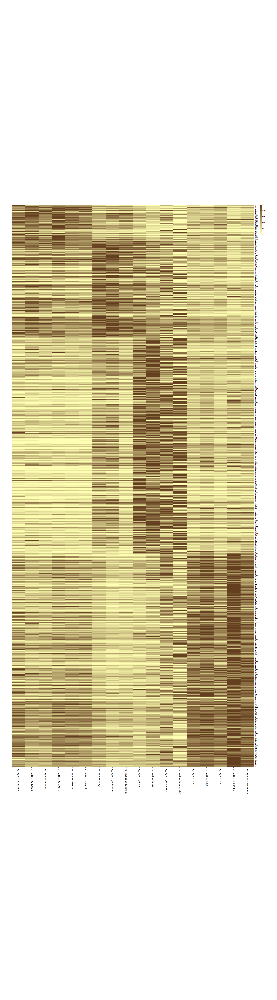

In [373]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [374]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [375]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [376]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [377]:
matrix <- tmp_sample_markers_RNA_mean

In [378]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

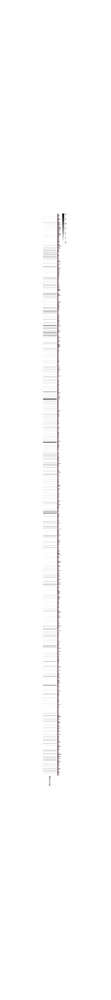

In [379]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, 
cluster_rows=FALSE)
ph

In [380]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [381]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [382]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

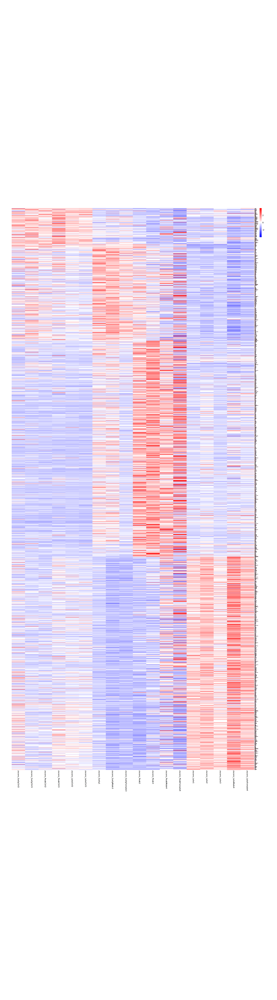

In [383]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [384]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [385]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [386]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [387]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [388]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [389]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

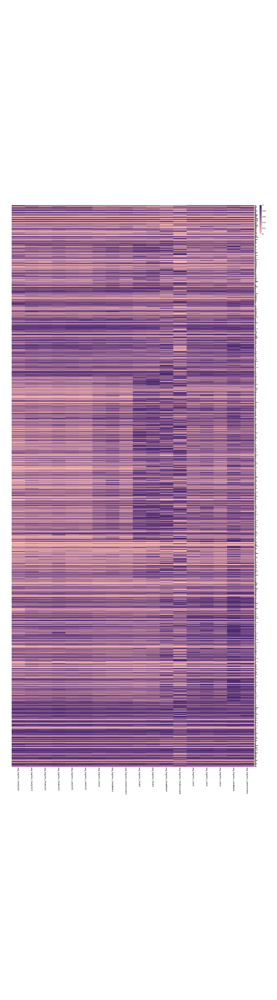

In [390]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [391]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [392]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [393]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [394]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [395]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [396]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

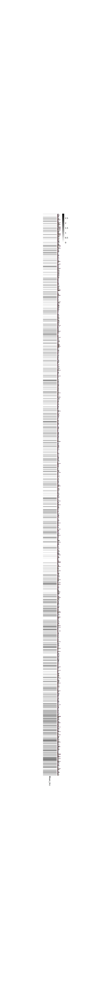

In [397]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [398]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [399]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [400]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [401]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [402]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

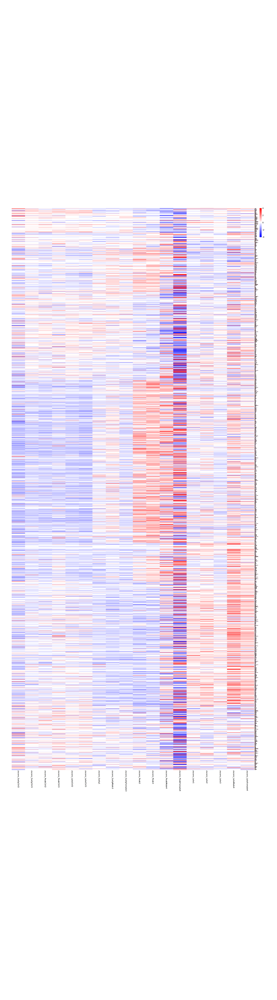

In [403]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [404]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [405]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [406]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [407]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [408]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [409]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

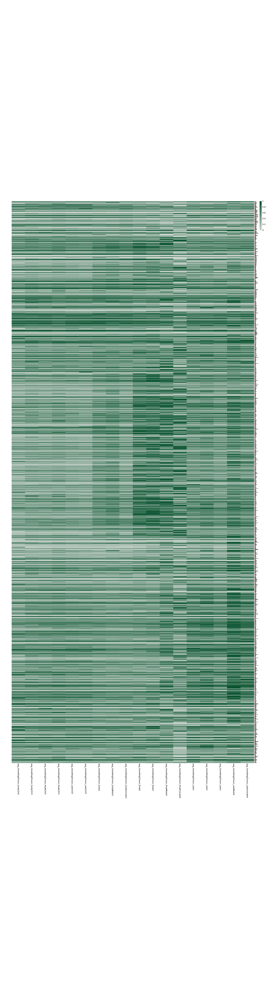

In [410]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [411]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [412]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [413]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [414]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [415]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [416]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

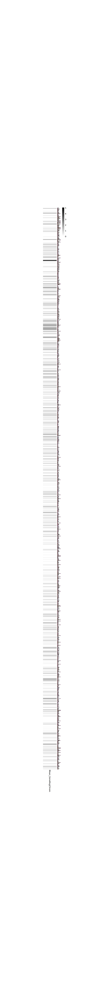

In [417]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [418]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [419]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [420]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [421]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [422]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

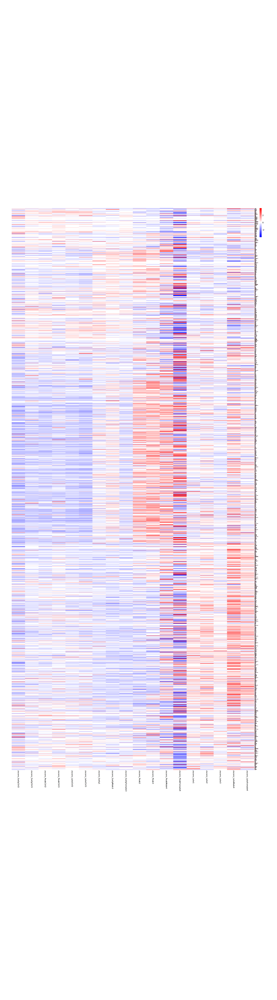

In [423]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [424]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [425]:
Idents(object = tmp) <- "orig.ident_merge"

In [426]:
sample_names <- levels(tmp$orig.ident_merge)

In [427]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [428]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [429]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [430]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [431]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [432]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [433]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [434]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [435]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [436]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [437]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [438]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [439]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [440]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [441]:
saveRDS(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".rds"))

In [442]:
write.csv(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".csv"), row.names=TRUE)

In [443]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [444]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [445]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

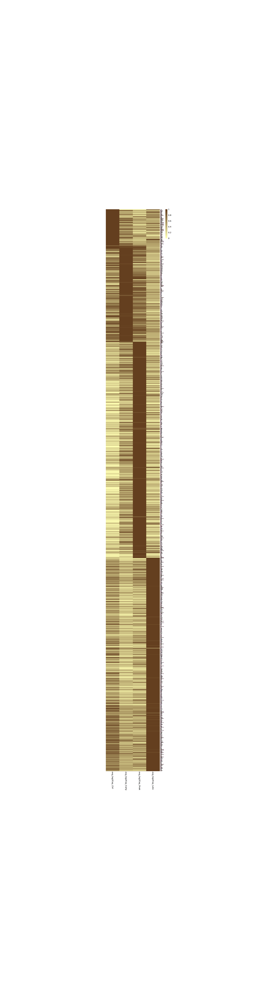

In [446]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [447]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [448]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [449]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [450]:
matrix <- tmp_sample_markers_RNA_mean

In [451]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

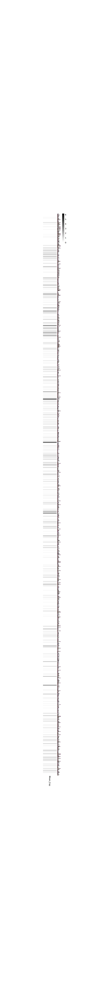

In [452]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [453]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [454]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [455]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

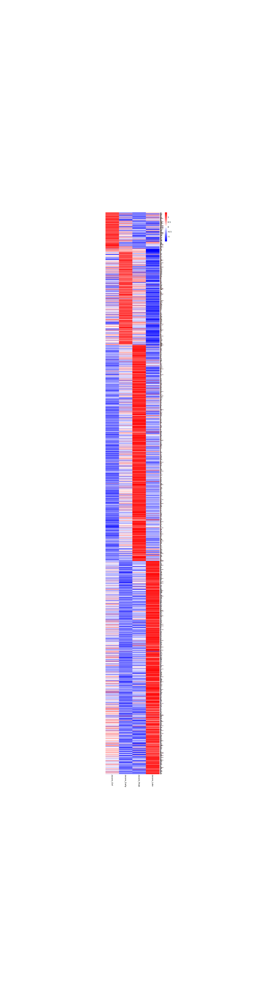

In [456]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [457]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [458]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [459]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [460]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [461]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [462]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

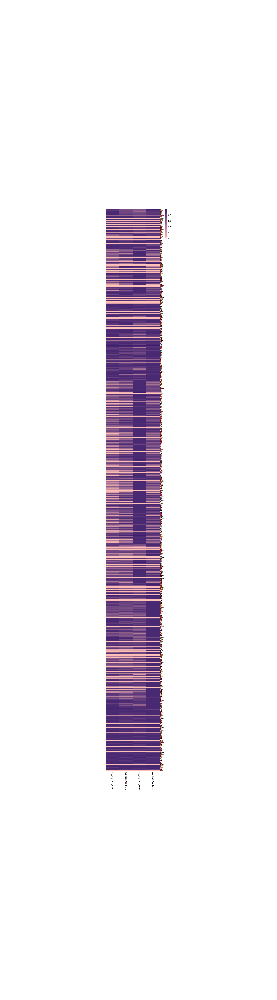

In [463]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [464]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [465]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [466]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [467]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [468]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [469]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

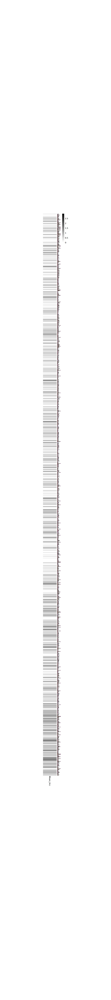

In [470]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [471]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [472]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [473]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [474]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [475]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

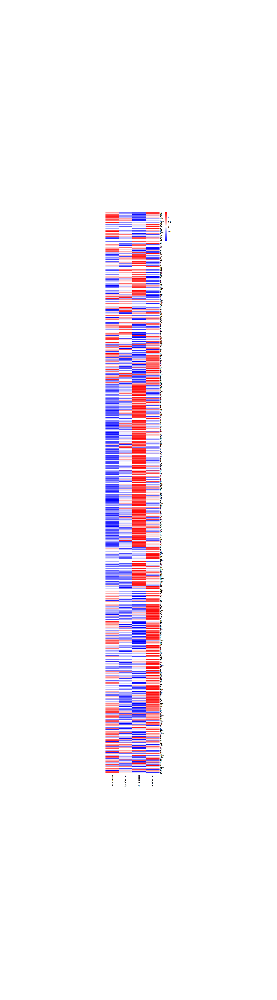

In [476]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [477]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [478]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [479]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [480]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [481]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [482]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

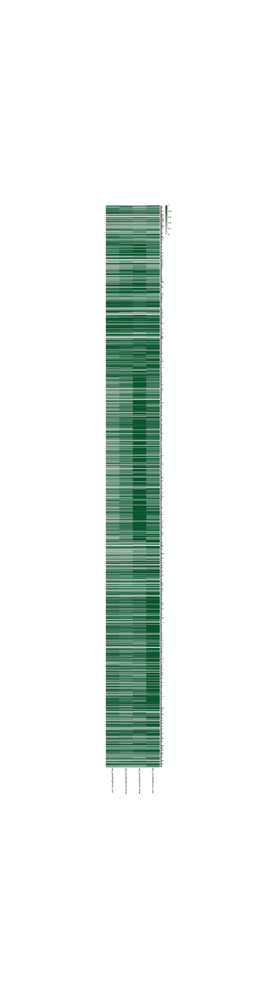

In [483]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [484]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [485]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [486]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [487]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [488]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [489]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

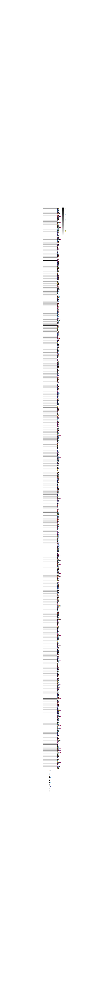

In [490]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [491]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [492]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [493]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [494]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [495]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

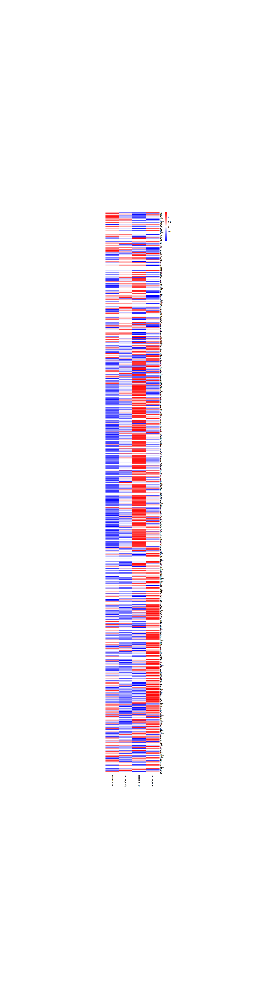

In [496]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [497]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

##### 3.1.1.2 Module dynamics

In [498]:
Idents(object = tmp) <- "orig.ident_merge"

In [499]:
sample_names <- levels(tmp$orig.ident_merge)

In [500]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [501]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [502]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [503]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [504]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [505]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [506]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [507]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [508]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [509]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [510]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [511]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [512]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [513]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [514]:
tmp_sample_markers_RNA_scaled <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [515]:
tmp_sample_markers_GenePromAcc_sub_scaled <- tmp_sample_markers_GenePromAcc_sub/do.call(pmax, tmp_sample_markers_GenePromAcc_sub)

In [516]:
tmp_sample_markers_GeneRegChrom_sub_scaled <- tmp_sample_markers_GeneRegChrom_sub/do.call(pmax, tmp_sample_markers_GeneRegChrom_sub)

###### 3.1.1.2.1 Category 1

In [517]:
gene_list <- c("Txnrd3","Clrn1","Gm20515","Gja1","Gm27153","Gprasp2","Maged2","B4galt4","Ngfr","Insyn2a","Cdh8","Nucb2","Gm48512","Deptor","Asphd1","4930426I24Rik","Gm34299","Ptprt","Limk1","Eps8l2","Wnt5b","Pabpc5","Adgrv1","4930419G24Rik","Gm26936","Slc7a15","Gm13905","4930565N06Rik","Gm47271","Gm17160","Rwdd3","Gm3764","Gm6994","Kctd4","1700085D07Rik","2410021H03Rik","Tmem81","Nid1","5830418P13Rik","9330175M20Rik","Gm12146","Qpct","C630043F03Rik","Mvd","Gm48342","Gm39129","Sh3bp4","Gm32122","Slc1a5","C1qtnf4","Armcx6","9630009A06Rik","Bcas3os1","1700063D05Rik","Fmnl3","C730002L08Rik","Gm26724","Paqr7","Gm28376","Gm48370","Gm29502","Enpp1","Per3")

In [518]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [519]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [520]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [521]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [522]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [523]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

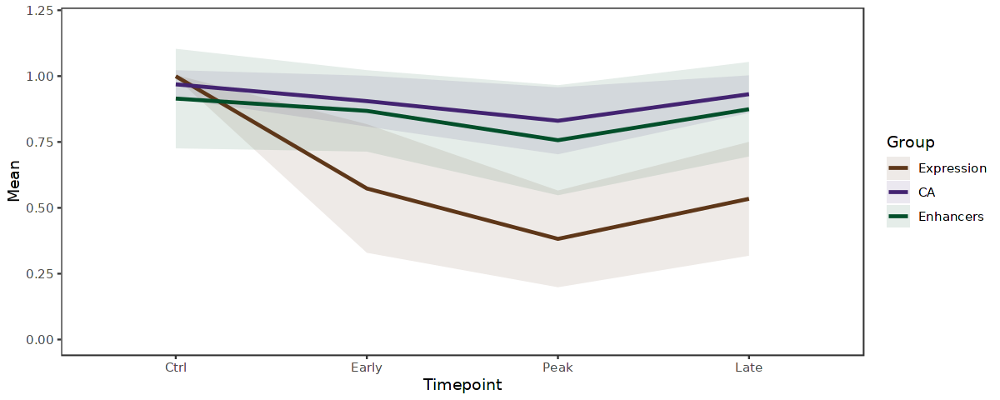

In [525]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.2 Category 2

In [526]:
gene_list <- c("Dhcr24","Hmgcs1","Hmgcr","Gm28501","Pla2g7","Msmo1","Fdft1","Sqle","Syn2","Bex2","Psat1","Etv1","Atp1a2","Gm10401","Aldh1l2","Oasl1","Sez6l2","Scd1","Lrtm1","Scg3","Fam183b","Hint1","Eid2","Ceacam1","Tlr3","Pcsk2","Nfkbia","Samhd1","Mov10","3110082J24Rik","Gm45890","Fndc5","Begain","Htr2b","Idi1","Arl4d","4930445B16Rik","Fam181b","Bbox1","Socs1","Kirrel2","Gm15813","Fbxo2","Pim3","Kctd13","Phtf1os","Ntsr2","2810457G06Rik","Gm28221","Etv6","Gabra2","Gm28379","Pdzk1","Gm15956","Mrgpra2b","Cp","Gm13572","Gm26672","Spry2","Gm15601","Gm19466","Maneal","Gm44777","Sgsm1","Gm37756","Serpinb9","Ndst4","Gm37165","Drd2","Mfsd4a","Ddx58","Gm29361","Hapln2","Cxcl10","Acsl6","Cab39l","Itgad","Ptger4","Galntl6","Scrg1","Nmi","Nap1l3","Gstm1","Chdh","Pcp4l1","Sppl2b","Slc14a1","Cavin2","Mrgpra1","Slc6a11","Errfi1","Anln","Gm26879","Pon2","Gm17638","Sema3e","Gm5820","Htra1","Rsad2","Gm10076","Mrgpra9","Rbl1","Mfsd2a","1700094J05Rik","1700022I11Rik","Gm15886","Cacng5","Kdr","Lpo","Irf1","Casp7","C1ql3","Pmvk","Gstm6","Slc38a2","Ccdc152","Herc6","4930414N06Rik","Hist2h2aa1","Srsf2","Spry1","Efemp1","Mgst2","Insig1","Agt","Nsdhl","Enc1","Lrrtm2","Rfng","Tubb2a","Ccl2","Jmjd8","Stk16","F3","1700094M23Rik","Gm26854","Hsd17b10","Tshb","Noc4l","AC156546.1","Lrrtm1","Gjb6","Slc35b1","Gm43464","Gm27252","Gpr37l1","Cplx2","Gm11772","Gm44866","Snhg1","Selenop","Dalrd3","Got1","Gm31305","Rpgrip1","Enho","Sparcl1","Arpc1a","Pmm1","Rpl8","Ywhab","Mlc1","Stard4","Fau","Pml","Ablim1","Sdf2l1","Tpd52l1","Gstk1","Sox9","Gm36043","Kcnk1","Rab5if","Ccr9","Defb47","Gm32036","Romo1","Gm44850","Cdk6","Cetn2","Gas5","Slc25a29","Slc39a12","Ramp1","Gm33255","Hey1","Gm17089","Slc24a5","Rack1","Gm32568","Brip1","Map7d2","Cdh24","Slc1a2","Col16a1","A930037H05Rik","Fth1","Pigh","AW047730","Nfkbib","Daglb","Lefty1","Rps25","Rps12","Oaz3","Mettl23","Ccne2","Cebpd","Higd1a","Fgfrl1","A230056P14Rik","Zfp771","Gm34408","Rpl37","Cdiptos","Dbi","Fam57a","Acat2","Mcl1","Manf","Lrp11","Rpl29","Rpl13","Bricd5","Sc5d","Krt10","2410004B18Rik","Lypla2","Mitd1","Kcnj16","Wfdc18","Acd","Slc7a10","Nubp2","Gm15559","Tril","Tmem255a","Gm42917","Bach2os","Lss","Slc25a5","Wdr54","Ttyh1","Ccdc24","Gm9895","St6galnac5","Gm15657","Gm14858","Cldn10")

In [527]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [528]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [529]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [530]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [531]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [532]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

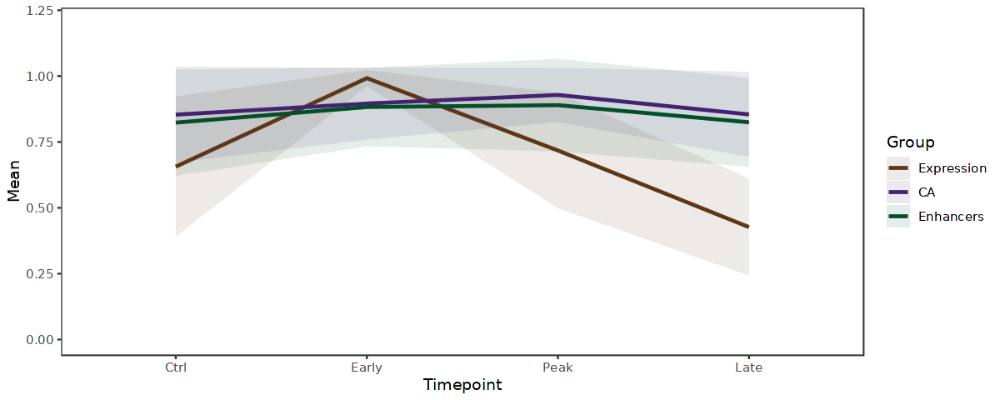

In [533]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.3 Category 3

In [534]:
gene_list <- c("C530005A16Rik","Slc25a22","Slc9a3r1","Gm46332","Gfap","Ticam1","Mt3","Avpi1","Gpd1","Txn1","Gm38642","Zbtb45","H2-DMa","Cdr2l","Nrxn3","Hist2h3c1","Parp3","Olfm2","Irgq","Ddah1","Psmb10","Mvk","Sdc4","Smpdl3a","Hap1","Tubb4b","Mdk","Efemp2","Gsta4","Tapbp","Cd74","Igfbp2","Fen1","Plac8","Ucp2","Oscp1","Timeless","Tmsb10","Lbh","Sptbn2","Gadd45g","Wfdc17","S100a6","Dpp7","Ssbp4","Aff2","Fyb","Hist2h3c2","Ier5l","Tcirg1","Kif9","Gpnmb","Gm20559","Vim","Kcnma1","Sec61g","Fn1","Tmem150a","Serpine2","Ncf2","Ppp1cc","Snhg3","1500009C09Rik","Cebpa","Ddit4","Kars","Ndrg2","Smim4","Atp8a2","Tubb2b","Ifi30","Hdhd3","Fabp7","Gmpr","Ebp","Crip2","Cenpj","1600014C10Rik","Ppif","Spag5","Tuba1a","Rgs1","Ficd","Pygm","Ctsc","Ier3","Cadps2","Rnd2","Arrdc2","Dtnb","Unc13a","Rbm3","Ccdc122","Casq1","Flot1","Adam15","Smox","Cercam","Ang","Ppp1r1b","Tnfaip8","Slc9a3","Sema4a","Samd9l","Pycard","Ptprr","Psmb8","Ppara","Abhd15","Pdk4","Apol9b","Gm6034","Plin3","Gdap1","H2-Q6","Gbp4","Fam43a","Pnpla2","B2m","Adam9","Phyhd1","9530082P21Rik","Maob","Nt5e","Cd300lf","Ddx60","Ncan","Clybl","Ptprn2","Fam171a1","Saa3","Zbp1","4930599N23Rik","Ifit2","Gm42067","Tmem132d","Neat1","Fxyd7","AY036118","Klk6","H2-Q7","Nr4a1","Gm4951","Zfp808","Sgk3","Ifitm3","Elavl2","Mroh3","Ifi27","Cd24a","Zc3h12a","Trim21","Bst2","Shfl","Foxp2","Gbp8","Slc7a11","Timp3","Olfr56","Arg1","Tgtp1","Stat2","Gbp6","Cd44","H2-Aa","Apln","Garnl3","Gm4841","9930111J21Rik2","Trim56","Them6","Pappa","Mlkl","Aldoc","Eef1akmt4","Hif3a","Lrrc8a","B3galnt1","Nap1l5","Snca","Gm13052","Capg","Tspan4","Hmgcll1","Snx10","Tap2","Pbxip1","Lcat","Gbp5","Me1","Idnk","Mgst1","Pla2g3","Pcnx2","Gbp9","Maml3","Jade2","Pdzrn4","Chst2","Pigo","Garem2","Ube2l6","B3galt5","Ly6c1","Fap","Gale","Ppl","Timp1","H1f0","Strip2","St3gal3","Akr1b10","Lynx1","Psmb9","Slc6a8","Rab3c","Ifi47","Junb","Ogfr","Timp4","Bcat1","Ifih1","Alk","Slc12a4","Slc16a2","Megf11","Gdap1l1","Syne2","Rassf4","Tapbpl","Nek6","Hspb1","Rnf217","Sbno2","Fam13a","Dmrta1","Crmp1","Gbp7","Gabrb3","Klc3","H2-T22","Ccl5","Mpeg1","Fxyd3","Slc4a2","Ehd3","Il20rb","F830016B08Rik","Gm16174","Trf","H2-D1","Tubb3","Fads2","H2-T24","Zfp7","Rasip1","Elmod1","Acsl5","Hist1h4h","Ankrd13a","Rgs20","Cebpb","Stambpl1","Chil1","Gbp3","Snx22","Lcn2","Gm12216","Pfkm","Tap1","Dtx3l","Irf9","Cybb","Cfb","Aacs","Fosl2","Mgp","Cldn14","Baalc","Gm12185","H2-K1","Ifi44","Znfx1","Uba7","Selenom","Nlrc5","Dner","Rnf125","H2-T23","Trim34a","Cxcl14","Phf21b","Rnpep","Parp12","Nde1","Rnf31","Arhgef26","Mmd","Hist1h2be","Hfe","Pon3","Sat1","Ogdhl","Apol9a","4930420G21Rik","Plin5","Dlgap1","Eif2ak2","Dbndd2","Maff","Galnt17","Itih5","B4galt6","Ptpn18","Xaf1","Asap2","Rtp4","Cd38","Oas2","Ada","Cdh22","Slfn9","S100a10","Ifit1bl2","Fam214a","Smpd3","Yap1","9330199G10Rik","Lgi4","Acsbg1","Nptxr","Gch1","Sgk1","Tnfrsf1a","Slfn8","Mt2","Serpina3g","Socs3","Ighm","Gm45716","Ifit1","Aox1","Ly6a","Tvp23a","Kcnc3","Slc39a14","Ifit3","Spp1","Fxyd5","Trafd1","Bcl2a1b","Psme2","Oasl2","Card10","Mrgpre","Sdc3","Lhfpl4","Itpr1","Mns1","Gm13919","Acot11","Gm6145","2610028E06Rik","Matn1","Ifi27l2a","Rab37","Ldlr","Ccrl2","H2-M3","Gm19684","Mrgpra6","Ndn","Serpina3n","Gm50237","Itgb7","Kcnb1","Vwa5a","Tgm2","C1ra","Lgals9","Parp9","AA467197","Erap1","Trim30d","Axl","Gm16175","Rnf213","Fcer1g","H2-Q4","Ric3","Sult1a1","AW112010","Parp10","Nod1","Gli2","Pacsin1","Far2","Bcl3","H2-Ab1","Rbm43","Lipe","9330175E14Rik","Alox5","Gpx1","Rhbdl1","Hist1h1c","Irgm1","Zfp872","Adar","Zfp365","Trim25","9530077C05Rik","Pabpc1l","Ly6e","Efcab1","Usp18","Zbtb7b","Cmtm7","Snap25","AI506816","Dock2","C1qc","Ifnar2","Cd274","Grik3","Parp11","Lyz2","Bcl6","Adipor2","Il18bp","Mt1","Dlg3","Klf9","Gm42743","Apod","Podxl","Tuba4a","Trim69","Serping1","Trim12a","Slc7a14","Abca8a","Il15ra","Fam124a","Vav2","Hist1h4i","Irf8","Psg16","Irf7","Abcb1b","Isg15","Cox7a1","Mapk8ip2","Cela1","Pros1","Tgfb3","Stat1","Oas1a","2210408F21Rik","Efr3b","Oas1c","Zfand4","Plvap","Ctsh","Dhx58","Fam107a","Ifi35","Iigp1","Irgm2","Stat3","Rnf19b","Ppm1e","C4b","Flnc","4933412E12Rik","Ciita","Chil3","Dnajc27","Lgals3bp","Shisa5","Il12rb1","Trib1","Klf15","Kcnip1","Tmem28","Pcsk2os1","Shc1","Cdkn1a","Ttc9b","Oas1g","C230035I16Rik","Tor3a","Ctnna2","Hmox1","Cmpk2","Ldlrap1","Plin4","Zfp488","Gda","Unc79","Sez6","Ifit3b","Stmn3","Gm43091","Gm11437","Gm16675","Paqr8","Abca7","1810044D09Rik","Msrb1","H2-Eb1","Cxcl9","Trim12c","Slc25a18","Tgtp2","Map3k8","Tspo","Igtp","Zfas1","Nudt7","Parp14","Zc3hav1","Enah","Matn2","Tmem140","Apeh","Dbx2","Lgals1","Mafb","Slc9a3r2","Apoc1","Gm44148","Tmem268","Slit3","Hddc2","Pou6f1","Faap20","Zbtb11os1","Etfbkmt","Gm19935","Tead3","1700113H08Rik","Klk9","Mtus2","Psme1","Rragd","Dclre1c","Gm45871","Gm45356","Rbp1","Lsp1","Cd68","Iqank1","Ccl6","Apoc2","Emp3","Carmil1","Lgals3","Abracl","A630001O12Rik")

In [535]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [536]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [537]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [538]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [539]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [540]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

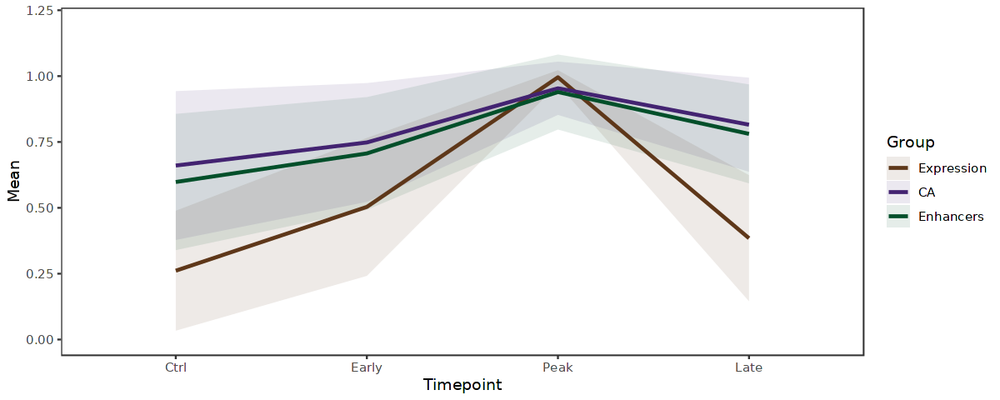

In [541]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.4 Category 4

In [542]:
gene_list <- c("2010315B03Rik","Cdk15","Slit2","Bmp5","Ptprg","Tnxb","Rdh9","Gpr158","Vmn2r57","Med12l","Alms1","4930488L21Rik","Ranbp17","Syt4","Sobp","Zfp52","Pde3a","Ccdc191","Reps2","Ano3","Dock7","Fmn2","5033421B08Rik","Cdc14b","Nalcn","Pde3b","Nhs","Dmrtc1a","Platr25","Gm44899","Klhdc8a","Txndc5","Mmp16","Upp2","Zfpm2","Gm28905","Gm19705","Lekr1","AI182371","Prkn","Ppp2r2b","Nova2","Slc2a13","Pde1a","Poc1b","5430403G16Rik","Scube3","Zfp964","Rnf150","Bmp1","Sel1l3","Dmd","Disc1","4931428F04Rik","Prkd1","Fggy","Slc39a11","A330015K06Rik","Ehbp1","Masp1","Sytl5","Amy1","Jpx","Map3k5","Gm5141","Stpg2","Irak1bp1","Dap","Nexmif","Ephx1","Dgka","Syde2","Spocd1","Gm816","Adgrb2","H2afy2","Gm29514","1700087I21Rik","Ddx4","Gm13889","Depdc1b","Gm47469","Gm31812","Adra1a","Tcf7l1","Lypd6","Cul7","Lhfpl3","Hpcal1","Arhgef19","Arhgef40","1700112D23Rik","Mcam","Sema4f","Gm43581","Fcnaos","Mpped2","Synpo","Gm41333","Pdk1","Pacs1","Unc13b","Adam11","Kank1","Phlda1","Gm5087","Asap3","Adgrl1","Gm31152","Gsta3","Tafa2","Vav3","Top1mt","Jam2","Tmem163","Casp3","Capn6","Osbpl10","Fam83f","Mcm8","Ust","St3gal6","Klhl32","Atcay","Cyp26b1","Padi2","Rab34","Igsf8","6030443J06Rik","Slc22a21","E230016M11Rik","Reep1","Mid2","Cnbd2","Dennd2c","Tmem178","Ntrk2","Ephb2","Zfr2","Gm16998","Tshz3","Pak3","A830019P07Rik","Gm43329","Htatip2","Lingo2","Smarca1","Islr","Rgs16","Arrdc1","Smad3","Renbp","Nrcam","Ttc9","Gm35733","Coro2b","Sox4","Bdkrb2","Gm40841","Nckap5l","Mybl1","Sdc1","Zfand1","Eda2r","2310002F09Rik","Pard6g","Zfp704","Plat","G630018N14Rik","Tns1","Zfp202","Dpp6","Spdya","Opalin","Cntfr","Zfp827","Jhy","Ptpro","5430402O13Rik","Bfsp2","Itk","Gulp1","Man1a","L2hgdh","Cdkn1c","Vamp5","Col6a1","Chsy3","Chadl","Kctd15","Optn","Ablim2","Gm4924","Elf4","Supt3","Adam18","Anxa7","Anxa2","Eno2","Kank2","Itpripl2","Rras2","Abca1","Fkbp9","Gap43","Uprt","3830408C21Rik","Anxa4","Parvb","Stard6","Tmtc4","Tmem141","Zfp810","Ahdc1","Pdzrn3","Myo1c","Gm10010","Kirrel3","Sox12","Traf3","Ralgps1","Msn","Bri3bp","4930593A02Rik","Jade3","Plxna4","Acads","Ltbp4","Trio","Inava","Smim3","D630045J12Rik","Sbk3","Nlgn2","Nnat","Glb1","Gm26881","Tenm3","Aebp1","Fignl2","Tmem176a","Ripor1","Jcad","Catspere2","Lamc1","Cpne8","Gm12976","Smurf1","Efs","Tgfbi","Gm28529","Dock6","Bfsp1","Gm43331","Nedd4l","Atp8b5","Tnfrsf1b","Vamp8","Auts2","Snx21","Shmt1","Adamtsl3","Aff3","Prickle3","Lctl","Shroom4","Socs2","Plxna1","Bbc3","Dnm1","Lpar1","1700012D14Rik","Rbm11","Ralgps2","Cd200","Rarb","Inppl1","Wwc2","Nol3","Faxc","6720489N17Rik","Astn2","Diaph3","Nebl","Klf12","Kcnj3","Rp1","Ddah2","Gm30085","Shcbp1l","Csmd2","Hoxc6","Rhbdl3","Slc35d2","Gm14280","Kcnd2","Grid2","Zdhhc18","Spsb2","Pde10a","4930471L23Rik","Akip1","Aard","Npr1","Zfp467","N4bp2l1","Sugct","Gm39526","Gm12092","Col27a1","Steap3","Cox6b2","Ptpn14","E430024P14Rik","Mblac2","Rgsl1","Primpol","Sh3rf3","Jph4","Apoe","Nckap5","AC163347.1","Foxp4","Grasp","Gm26543","Mgll","Lims2","Pde11a","Sacs","Rapsn","Serp2","Dgkz","Piezo2","A330102I10Rik","Usp11","Cacnb1","Cacna1c","Sox5","Igsf3","Rimklb","Slc30a1","Tmem176b","Tenm2","Tsc22d1","Btbd11","Plekha6","Col7a1","Gpr45","Cdkl3","Runx1","Noxo1","Synpr","Uap1l1","Cacnb3","Abca5","Hps1","Kctd8","Ltbp3","Dzip1","Col6a2","Gpsm1","Gm15912","Cmtm3","Trim47","Rxrg","Zdhhc15","Tram2","Ptprs","Vat1","A930017K11Rik","Naglu","Panx1","Macrod1","Prom1","Cdyl2","Rassf3","C77080","Nmnat3","Galk1","Nynrin","Serf1","Trerf1","Lrfn4","Vegfb","Tbc1d2","Plxna2","Bbs2","Vwa3b","Klf11","Dus4l","Nr1d2","Gm16124","Slk","Acad12","Adam12","Ttc28","Cage1","Shq1","Daam1","D730003I15Rik","A530072M11Rik","Rnase4","Zfp692","Ccdc171","Ccdc150","Nuak1","Podxl2","Tmod1","Gm38250","Grik5","Zc3h6","Cdyl","Adamts2","Dusp11","Gm14634","Crtac1","1700028E10Rik","Fam186a","Lhpp","Sgms2","Stau2","Fam228a","Pde7a","Zswim5","Plekhg2","Pfkfb4","Kcnq5","2810410L24Rik","Gpld1","Nav2","Zmat1","Epb41l4a","Gm15943","N4bp2","Mtcl1","Prtg","Dgat2","Ppfibp1","Rad51b","C230037L18Rik","Atrnl1","Ing2","Gpc1","Ccdc15","E2f3","Ccdc62","Ago4","2610316D01Rik","Fbn2","Dubr","Erlin1","Gm45159","Rexo5","Fam13c","Gm536","Bend3","Cep112","Psd2","Epha4","Gm15246","Rhoq","Prickle1","Grk5","Ccnd3","Gm26843","Cnksr2","5330413P13Rik","Teddm2","Brca2","Caprin2","Ttc3","Zfand5","Stn1","Gm49519","Hoxd9","Poln","Gm16759","Tmem8b","1700029J07Rik","Gm10687","Plppr3","Myof","Zfp341","Clhc1","Gm12743","Gm24362","Atp8b1","Pde4a","Clmn","Nectin2","Syne1","Jazf1","Ahi1","Cct6b","Zbed5","Fgd3","Mipol1","C030029H02Rik","9530051G07Rik","Myrip","Bend6","Tgfbr1","Carmil3","Gm43666","B230206H07Rik","Gpr137c","Lcorl","Trmt10a","Cux2","4933406C10Rik","Sema4d","Runx2","Fnip2","Fmn1","Agbl3","Plekha5","4930432B10Rik","Zfp300","Gm7467","Zmiz1os1","Crnde","Gm41492","Tpk1","Mgat5","Hspa12a","Lrriq3","Epb41l4b","Hebp1","Gm26901","Shd","Bmf","Sh3gl3","Mttp","Setd4","Ahrr","A230057D06Rik","Gm10863","Slc4a7","Gm17382","Trp53","Fhit","Psd3","Rab7b","Arhgap20","Pik3r3","Tmem106c","Gm4221","Zbtb4","Rad9b","T2","Myh10","Gm36849","Efcab5")

In [543]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [544]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [545]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [546]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [547]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [548]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

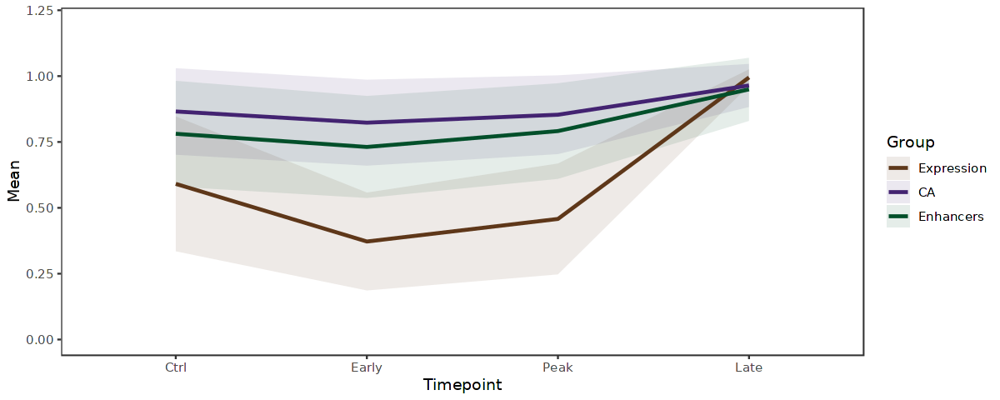

In [549]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.5 Sub category 1

In [550]:
gene_list <- c("Txnrd3","Clrn1","Gm20515","Gja1","Gm27153","Gprasp2","Maged2","B4galt4","Ngfr","Insyn2a","Cdh8","Nucb2","Gm48512","Deptor","Asphd1","4930426I24Rik","Gm34299","Ptprt","Limk1","Eps8l2","Wnt5b","Pabpc5","Adgrv1","4930419G24Rik","Gm26936","Slc7a15","Gm13905","4930565N06Rik","Gm47271","Gm17160","Rwdd3","Gm3764","Gm6994","Kctd4","1700085D07Rik","2410021H03Rik","Tmem81","Nid1","5830418P13Rik","9330175M20Rik","Gm12146","Qpct","C630043F03Rik","Mvd","Gm48342","Gm39129","Sh3bp4","Gm32122","Slc1a5","C1qtnf4","Armcx6","9630009A06Rik","Bcas3os1","1700063D05Rik","Fmnl3","C730002L08Rik","Gm26724","Paqr7","Gm28376","Gm48370","Gm29502","Enpp1","Per3")

In [551]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [552]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [553]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [554]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [555]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [556]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

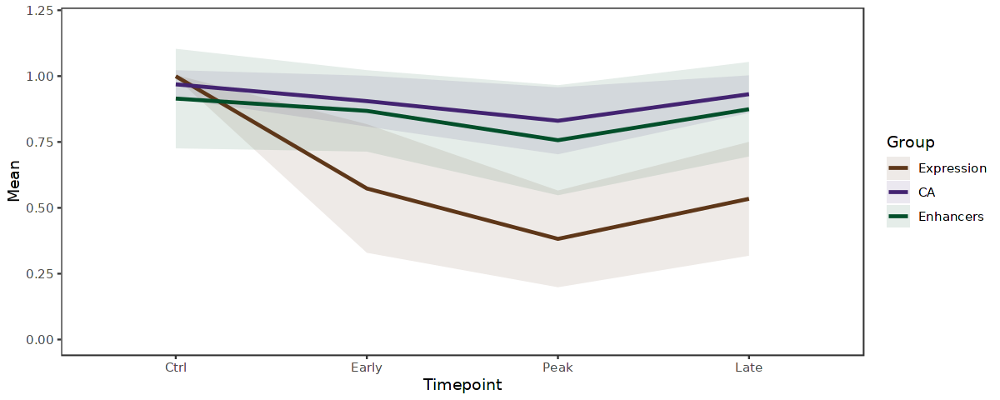

In [557]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.6 Sub category 2

In [558]:
gene_list <- c("Gm26743","Slc4a4","Gm13684","Mgat4c","Nell2","Ccdc153","Rmst","Gm44686","Hist1h1e","Dnm3os","Gm43376","Gm13708","Mia","Rnf152","Tenm4","Mfsd13b","Gm34590","Col9a1","Gm15398","9330111N05Rik","Gng8","5330438D12Rik","Eya2","Dse","Gabra3","Gm37459","4930512B01Rik","Lrrtm3","Nyap2","Nat8f1","Scg5")

In [559]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [560]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [561]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [562]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [563]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [564]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

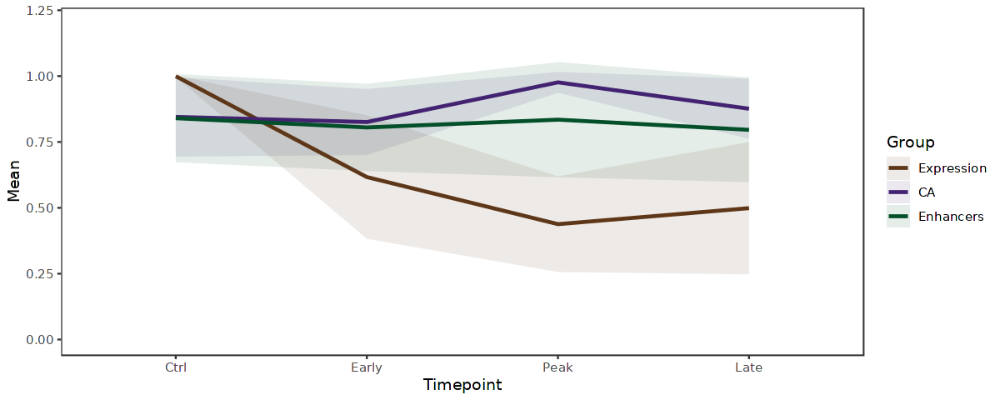

In [565]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.6 Sub category 3

In [566]:
gene_list <- c("Dhcr24","Hmgcs1","Hmgcr","Gm28501","Pla2g7","Msmo1","Fdft1","Sqle","Syn2","Bex2","Psat1","Etv1","Atp1a2","Gm10401","Aldh1l2","Oasl1","Sez6l2","Scd1","Lrtm1","Scg3","Fam183b","Hint1","Eid2","Ceacam1","Tlr3","Pcsk2","Nfkbia","Samhd1","Mov10","3110082J24Rik","Gm45890","Fndc5","Begain","Htr2b","Idi1","Arl4d","4930445B16Rik","Fam181b","Bbox1","Socs1","Kirrel2","Gm15813","Fbxo2","Pim3","Kctd13","Phtf1os","Ntsr2","2810457G06Rik","Gm28221","Etv6","Gabra2","Gm28379","Pdzk1","Gm15956","Mrgpra2b","Cp","Gm13572","Gm26672","Spry2","Gm15601","Gm19466","Maneal","Gm44777","Sgsm1","Gm37756","Serpinb9","Ndst4","Gm37165","Drd2","Mfsd4a","Ddx58","Gm29361","Hapln2","Cxcl10","Acsl6","Cab39l","Itgad","Ptger4","Galntl6","Scrg1","Nmi","Nap1l3","Gstm1","Chdh","Pcp4l1","Sppl2b","Slc14a1","Cavin2","Mrgpra1","Slc6a11","Errfi1","Anln","Gm26879","Pon2","Gm17638","Sema3e","Gm5820","Htra1","Rsad2","Gm10076","Mrgpra9","Rbl1","Mfsd2a","1700094J05Rik","1700022I11Rik","Gm15886","Cacng5","Kdr","Lpo","Irf1","Casp7","C1ql3","Pmvk","Gstm6","Slc38a2","Ccdc152","Herc6","4930414N06Rik","Hist2h2aa1","Srsf2","Spry1","Efemp1","Mgst2")

In [567]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [568]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [569]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [570]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [571]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [572]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

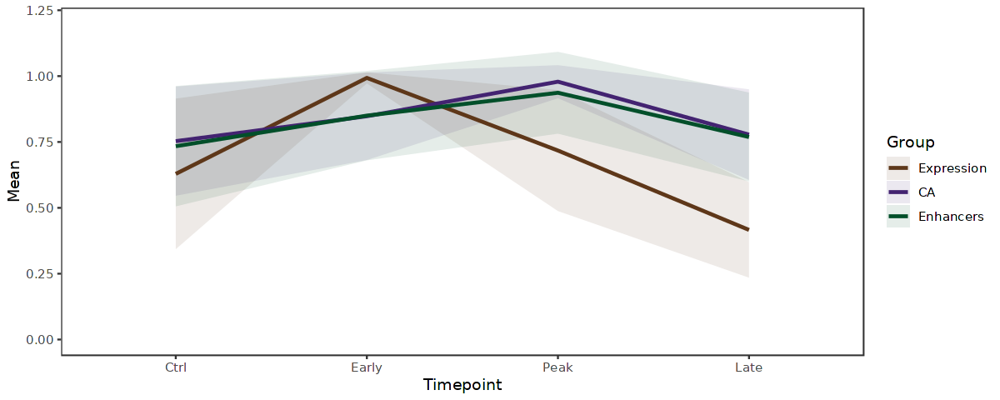

In [573]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.7 Sub category 4

In [574]:
gene_list <- c("Insig1","Agt","Nsdhl","Enc1","Lrrtm2","Rfng","Tubb2a","Ccl2","Jmjd8","Stk16","F3","1700094M23Rik","Gm26854","Hsd17b10","Tshb","Noc4l","AC156546.1","Lrrtm1","Gjb6","Slc35b1","Gm43464","Gm27252","Gpr37l1","Cplx2","Gm11772","Gm44866","Snhg1","Selenop","Dalrd3","Got1","Gm31305","Rpgrip1","Enho","Sparcl1","Arpc1a","Pmm1","Rpl8","Ywhab","Mlc1","Stard4","Fau","Pml","Ablim1","Sdf2l1","Tpd52l1","Gstk1","Sox9","Gm36043","Kcnk1","Rab5if","Ccr9","Defb47","Gm32036","Romo1","Gm44850","Cdk6","Cetn2","Gas5","Slc25a29","Slc39a12","Ramp1","Gm33255","Hey1","Gm17089","Slc24a5","Rack1","Gm32568","Brip1","Map7d2","Cdh24","Slc1a2","Col16a1","A930037H05Rik","Fth1","Pigh","AW047730","Nfkbib","Daglb","Lefty1","Rps25","Rps12","Oaz3","Mettl23","Ccne2","Cebpd","Higd1a","Fgfrl1","A230056P14Rik","Zfp771","Gm34408","Rpl37","Cdiptos","Dbi","Fam57a","Acat2","Mcl1","Manf","Lrp11","Rpl29","Rpl13","Bricd5","Sc5d","Krt10","2410004B18Rik","Lypla2","Mitd1","Kcnj16","Wfdc18","Acd","Slc7a10","Nubp2","Gm15559","Tril","Tmem255a","Gm42917","Bach2os","Lss","Slc25a5","Wdr54","Ttyh1","Ccdc24","Gm9895","St6galnac5","Gm15657","Gm14858","Cldn10")

In [575]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [576]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [577]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [578]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [579]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [580]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

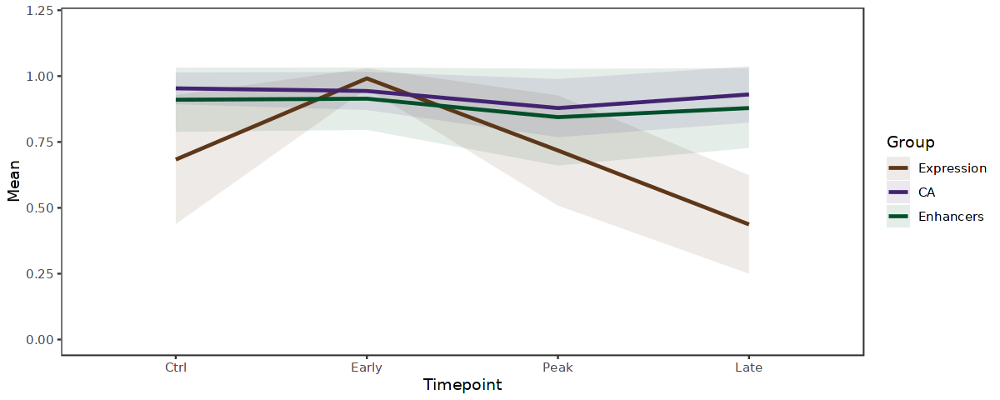

In [581]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.8 Sub category 5

In [582]:
gene_list <- c("C530005A16Rik","Slc25a22","Slc9a3r1","Gm46332","Gfap","Ticam1","Mt3","Avpi1","Gpd1","Txn1","Gm38642","Zbtb45","H2-DMa","Cdr2l","Nrxn3","Hist2h3c1","Parp3","Olfm2","Irgq","Ddah1","Psmb10","Mvk","Sdc4","Smpdl3a","Hap1","Tubb4b","Mdk","Efemp2","Gsta4","Tapbp","Cd74","Igfbp2","Fen1","Plac8","Ucp2","Oscp1","Timeless","Tmsb10","Lbh","Sptbn2","Gadd45g","Wfdc17","S100a6","Dpp7","Ssbp4","Aff2","Fyb","Hist2h3c2","Ier5l","Tcirg1","Kif9","Gpnmb","Gm20559","Vim","Kcnma1","Sec61g","Fn1","Tmem150a","Serpine2","Ncf2","Ppp1cc","Snhg3","1500009C09Rik","Cebpa","Ddit4","Kars","Ndrg2","Smim4","Atp8a2","Tubb2b","Ifi30","Hdhd3","Fabp7","Gmpr","Ebp","Crip2","Cenpj","1600014C10Rik","Ppif","Spag5","Tuba1a","Rgs1","Ficd","Pygm","Ctsc","Ier3","Cadps2","Rnd2","Arrdc2","Dtnb","Unc13a","Rbm3","Ccdc122","Casq1","Flot1","Adam15","Smox","Cercam","Ang","Ppp1r1b","Tnfaip8","Slc9a3","Sema4a")

In [583]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [584]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [585]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [586]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [587]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [588]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

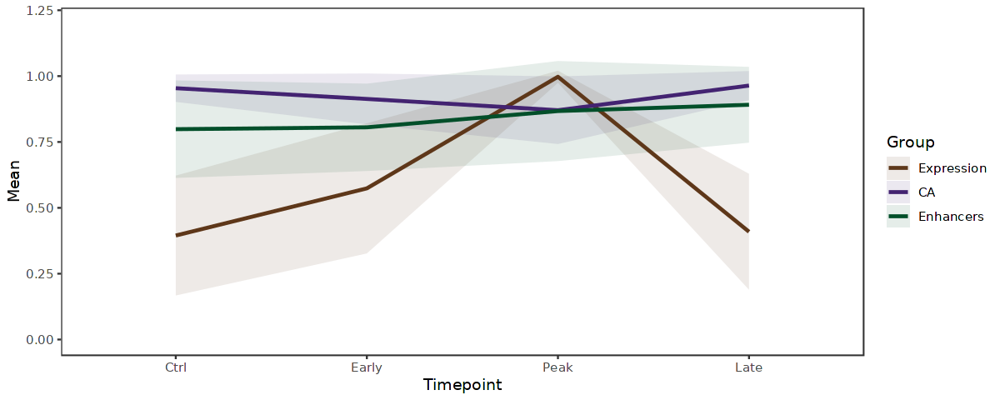

In [589]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.9 Sub category 6

In [590]:
gene_list <- c("Samd9l","Pycard","Ptprr","Psmb8","Ppara","Abhd15","Pdk4","Apol9b","Gm6034","Plin3","Gdap1","H2-Q6","Gbp4","Fam43a","Pnpla2","B2m","Adam9","Phyhd1","9530082P21Rik","Maob","Nt5e","Cd300lf","Ddx60","Ncan","Clybl","Ptprn2","Fam171a1","Saa3","Zbp1","4930599N23Rik","Ifit2","Gm42067","Tmem132d","Neat1","Fxyd7","AY036118","Klk6","H2-Q7","Nr4a1","Gm4951","Zfp808","Sgk3","Ifitm3","Elavl2","Mroh3","Ifi27","Cd24a","Zc3h12a","Trim21","Bst2","Shfl","Foxp2","Gbp8","Slc7a11","Timp3","Olfr56","Arg1","Tgtp1","Stat2","Gbp6","Cd44","H2-Aa","Apln","Garnl3","Gm4841","9930111J21Rik2","Trim56","Them6","Pappa","Mlkl","Aldoc","Eef1akmt4","Hif3a","Lrrc8a","B3galnt1","Nap1l5","Snca","Gm13052","Capg","Tspan4","Hmgcll1","Snx10","Tap2","Pbxip1","Lcat","Gbp5","Me1","Idnk","Mgst1","Pla2g3","Pcnx2","Gbp9","Maml3","Jade2","Pdzrn4","Chst2","Pigo","Garem2","Ube2l6","B3galt5","Ly6c1","Fap","Gale","Ppl","Timp1","H1f0","Strip2","St3gal3","Akr1b10","Lynx1","Psmb9","Slc6a8","Rab3c","Ifi47","Junb","Ogfr","Timp4","Bcat1","Ifih1","Alk","Slc12a4","Slc16a2","Megf11","Gdap1l1","Syne2","Rassf4","Tapbpl","Nek6","Hspb1","Rnf217","Sbno2","Fam13a","Dmrta1","Crmp1","Gbp7","Gabrb3","Klc3","H2-T22","Ccl5","Mpeg1","Fxyd3","Slc4a2","Ehd3","Il20rb","F830016B08Rik","Gm16174","Trf","H2-D1","Tubb3","Fads2","H2-T24","Zfp7","Rasip1","Elmod1","Acsl5","Hist1h4h","Ankrd13a","Rgs20","Cebpb","Stambpl1","Chil1","Gbp3","Snx22","Lcn2","Gm12216","Pfkm","Tap1","Dtx3l","Irf9","Cybb","Cfb","Aacs","Fosl2","Mgp","Cldn14","Baalc","Gm12185","H2-K1","Ifi44","Znfx1","Uba7","Selenom","Nlrc5","Dner","Rnf125","H2-T23","Trim34a","Cxcl14","Phf21b","Rnpep","Parp12","Nde1","Rnf31","Arhgef26","Mmd","Hist1h2be","Hfe","Pon3","Sat1","Ogdhl","Apol9a","4930420G21Rik","Plin5","Dlgap1","Eif2ak2","Dbndd2","Maff","Galnt17","Itih5","B4galt6","Ptpn18","Xaf1","Asap2","Rtp4","Cd38","Oas2","Ada","Cdh22","Slfn9","S100a10","Ifit1bl2","Fam214a","Smpd3","Yap1","9330199G10Rik","Lgi4","Acsbg1","Nptxr","Gch1","Sgk1","Tnfrsf1a","Slfn8","Mt2","Serpina3g","Socs3","Ighm","Gm45716","Ifit1","Aox1","Ly6a","Tvp23a","Kcnc3","Slc39a14","Ifit3","Spp1","Fxyd5","Trafd1","Bcl2a1b","Psme2","Oasl2","Card10","Mrgpre","Sdc3","Lhfpl4","Itpr1","Mns1","Gm13919","Acot11","Gm6145","2610028E06Rik","Matn1","Ifi27l2a","Rab37","Ldlr","Ccrl2","H2-M3","Gm19684","Mrgpra6","Ndn","Serpina3n","Gm50237","Itgb7","Kcnb1","Vwa5a","Tgm2","C1ra","Lgals9","Parp9","AA467197","Erap1","Trim30d","Axl","Gm16175","Rnf213","Fcer1g","H2-Q4","Ric3","Sult1a1","AW112010","Parp10","Nod1","Gli2","Pacsin1","Far2","Bcl3","H2-Ab1","Rbm43","Lipe","9330175E14Rik","Alox5","Gpx1","Rhbdl1","Hist1h1c","Irgm1","Zfp872","Adar","Zfp365","Trim25","9530077C05Rik","Pabpc1l","Ly6e","Efcab1","Usp18","Zbtb7b","Cmtm7","Snap25","AI506816","Dock2","C1qc","Ifnar2","Cd274","Grik3","Parp11","Lyz2","Bcl6","Adipor2","Il18bp","Mt1","Dlg3","Klf9","Gm42743","Apod","Podxl","Tuba4a","Trim69","Serping1","Trim12a","Slc7a14","Abca8a","Il15ra","Fam124a","Vav2","Hist1h4i","Irf8","Psg16","Irf7","Abcb1b","Isg15","Cox7a1","Mapk8ip2","Cela1","Pros1","Tgfb3","Stat1","Oas1a","2210408F21Rik","Efr3b","Oas1c","Zfand4","Plvap","Ctsh","Dhx58","Fam107a","Ifi35","Iigp1","Irgm2","Stat3","Rnf19b","Ppm1e","C4b","Flnc","4933412E12Rik","Ciita","Chil3","Dnajc27","Lgals3bp","Shisa5","Il12rb1","Trib1","Klf15","Kcnip1","Tmem28","Pcsk2os1","Shc1","Cdkn1a","Ttc9b","Oas1g","C230035I16Rik","Tor3a","Ctnna2","Hmox1","Cmpk2","Ldlrap1","Plin4","Zfp488","Gda","Unc79","Sez6","Ifit3b","Stmn3","Gm43091","Gm11437","Gm16675","Paqr8","Abca7","1810044D09Rik","Msrb1","H2-Eb1","Cxcl9","Trim12c","Slc25a18","Tgtp2","Map3k8","Tspo","Igtp","Zfas1","Nudt7","Parp14","Zc3hav1","Enah","Matn2","Tmem140")

In [591]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [592]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [593]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [594]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [595]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [596]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

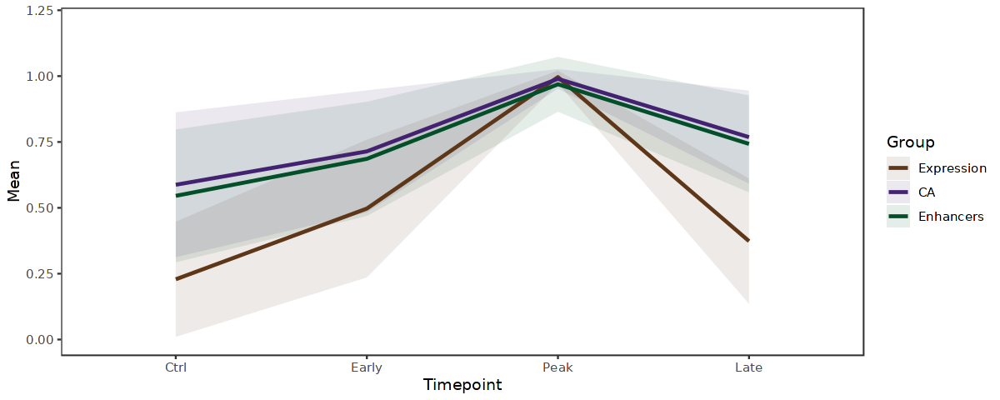

In [597]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.10 Sub category 7

In [598]:
gene_list <- c("Apeh","Dbx2","Lgals1","Mafb","Slc9a3r2","Apoc1","Gm44148","Tmem268","Slit3","Hddc2","Pou6f1","Faap20","Zbtb11os1","Etfbkmt","Gm19935","Tead3","1700113H08Rik","Klk9","Mtus2","Psme1","Rragd","Dclre1c","Gm45871","Gm45356","Rbp1","Lsp1","Cd68","Iqank1","Ccl6","Apoc2","Emp3","Carmil1","Lgals3","Abracl","A630001O12Rik")

In [599]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [600]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [601]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [602]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [603]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [604]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

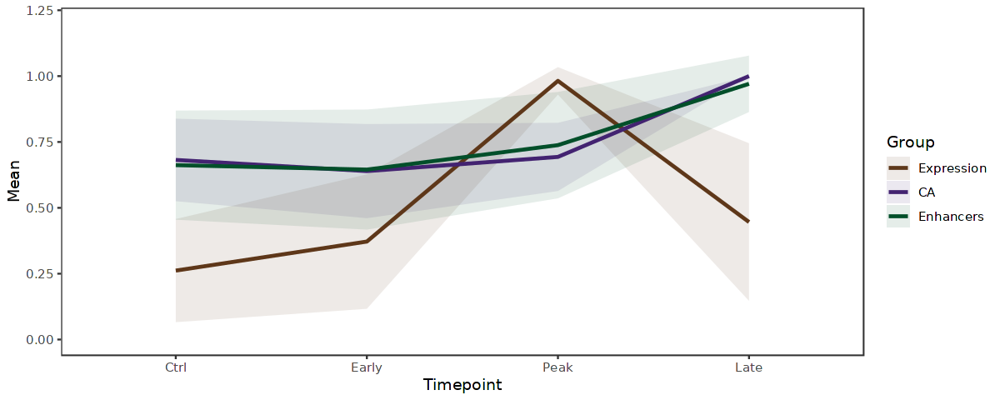

In [605]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.11 Sub category 8

In [606]:
gene_list <- c("2010315B03Rik","Cdk15","Slit2","Bmp5","Ptprg","Tnxb","Rdh9","Gpr158","Vmn2r57","Med12l","Alms1","4930488L21Rik","Ranbp17","Syt4","Sobp","Zfp52","Pde3a","Ccdc191","Reps2","Ano3","Dock7","Fmn2","5033421B08Rik","Cdc14b","Nalcn","Pde3b","Nhs","Dmrtc1a","Platr25","Gm44899","Klhdc8a","Txndc5","Mmp16","Upp2","Zfpm2","Gm28905","Gm19705","Lekr1","AI182371","Prkn","Ppp2r2b","Nova2","Slc2a13","Pde1a","Poc1b","5430403G16Rik","Scube3","Zfp964","Rnf150","Bmp1","Sel1l3","Dmd","Disc1","4931428F04Rik","Prkd1","Fggy","Slc39a11","A330015K06Rik","Ehbp1","Masp1","Sytl5","Amy1","Jpx","Map3k5","Gm5141")

In [607]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [608]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [609]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [610]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [611]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [612]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

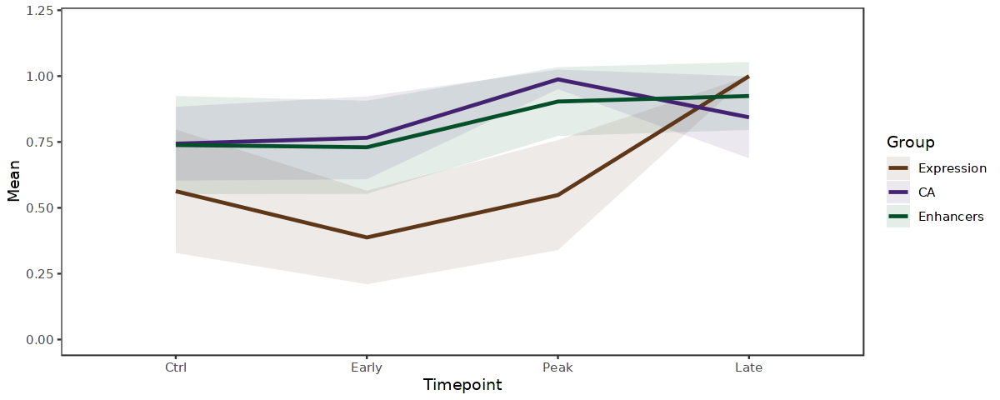

In [613]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.12 Sub category 9

In [614]:
gene_list <- c("Stpg2","Irak1bp1","Dap","Nexmif","Ephx1","Dgka","Syde2","Spocd1","Gm816","Adgrb2","H2afy2","Gm29514","1700087I21Rik","Ddx4","Gm13889","Depdc1b","Gm47469","Gm31812","Adra1a","Tcf7l1","Lypd6","Cul7","Lhfpl3","Hpcal1","Arhgef19","Arhgef40","1700112D23Rik","Mcam","Sema4f","Gm43581","Fcnaos","Mpped2","Synpo","Gm41333","Pdk1","Pacs1","Unc13b","Adam11","Kank1","Phlda1","Gm5087","Asap3","Adgrl1","Gm31152","Gsta3","Tafa2","Vav3","Top1mt","Jam2","Tmem163","Casp3","Capn6","Osbpl10","Fam83f","Mcm8","Ust","St3gal6","Klhl32","Atcay","Cyp26b1","Padi2","Rab34","Igsf8","6030443J06Rik","Slc22a21","E230016M11Rik","Reep1","Mid2","Cnbd2","Dennd2c","Tmem178","Ntrk2","Ephb2","Zfr2","Gm16998","Tshz3","Pak3","A830019P07Rik","Gm43329","Htatip2","Lingo2","Smarca1","Islr","Rgs16","Arrdc1","Smad3","Renbp","Nrcam","Ttc9","Gm35733","Coro2b","Sox4","Bdkrb2","Gm40841","Nckap5l","Mybl1","Sdc1","Zfand1","Eda2r","2310002F09Rik","Pard6g","Zfp704","Plat","G630018N14Rik","Tns1","Zfp202","Dpp6","Spdya","Opalin","Cntfr","Zfp827","Jhy","Ptpro","5430402O13Rik","Bfsp2","Itk","Gulp1","Man1a","L2hgdh","Cdkn1c","Vamp5","Col6a1","Chsy3","Chadl","Kctd15","Optn","Ablim2","Gm4924","Elf4","Supt3","Adam18","Anxa7","Anxa2","Eno2","Kank2","Itpripl2","Rras2","Abca1","Fkbp9","Gap43","Uprt","3830408C21Rik","Anxa4","Parvb","Stard6","Tmtc4","Tmem141","Zfp810","Ahdc1","Pdzrn3","Myo1c","Gm10010","Kirrel3","Sox12","Traf3","Ralgps1","Msn","Bri3bp","4930593A02Rik","Jade3","Plxna4","Acads","Ltbp4","Trio","Inava","Smim3","D630045J12Rik","Sbk3","Nlgn2","Nnat","Glb1","Gm26881","Tenm3","Aebp1","Fignl2","Tmem176a","Ripor1","Jcad","Catspere2","Lamc1","Cpne8","Gm12976","Smurf1","Efs","Tgfbi","Gm28529","Dock6","Bfsp1","Gm43331","Nedd4l","Atp8b5","Tnfrsf1b","Vamp8","Auts2","Snx21","Shmt1","Adamtsl3","Aff3","Prickle3","Lctl","Shroom4","Socs2","Plxna1","Bbc3","Dnm1","Lpar1","1700012D14Rik","Rbm11","Ralgps2","Cd200","Rarb","Inppl1","Wwc2","Nol3","Faxc","6720489N17Rik","Astn2","Diaph3","Nebl","Klf12","Kcnj3","Rp1","Ddah2","Gm30085","Shcbp1l","Csmd2","Hoxc6","Rhbdl3","Slc35d2","Gm14280","Kcnd2","Grid2","Zdhhc18","Spsb2","Pde10a","4930471L23Rik","Akip1","Aard","Npr1","Zfp467","N4bp2l1","Sugct","Gm39526","Gm12092","Col27a1","Steap3","Cox6b2","Ptpn14","E430024P14Rik","Mblac2","Rgsl1","Primpol","Sh3rf3","Jph4","Apoe","Nckap5","AC163347.1","Foxp4","Grasp","Gm26543","Mgll","Lims2","Pde11a","Sacs","Rapsn","Serp2","Dgkz","Piezo2","A330102I10Rik","Usp11","Cacnb1","Cacna1c","Sox5","Igsf3","Rimklb","Slc30a1","Tmem176b","Tenm2","Tsc22d1","Btbd11","Plekha6","Col7a1","Gpr45","Cdkl3","Runx1","Noxo1","Synpr","Uap1l1","Cacnb3","Abca5","Hps1","Kctd8","Ltbp3","Dzip1","Col6a2","Gpsm1","Gm15912","Cmtm3","Trim47","Rxrg","Zdhhc15","Tram2","Ptprs","Vat1","A930017K11Rik","Naglu","Panx1","Macrod1","Prom1","Cdyl2","Rassf3","C77080","Nmnat3","Galk1","Nynrin","Serf1","Trerf1","Lrfn4","Vegfb")

In [615]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [616]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [617]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [618]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [619]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [620]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

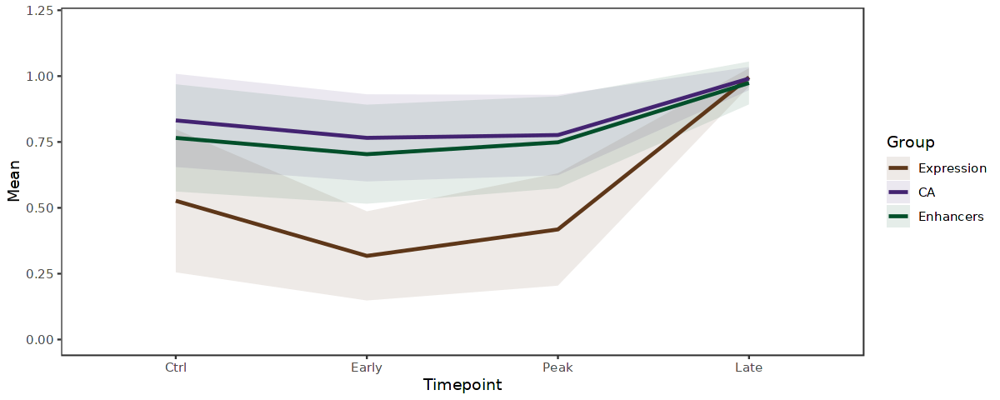

In [621]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.13 Sub category 10

In [622]:
gene_list <- c("Tbc1d2","Plxna2","Bbs2","Vwa3b","Klf11","Dus4l","Nr1d2","Gm16124","Slk","Acad12","Adam12","Ttc28","Cage1","Shq1","Daam1","D730003I15Rik","A530072M11Rik","Rnase4","Zfp692","Ccdc171","Ccdc150","Nuak1","Podxl2","Tmod1","Gm38250","Grik5","Zc3h6","Cdyl","Adamts2","Dusp11","Gm14634","Crtac1","1700028E10Rik","Fam186a","Lhpp","Sgms2","Stau2","Fam228a","Pde7a","Zswim5","Plekhg2","Pfkfb4","Kcnq5","2810410L24Rik","Gpld1","Nav2","Zmat1","Epb41l4a","Gm15943","N4bp2","Mtcl1","Prtg","Dgat2","Ppfibp1","Rad51b","C230037L18Rik","Atrnl1","Ing2","Gpc1","Ccdc15","E2f3","Ccdc62","Ago4","2610316D01Rik","Fbn2","Dubr","Erlin1","Gm45159","Rexo5","Fam13c","Gm536","Bend3","Cep112","Psd2","Epha4","Gm15246","Rhoq","Prickle1","Grk5","Ccnd3","Gm26843","Cnksr2","5330413P13Rik","Teddm2","Brca2","Caprin2","Ttc3","Zfand5","Stn1","Gm49519","Hoxd9","Poln","Gm16759","Tmem8b","1700029J07Rik","Gm10687","Plppr3","Myof","Zfp341","Clhc1","Gm12743","Gm24362","Atp8b1","Pde4a","Clmn","Nectin2","Syne1","Jazf1","Ahi1","Cct6b","Zbed5","Fgd3","Mipol1","C030029H02Rik","9530051G07Rik","Myrip","Bend6","Tgfbr1","Carmil3","Gm43666","B230206H07Rik","Gpr137c","Lcorl","Trmt10a","Cux2","4933406C10Rik","Sema4d","Runx2","Fnip2","Fmn1","Agbl3","Plekha5","4930432B10Rik","Zfp300","Gm7467","Zmiz1os1","Crnde","Gm41492","Tpk1","Mgat5","Hspa12a","Lrriq3","Epb41l4b","Hebp1","Gm26901","Shd","Bmf","Sh3gl3","Mttp","Setd4","Ahrr","A230057D06Rik","Gm10863","Slc4a7","Gm17382","Trp53","Fhit","Psd3","Rab7b","Arhgap20","Pik3r3","Tmem106c","Gm4221","Zbtb4","Rad9b","T2","Myh10","Gm36849","Efcab5")

In [623]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [624]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [625]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [626]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [627]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [628]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

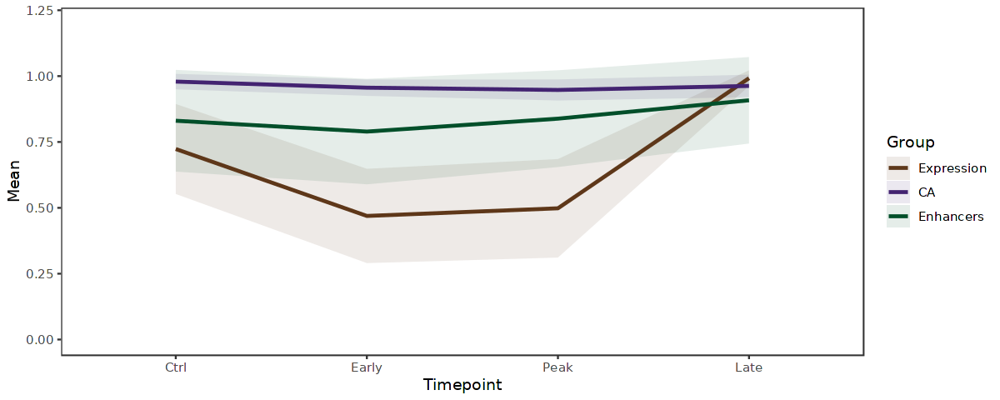

In [629]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

#### 3.1.2 MOL2

In [11]:
cluster_choice = "MOL2"

In [12]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [13]:
table_sample_low <- table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

EarlyCtrl3 
         4

In [14]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [15]:
table_group_low <-table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

named integer(0)

In [16]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [17]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [18]:
DefaultAssay(tmp) <- "GenePromAcc"

In [19]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [20]:
DefaultAssay(tmp) <- "RNA"

In [21]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [22]:
dynamics_genes <- c("Osbpl1a","Nnat","Ccdc15","Tyro3","Gm26747","Gm44866","Slc25a27","Crnde","Fosb","Abhd12","Ctsk","Pde5a","Pdk1","Ddah2","Tnfrsf21","Cd300e","Klf11","Hoxa7","Esrrg","Pdlim2","Btd","Anxa5","Deptor","Sort1","Lypd6","Fam117a","Micall2","Mylip","Gpsm1","Orc1","Cenpm","Fahd2a","Hist2h3c2","Slc34a3","Evi5l","4930419G24Rik","Ccdc82","Mfsd13b","Mlc1","Ramp1","Adamts20","Cnksr2","Arid3b","Thbs3","Scel","Gm50013","Gm15886","Tsc22d1","Rab11fip4os1","Cep72","Pmm1","Hs3st1","Ypel1","Enpp1","Gm45479","4932443L11Rik","Pbx3","Lims2","1700094J05Rik","Col9a1","Rccd1","Rwdd3","Ankub1","Jade1","Slc25a18","Tubb2a","B230323A14Rik","Ddb2","Sema4d","Sccpdh","Col9a2","Gm44992","Mpped2","Abca6","Tmeff1","Dlk2","Fsd1","Depdc1b","Epha4","Wls","Gm37459","Zcchc18","Pde4a","Itih3","Masp1","Hacl1","Nppc","Gramd4","Acer2","Rybp","Galnt6os","Gm36278","Ccdc148","A930017K11Rik","Zfp462","Cntfr","Slc7a15","Spock3","Acly","Anxa7","Tbc1d16","Tagln","Gm26759","Gm30613","Gls2","Acsbg1","Clgn","Srsf12","Coro2b","E530011L22Rik","Jph4","Ttll3","Fibin","Supt3","Kcnab1","Vegfb","5330438D12Rik","Sgk2","Lrrc31","Srrd","Slc25a23","Gria4","Lypd6b","Tmem169","Lrrc36","Gm48765","4930426I24Rik","Pdzrn3","Cdh8","Efemp2","9530051G07Rik","Nudt8","Hmmr","Golim4","Iffo1","Tspan7","Aph1b","Gm50232","Folh1","Nipa1","Prtg","Slc1a5","Cipc","Cobl","Adam18","Gm38948","Nek8","Pard6g","Pld2","H1fx","Rasgef1b","Gm37768","Grm3","Rbm11","Adamts2","Wdr17","Ldhb","4921504A21Rik","Slc25a53","Mroh3","Aif1l","Scg5","Mblac2","Nol4l","Slc22a17","Tmtc4","Npb","Anapc2","7630403G23Rik","Gm16000","Clrn1","Slc5a11","Gna12","Bphl","Zc3h8","Gm29361","Kctd16","Sowaha","Ccng2","Gm28379","Gm43376","Letm2","Armcx1","Pkd1l3","Esrra","Unc13b","Pls1","Sorcs3","Naalad2","Fdxr","Kif21b","Chdh","Klf10","Ly6g6f","Wfdc18","Mia","1700015F17Rik","Gm11457","Tub","Vangl1","Rmnd1","Stard4","Serp2","Apex1","H6pd","Shc4","Gm12758","Armcx2","Cacna2d4","Mfsd4a","Gm37756","Ankrd9","Dnajb2","Cox6a2","Gm26660","Plekhf2","Gm11149","Gm17036","Tmem81","Cd300lf","Cmtm7","Zfp839","Fam234a","Dipk1a","Chst8","Rgsl1","Cd55","Nipal3","3010001F23Rik","Ephb2","Stmn3","Gpr176","Tspyl4","Adam22","Adgrb3","Zfp395","Lingo2","Gm37494","Htr2b","Gm4876","Rdh9","Msrb3","5033421B08Rik","Mef2c","Gm16054","Art3","Adarb1","Irak2","Celf2","Ly6g6d","Nebl","4930405A10Rik","Zfhx2os","2210411M09Rik","Grhpr","Gm5441","Snap25","Mfge8","Plp2","Lrat","4930593A02Rik","Mgst3","Gm15764","Sema4a","Casp1","Mgll","Frem2","Gpr137b","Gm37229","Gm9934","Adarb2","4930513D17Rik","Bcas1os2","Gm20631","4933424G05Rik","Gm816","Rora","Syne1","Itpkb","Rnase4","Reln","Tuba1a","Uchl1","Akip1","Kif5a","1110019D14Rik","Filip1","Msi1","Nkx2-9","Rcor2","Frzb","Rapgef4","Serpind1","Gm5089","C030029H02Rik","Slc12a4","Atp13a4","Prdm1","Slc4a4","Gdpd1","A230001M10Rik","6720489N17Rik","Zkscan16","Gm31718","A330008L17Rik","1810010H24Rik","Usp29","C1qc","Spint2","Fcho1","Gm16168","Mfsd4b1","Gm48370","Retn","Sh2d3c","Atcay","Nme5","Pygb","Plekha7","Bace2","Gm15414","Dcdc2a","Kif26b","Fam20c","Gabra2","Kif7","A930024E05Rik","Gm34590","Pdk2","Gm41492","1110046J04Rik","Cd83","A930006I01Rik","Slc9a3r1","Mgat4c","Tnfrsf11a","Aass","Ccdc88c","Hist1h2be","Pacc1","Ntsr2","Tifa","Creg2","Zswim9","Fam181b","Tmem216","Pla2g7","Rida","C230037L18Rik","Luzp2","Fam3c","Rnaset2b","Ncs1","Gm36849","Gm17491","Cavin4","Cux2","Mmp15","Fry","Ndn","Gm35696","Ptpn18","Usp13","Cyp27a1","Col11a2","Ripk4","Cbs","Fam173a","Ranbp17","Ccdc85a","Gm15657","Shld3","Cntnap2","Prrg1","Gm47371","Gjb2","Crip1","Uevld","Mettl7a1","Abcb9","Kcnn3","Nid1","Vmn2r57","Mex3b","Acsf3","Inka1","Sept6","Maf","Nqo1","Vmn2r87","Trim36","Gm3764","Shroom1","2700046A07Rik","Adra1b","9330175M20Rik","Tenm2","Macrod1","Mtmr14","P2ry14","Chn1","Epha10","Suclg2","Kcnip3","Adam1a","Crybb1","Tubb2b","Fn3k","Ephb1","Gm16212","Gm43848","Hist1h1e","Slc9b2","Gm48740","Samd12","Hopx","Kcna2","Sspn","Hist1h4d","Gm48508","Gm28085","Evl","S100b","4930471L23Rik","Car5b","Gm48342","Wdr72","Hhip","Map2k6","Sirt5","9330117O12Rik","4930511M06Rik","Lurap1","Gm45338","Rdm1","Ppm1f","Plch2","Gm32036","1700087I21Rik","Ceacam1","Ccdc30","Aldh2","Gm13708","Myh7b","Gm11437","Slc45a3","9530034E10Rik","Serpinh1","4930469K13Rik","Atp2b2","Tex52","Gm15347","Dnaja4","Dynlt1a","Cryzl2","Gm48742","Shisa8","Ccdc24","Gm48371","Gm33948","Stmn1","Pdcd4","Car7","Ift140","2610206C17Rik","Izumo4","Oser1","Dbil5","Zkscan8","Ppcdc","Pcsk6","Shroom2","Appl2","Gpc5","2810468N07Rik","Pou2f2","Ttc39c","Hspg2","Gmnn","Isca1","Pacsin3","Rbks","Gm15672","Gnai1","Chst12","Wnt5b","Bcorl1","Nkd1","Nat8f1","Golt1b","Npc1","Snx32","Spg20","Afap1","1700066M21Rik","Mvd","B430010I23Rik","Coro7","Relb","Tmx4","Brca1","Hebp1","Cry2","Gpsm2","Gm10827","Pigp","Dgkz","Cep83os","Scamp5","Gjc2","Kctd4","Timp2","Gm10687","Dbp","Gng8","Ankrd44","Adcy9","Gm49012","Bloc1s5","Prxl2a","Itgb4","Lrrc1","Tmem14a","Cat","Maged2","Rfx2","Epn2","2310022B05Rik","Fgd3","Plekhh1","Nfe2l2","Ice2","Sox8","Bfsp2","Jazf1","Rasl11b","Itm2c","Tmem246","Trib3","Scrn1","Pik3c2b","Zc2hc1a","Pnrc1","Mycbp","Gm31152","Ypel2","Cmtm5","Enpp6","Depdc7","Tet1","Tmem143","Dscam","Gm26531","Polq","Mcam","Cdh11","Ilvbl","Gen1","Papss1","Qpct","Arsg","Slc25a42","Gca","Gas2","Efcab2","Stard5","Gm36608","Utp14b","Amdhd2","Commd10","Rdh12","Kiz","Gm15853","Siae","Fam228b","Fbxo17","Slc25a29","Chn2","Gm49519","Ang","Gm42413","1700029J07Rik","Mtus1","Gipc1","Tmem106c","Efcab5","Igsf8","Glod4","Naglu","Xrcc3","Spata24","Serpinb1a","Stau2","Dnajc6","Sel1l3","Rap1gap","Tmem163","Gm38560","Rab7b","Fads1","Gm50399","Tst","Mpv17l","Gm49042","Acy3","Plat","Hilpda","Kif6","Ctnnal1","Btbd8","Grk5","Cep70","Lpar1","Prkca","Pigz","Bahcc1","Cep112","Stk10","Mapre2","Gm12367","C630043F03Rik","Hsd17b7","Arhgef28","Pcx","Kif3a","E230016M11Rik","Gm26542","Lig1","Rims1","Trim13","Pacrg","Nr4a1","Tmem255a","Aspa","Smpdl3a","Slc35e1","Rfc5","Gnb4","Sh2b3","Agbl3","Kctd10","Tes","Gm26618","Lekr1","Ap2a1","Zfp503","Ppip5k2","Defb47","Ctsc","Timp1","Igfbp2","Bex2","Oaz3","Tnfsf9","Pgf","Pigo","Angptl1","Rpl24","Irak1","B3gat2","Stk16","Gtpbp4","Lbh","Rpl30","H2afx","Snrpe","Romo1","Mrpl4","Srsf2","Cycs","Txnl4a","Zfp692","Rrp8","Surf2","Dhcr7","Gm47283","Tenm3","Gm34868","Cct6a","Rpl7l1","Gm20319","Hist2h2aa1","Noa1","Ndufa12","Wdr75","Gadd45g","Cacybp","Rpl9","Rpl4","Dancr","Lsm8","Prpf31","Mrpl54","Acbd4","Serpine2","Kdelr2","C1qbp","Tsfm","2410004B18Rik","Timm23","Usp50","C1ql3","Rplp2","Wdr55","Ilf2","Rps20","Rpl29","Rpl41","Rnf126","Rcc2","Elof1","Lrrc59","5430416N02Rik","Lyar","Grpel1","Ptges3","Cdk11b","Rpl22","Ddx24","Nip7","Tbc1d10a","Epas1","Tmem258","Rbmxl1","Mitd1","Acat2","Nsun2","Cyp51","Pmvk","AI506816","Gas5","Phf5a","Rrp9","Prex1","Tmem97","Lsm12","Mak16","Fgfrl1","Kat2a","Polr3d","Clptm1l","Rps19bp1","Mphosph10","Eef1akmt4","Gm38335","Ipo5","Psme3","Alyref","Rps23","Grwd1","Lrrtm2","Pomp","Mdn1","Camk2n2","Shfl","4930599N23Rik","Kri1","Ctdnep1","Uqcrq","Rpl12","Gnl2","Elp5","Ydjc","BC003965","Rpf2","Tbcc","Rpl21","Gas2l1","Ftsj3","Lamtor1","Nhp2","Wdr4","Emc6","Usp19","Slc38a2","Sppl2b","Pgk1","Cdc42se1","Rpl17","Gm26533","Srsf9","Sertad1","Rangrf","Gps1","Taf1d","Ccl2","Baalc","Abracl","Ccnd2","Slc7a10","Gm26672","Slc24a5","Nphs1","Aqp4","Hspb1","Ttc9","Rab33a","Pus3","Grsf1","Eif2ak2","Msantd4","Ifitm3","Adamts1","Ppan","Polr1e","Nop58","Cthrc1","Gemin5","Tomm22","Tgfbi","Hgh1","Rpl8","Gpn2","G6pc3","Med7","Lyn","Mpp6","Nras","Rps25","Nop9","Rps26","Mrpl41","1810009A15Rik","Mrpl30","Rps28","Lmo2","Snhg3","Higd1a","Atad3a","Commd2","Ddx27","Gap43","Alg3","Trmt61a","Nkrf","Dynlt1f","Ebna1bp2","Tmed9","Uba52","Nle1","Idh3b","Noc2l","Bccip","Brix1","Rpgrip1","Gm17300","Agt","Bola3","Tsr1","Ccdc137","Sco2","Wdr74","Sigmar1","Abcg2","Gars","Gm10563","Rps27","2310058D17Rik","Inhbb","Pabpc4","Bak1","Maml2","Atic","Enkd1","Pfn1","Nars","Slc25a5","Eef1d","Lonrf1","Pum3","Ndufaf8","Tomm6","Rpl36al","Rpl31","Kbtbd11","B4galt5","Baz1a","Nup153","Rpl18a","Mettl23","Atp8a2","Gm3435","Gm16316","Gm32568","Gm47898","Gm37165","Unc13a","Ivns1abp","Cfap298","Snu13","Dcp2","Tex261","Sac3d1","Mettl1","Ddx39b","Rsl1d1","Rps2","Rce1","Timm50","Ptprn2","Gm16175","Gm17089","Tpt1","Ppie","Tbrg4","Telo2","Dus4l","Rps14","Ak6","Eif2b1","Rps27l","B9d2","Rps13","Nav2","Gm10701","mt-Nd1","Stk19","Cmtm6","Ddx21","Timp3","1110038F14Rik","Eif3b","Dbt","Leng9","Arhgef40","Nifk","Rpl32","Rps6","Exosc3","Ptges2","Kti12","Rsl24d1","Mrpl12","Strip2","Hs2st1","Ciao2b","Vcan","Sqle","Wdr46","Psme2","Pikfyve","Gm26519","Pdpn","Tcf7l2","Cdk14","Gm32856","Gpr137c","H3f3a","Arpc1a","Mrps22","Fads2","Nfkbia","Pcdh17","Id1","Casp7","Bhlhe40","Ccng1","Rtcb","Esf1","Samhd1","Tmem160","Slc7a1","Yrdc","Upf1","Actr1b","Med22","Rack1","Rpl7","Twistnb","Mcfd2","Rplp1","Polr2k","Ccdc134","Rrs1","Znhit3","Tmsb10","Gcsh","Ltv1","Mrps27","Btf3","0610009E02Rik","Strap","Rpl27a","2810004N23Rik","Dph3","Mrpl49","Arpc5l","Kars","Psmd12","Utp14a","Prelid3b","Clba1","AC160336.1","Trmt1","Nudc","Dalrd3","Smndc1","Eif3i","Chchd4","Prmt5","Rpl10","Eef1g","Elovl1","Dpm2","Polr1d","Rps15","Ddx39","Parp3","Cebpz","Daxx","Rnps1","Arid5a","Ralgds","Cebpd","Mrm1","Eml4","1600010M07Rik","Cgas","Nrxn1","Map3k20","Sharpin","Sox5os4","Adgrg2","Rpl27","Abcf2","Tmem208","Nfkbib","Brd3os","Gm36816","Gm10602","Rpsa","Mrpl52","Ripk2","Srrt","Snhg4","Mdh2","Exosc1","Rpl23","Rnf122","Cct3","Hspa5","Rpl23a","Bcs1l","Gm28221","Mrm3","Insyn2a","Cavin2","Rps16","Rps5","1700126G02Rik","Gm16068","Car10","Gm42047","Nudcd2","Ubqln4","2410006H16Rik","Synpr","Btbd16","Pde3b","Csrnp1","Ecm1","Cntn1","Chl1","Stx1b","Tnfrsf12a","Rgs17","Atf3","Spout1","ccdc198","Fosl1","Il33","Dph5","Tfdp1","Neb","C1ql2","Gsap","Gpr151","Scg3","Fgl2","Ido2","Cdkn1a","Tagln2","1110038B12Rik","Sema3e","Gfra1","Rgcc","Cers6","Igf2bp3","Pcnx","Tmod2","Cebpa","Kctd11","Gm19744","Kdm6b","Gm19935","Tepsin","Emp3","Amotl1","Gm14798","Gm10791","Etv6","Pgs1","Hmga1","Arhgap24","Midn","Rps6ka3","Steap3","Dtna","Ucn2","Casp4","Slfn9","Isg15","Dnttip1","Fchsd2","Sphk1","Cpne8","Mvp","Cacng5","Rnf125","Becn1","Clec2d","Cntd1","Sv2c","Ophn1","Lrtm2","Upp1","Gm3448","Kcnk2","Igf2bp2","Helz2","Slc9a3r2","Asb13","Lysmd2","Psme1","Nab2","Gm16223","Rpl9-ps6","Kcnk10","Folr2","Ldha","Brinp1","Kit","4933406I18Rik","Ric3","Gm20470","Snhg16","Ptpn5","Axl","Rnf213","Ermard","Rgs20","Tubb6","Nrcam","Osmr","Sec61g","Pkig","Cldn11","Gm28370","Crybg1","Gm48708","Dclk2","Maff","Gpatch4","Surf6","Pros1","Slc35f5","Fga","Syne2","Cyp2j9","Sdf2l1","Mafk","Add3","Rdh5","Heatr1","Nradd","Akr1b8","Gdf11","Rchy1","Pop5","Cd200","Pdrg1","Rassf4","Selenow","Dusp7","Znfx1","Fdft1","Setd6","I730030J21Rik","Gm16069","Gm15518","C1qtnf1","Baiap2","Tuba1b","Mat2a","Arpc1b","Nr2c2ap","Bcl3","Nubp1","Arrdc4","Fdps","Nap1l1","Laptm4a","Rab34","Mapk14","Rmdn3","Gadd45b","Pou6f1","Cic","Egr2","Sorcs2","Zrsr2","Tcerg1","Odc1","Ogfr","Zfp36","Rps10","Atp5e","Cd63","Qrsl1","2700038G22Rik","Znrd1","Snhg6","Socs3","Dkc1","Prorsd1","Srxn1","Rrp1b","Bzw2","Sdad1","Mt1","C230035I16Rik","9530082P21Rik","Gpx1","Tubb3","Akap12","Idnk","Soga3","Pdxk","Ascc3","Rnf217","Atp6v1h","Chic2","Bmp1","Cd151","Gm12530","Snhg17","Fbxo27","Socs2","Lypla2","Trmt61b","Rps15a","Ebp","Lyve1","Nudt9","Rbm3","Pi4k2a","Rps12","Ube2v1","Clic4","Psmb10","Rpl13","Pfdn4","Fam216a","Ccnd1","Lsm2","Nampt","Pin4","Kpnb1","C78859","Wsb2","Acd","Rexo2","Manf","Ngdn","Polr2h","Eif5a","Pdcd5","Timm8a1","Creld2","Eif1a","Plod3","Iffo2","Ranbp1","Cdk4","Mbd3","Ptbp1","Gm42917","Gm15601","Gm17494","Ran","Idh3a","Nme2","Nubp2","Btg2","Calr","Ctu2","Trmt6","Prmt1","Lsm4","Txn2","Tomm40l","Rps8","Tma16","Nolc1","Jcad","Map2k3os","Rab26os","Rnf225","Cltb","Cstb","Psmd3","Lmna","Nod1","Grik3","Crem","Metrnl","Tapbp","Myd88","Aasdhppt","Pcbp3","Peak1","4921516A02Rik","Rps29","Wdr43","Nop2","Map2k1","Gpd1","Tmem243","Ndufv2","Phlda3","Gm26788","Syncrip","Il4ra","Ak2","Mob3c","Etv1","Unc79","Tspo","Polr2f","Kcnmb4","Adar","Nsdhl","Ncoa2","Cdh24","Gm26797","Gm4117","Slc45a4","Anks1b","Grik2","9530059O14Rik","Irf2","Pou3f1","Clcf1","Larp1","Rpl5","Rps17","Anp32b","Slc25a22","N4bp1","Ccne2","Stat2","Endod1","Npm3","Hnrnpd","Tomm40","Ssr4","Cad","Spryd4","Rpl10a","Zfp428","Abhd11","Lsm7","Banf1","Rpl37","Rab5if","Fdx2","Utp11","Rab11fip5","Sat1","Pdap1","Tmem147","Tmem88b","Frmd4a","Tent4a","Tars","Brd2","Ada","Zfp207","Nop16","Relt","Yae1d1","Fubp1","1700123O20Rik","Rps3","Wdr89","Tsc22d4","Pcyox1l","Yars","March5","Pqlc1","Sox2","Btg3","Atf4","Lmo4","H3f3b","Pwp2","Gm44777","Eef1akmt1","Insig1","Pcgf5","Tsr3","Zfp593","Fkbp1a","Hnrnpa1","Sc5d","Eif5b","Rpl6","Timm10","Rasip1","Sbno2","Bend6","Egr1","Naa25","Trf","Pcyt2","Xaf1","Msmo1","Cdk6","Syvn1","Pvr","Scfd2","Rtkn","Atp5md","Nrap","Id3","Hspe1","Hspd1","Arf4","Emd","Atp5g1","Chpf","Plscr3","Lmnb2","Cdkn2d","Mrps18b","Taf1c","Ncl","Rhoj","Cfl2","Acod1","Mcub","Gm36043","Rps19","Pithd1","Hmgn1","Zmym1","Arfip2","Taf10","Prr11","Fam136a","Nlgn2","Myc","Lss","Gmppb","Serbp1","Zdhhc13","Zfp281","Selenom","A630089N07Rik","Fndc4","Tnc","8030451A03Rik","Ltbr","Cgref1","Arhgef12","Ldlr","Ier2","Nup210l","Rnf135","Manbal","Il1rap","Gfap","Nfkbiz","Cadps","Antxr1","Cab39l","Ptprj","Gm12940","Vars","Btc","Pvt1","Inpp4a","Slc39a1","Rps27a","Gale","Arap2","Slc7a14","Trib1","Pa2g4","Phb","Ears2","Col16a1","Sec61a1","Trmt112","Impdh2","Ttyh1","Hsph1","Tnni1","Erh","Srsf10","Nop56","Pus7l","Gnb2","Gtpbp6","Rps18","Wars","Ybx1","Rpl18","Cd3eap","Rpl38","Txndc11","Rnf139","Map2k3","Ostc","Ctps","Ccdc124","Arf6","Hnrnpab","Zpr1","Snrpa1","Gm15559","Zfas1","Epb41l4aos","Cybc1","Mrps5","Rplp0","Snhg1","Trmt10c","Nob1","Rrp7a","Rpl22l1","Sub1","Rpl34","Usp36","Eef1e1","N6amt1","Pfdn2","Pusl1","Rpl36","Jagn1","Fau","Noc4l","Pak1ip1","Rpl7a","Pes1","Emg1","Nme1","Mecr","Phb2","Wdr38","Pim1","Ubash3b","Irf2bpl","Pigf","Ctu1","Pim3","Eif2s1","Cggbp1","Ndufaf4","Gjb1","Sf3b4","Gnl3","Ywhab","Timeless","Idi1","Gm38251","Gm43118","Dph2","Ppid","Ddx49","Srsf6","Sra1","Rps3a1","Mcl1","Dis3","Tomm7","Phykpl","Fbl","Rwdd1","Isg20l2","Rangap1","Btg1","Eef1b2","Abce1","E2f4","Jun","Slc25a3","Taf7","Rev1","Wdr77","Gar1","Rabggtb","Rpl19","Upf3a","Nt5c3b","Noct","A930037H05Rik","Ufm1","Dus3l","Bms1","Slc3a2","Brip1","Rpl28","Ppp1cc","Gemin6","Exosc2","Ddost","Eif2s2","Pml","Cyp20a1","Rps7","Rpl35a","Snrpf","Hist1h4h","Chmp4b","Hint1","Mars","Rpl11","Nat14","Pdss1","Cdc14a","Nfyb","Utp20","Nop14","Hap1","Atp1b2","AC156546.1","Gm16982","Map3k1","Ptpn1","Dhcr24","Rpl37a","Acsl3","Scd1","Ap1s1","Selenos","Ppm1e","Rps4x","Rab21","Rps9","3110082I17Rik","Slc31a2","Fhod3","Naca","Snhg5","Naa50","Eef1a1","Ninj1","Hnrnpf","Srpr","Ruvbl2","Ddx54","Mybbp1a","Hnrnpa2b1","Timmdc1","Srp9","Dbi","Azi2","Il6st","Ahctf1","Slc35a4","Slc35b1","Lpo","Pabpc1","Tox2","Sfxn2","Cdv3","1110008P14Rik","Eif4a1","2410002F23Rik","Batf2","Dtymk","Set","Cluh","Gm17108","Ormdl2","Aen","Rps11","Srm","Dad1","Mrto4","Snrpd3","Ntmt1","Taf5l","Dohh","Rps21","Bola2","Slc1a4","Taf4b","Dnph1","Atad1","Src","Txnrd1","Jmjd6","Xbp1","Hmgcr","Pdcd11","Hmgcs1","Notch1","Rpl15","Dnajb5","Snhg8","Eef2kmt","Arid5b","Rbl1","Rnf19b","Srrm3","Carmil1","4933412E12Rik","Psmb5","Ppil1","Ube2cbp","Thg1l","Med8","Mchr1","1810055G02Rik","Mrps23","Psmg4","Rps24","Prmt7","Polr1c","Cct2","Polr3h","Bop1","Cdk2ap1","Ifrd1","Ccdc73","Ppa1","Srsf7","Agpat5","Nol12","Wsb1","Ccdc115","Noc3l","Ythdf2","Imp4","Psmc4","Timm9","Ndst1","Mfsd12","Lsm6","Dda1","G3bp1","Atp5g2","Ccdc86","Snrpg","Llph","Dus1l","Ddx51","Prelid1","Rpl14","Mier2","Ssr2","Pus1","Med10","Ctxn1","Fmn2","AA467197","Ccdc25","Lnx1","Spry1","Cox7b","Spry2","Galntl6","Polr1a","Hddc2","Tmem42","Klhl29","Mfsd10","Ddx18","Daglb","Tent5a","Gm47167","4930452G13Rik","Slc39a10","Gm20721","Mov10","Ddx58","1700001K23Rik","Fcf1","Angptl4","Wdr83os","Nudt19","Polr2l","Tasor2","Nmi","Gsta4","Ubxn8","Sox5","Gm41505","Adsl","Ybx3","Dnajc2","Fastkd1","Rrp15","Npff","Hypk","Dimt1","Ifrd2","Tex30","Eif1ad","Mob4","Eif3j1","Ipo4","Mrpl15","Psma7","Flot1","Mrpl20","Rrp12","Snrpd1","Eif6","Eif3k","Rab5c","Fosl2","Cox5a","Rpl39","Krtcap2","Il17ra","Mrps26","Rars","Snx10","Pno1","4930453N24Rik","Bud23","4930579G18Rik","Gm49066","Bax","Mrpl32","Cbarp","Cep126","Rpl36a","Snhg12","Smyd5","Dnajb11","Ggct","Cct8","Rpl26","Utp4","Mrfap1","Zfp511","Znhit6","Psma4","Slc38a1","Bysl","Npm1","Tmem251","Rpl13a","Spink10","Olfr1369-ps1","Isg20","Irf8","Rtp4","Ifit3","Mrgpra1","Ccl8","Phf11d","Gbp2","Rpl10-ps3","Serpina3f","Gjb6","Trim30d","Timp4","Ms4a4b","Rps27rt","Ifit1","Gm10076","Oas2","Usp18","Ifi35","Pdlim4","Pdzk1","Ccrl2","Asns","Aprt","Ppp5c","Ier5l","Gm26944","Irf1","Nlrc5","Pnpt1","Tut1","Zfp952","Osbpl10","Klhl32","Gm14164","Vgf","Tspan4","Arhgap28","Socs1","Ano3","Gbp3","Fam111a","Mlkl","Pde3a","Cd274","Apobec3","Irf7","Eif3j2","Zc3hav1","Eid2","Bst2","Stk32a","Serpine1","Papss2","Sdc3","Slc10a6","Acsl5","Slc6a20b","Igtp","Cmpk2","Psmb8","Trim21","Gbp5","Pik3r5","Herc6","Neto2","Gabbr2","Tor3a","Dtx3l","Irf9","Syt6","Il15ra","Trim25","Gm15283","Tnfrsf1a","Il12a","Ube2l6","Trim56","Mt2","C1ra","Parp14","Nsun5","Gm11361","Snhg15","Erg28","Znrd2","9030025P20Rik","Hmgn3","Gstm6","Parp9","Gm26749","Atp10a","Slc2a12","AW047730","Ifit3b","Pgghg","Lgals9","Cemip","Plce1","Slc14a1","Egln3","Aacs","Ier3","Tmem47","Tbc1d1","Mt3","Gm16537","Nmnat2","Sparcl1","Runx1","Fen1","Igsf10","Rsad2","Wnk4","Tap2","Far2","A2m","Prr16","Dhx58","Slc35f4","Piwil4","Hk2","Ilrun","Susd6","Adgrl3","Nutf2-ps1","Plvap","H2-T22","Gm12216","Rbm43","Tapbpl","Ppp1r1a","Rnasel","Gpr22","Emc4","Tmem128","Inppl1","Ifih1","Plaur","Sp140","Cxcl10","Glis3","Acsl6","Igfbp3","Sez6l","Atp1a2","Lrfn2","Nim1k","Dgkh","Cldn10","Calhm2","Uchl4","Ndrg2","Slc1a2","Alpk1","Slc6a11","Nek6","Chil1","Klk9","Sdc4","Ddah1","Inhba","Hist1h1c","Stmnd1","Gpx3","Ctnnd2","Snhg18","Ccl5","Phtf1os","Pcdhb18","Saa3","Gm3235","Apoc2","Fhit","Hhatl","Snx22","Dab2","Tmem106a","Dll1","Fgf12","Clstn2","Morc4","Plpp6","Vmac","Vwa1","Sema3f","Aldh5a1","Stat1","Slc9a9","Actn1","Lncpint","Hist2h3c1","Pir","Chil3","Srgn","H2-DMa","Adm","Gsdma","Phka2","Gm42067","Cspg5","Avpi1","Mc1r","Slc39a14","Gpr146","Htatip2","Phyhd1","Fxyd3","Tcim","Cd44","Gm16675","Slc4a11","Ifit2","Slc6a8","Zfand4","Mir22hg","Adam9","Hmga2","Vsir","Mfsd2a","Gm11772","Klf4","Galns","Rbfox1","Zbtb7b","Zfp703","Cpm","Parp11","Txn1","Gch1","Celf4","Plxnb2","Hspb2","Etv4","Plec","Spred3","Atf5","Kndc1","Lgals1","Gm46519","Nde1","B4galt6","Klf9","Cstad","Ehbp1","Fbxo36","Gdap1","Pdgfc","Sap30","Erap1","Pnpla2","Diras1","Sgk1","Capn5","Col5a3","Gbp10","Matn2","Pls3","Kcnb1","C2","Vim","Il12rb1","9330175E14Rik","Tubb4b","Blvrb","Dpy19l3","Tvp23a","Etv5","Myo1c","Arrb1","St3gal3","Zfp488","Pipox","Ifi27l2a","Cxcl14","Lyz2","Vav3","C1qb","Klk8","Them6","Ly6e","Garnl3","Tgtp2","Ccdc122","Gm12185","Ucp2","Parp10","Ifi44","Lrch1","Fam155a","Ly6a","Armc2","Casp12","Itpripl2","Plin2","Fam13a","Dglucy","Fbxo31","Gm7292","BE692007","Serpinb9","Cpe","Pknox2","Ttc12","Mcc","Nos1ap","AU020206","Olfr1124","Scml4","Tuba4a","Rsph9","Itpr1","Ddx60","Mrgpra9","Kcnj6","Gnaz","Cacna1h","Zfp385b","Patl2","Trim34a","Ms4a6c","Shroom4","Gbp6","Pdk4","Paqr6","Gm50237","Rgs1","S100a4","Olfr56","Cercam","Fcer1g","Maml3","Mpeg1","Pald1","Cyba","Me3","Greb1","Pbx1","Aldh3b1","Efhd2","Erp27","Aff2","Lgi4","Podxl","Spp1","Epb41l5","Tap1","Nupr1","Pomc","Crlf2","Gm44850","Pnpla7","AA388235","Agbl4","Oas1a","Serpina3i","Ifitm2","Mocos","Apol9b","Sult1a1","H2-M3","Pycard","Sez6","F830016B08Rik","Serpina3c","9530077C05Rik","Spock1","Tlr3","Gria3","Ccl6","Col1a2","Arhgap44","Slco5a1","Nap1l5","9930111J21Rik2","Rbp1","Hspb8","Mapk8ip2","Gm12326","Gm2245","Tle6","Gbp9","Wwc2","Itga9","Gm17135","Serping1","S100a11","Cntf","Gm4951","Trim30a","Gbp8","AW112010","Gabrb3","Il18bp","H2-DMb1","Aldoc","Gm15417","Clybl","Palm","Cebpb","Adamts9","Nol3","Kcnip4","Fam180a","Irgm2","Parp12","C1qa","S100a10","Pqlc3","Elavl4","Apol9a","Large1","Ciita","Herc3","Hrh2","H2-D1","Fam214a","Serpina3n","H2-Eb1","Vat1l","Lcp1","Psmb9","Fn1","2010300C02Rik","H2-Q6","Ptpre","Ly6c2","Trim47","Gm20559","Mtcl1","Esyt3","Lynx1","Lrp8","Iigp1","Scrg1","Ifi47","Oasl2","Gpr143","Sox4","Ctsh","Cdh13","Akr1b10","Serpina3g","H2-Q4","Trim5","H2-K1","Tmem140","Pdzrn4","Gpnmb","Crmp1","Cast","Aox1","Chst2","Lcn2","Clic1","Ntm","Zbp1","Gldn","B2m","H2-T23","Itgad","Nudt4","Abhd15","Hfe","Mgst2","Fxyd5","Ifit1bl2","Bcat1","S100a6","Mgp","Bmerb1","E230001N04Rik","Trim12c","Gm22146","Traf3","Olfm2","Vwa5a","Gm20536","Tmtc1","Gbp4","Fcgr2b","Dtnbos","Pmepa1","Stx3","Bid","Tcirg1","Dner","Mill2","Gm39469","Arrdc1","Mgst1","C530008M17Rik","Nrg1","Serpina3m","Arg1","Tyrobp","Tnfsf11","Dusp6","Wfdc17","Mrgpra6","Tstd3","Cd74","Serhl","Clca3a1","Pla2g3","Osbpl5","Copz2","Clic5","Cfb","Rab37","Agtrap","Apba2","BC028528","Gpc6","Syn2","Abcc4","Sdk1","B3galnt1","Fam107a","Kcnc3","Shisa5","Gm15243","Lgals3bp","Gm4841","Fyb","Hsd11b1","Eif4ebp1","Fuca2","Tom1l1","Trem2","2210408F21Rik","Mrgpra2b","Ighm","Fbxl7","Irgm1","Ly6c1","Cxcl9","Lgals3","Stat5b","Dync1i1","Gm35360","Snca","Gm19684","Gbp7","Shank2","Trim12a","Itga8","Gm5141","Ppl","Cdh22","Dera","H1f0","Samd9l","Moxd1","Il34","Ccdc149","Klf2","Thrsp","Enah","Gm8369","Rgs16","Gpr37l1","Gm41148","Gm49891","H2-T24","Tafa1","Ralgps2","Uba7","Dock2","Heg1","Barx2","Plin4","Bcan","Fam49a","Gm49890","Dennd5b","Tgtp1","Fap","H2-Q7","Gm28501","Smpd3","Itpr2","Slc44a2","H2-Aa","Chchd10","Ttc26","Gm26854","2810029C07Rik","Ptms","Apln","Dtnb","6330411D24Rik","Cd38","Polr3e","Acot11","Nrtn","Lgals2","Slc16a3","Tgfbr3","Glrx","Gm4013","Abcd1","Il17rc","Junos","Nt5dc1","Itprid1","Emp1","Rragd","Col27a1","Rab3il1","Pih1d2","Pacsin1","Hmgcll1","Bdh1","Fjx1","Fbxo21","Fam83d","Myof","Sord","Prob1","Gm29642","Cadps2","Zfp995","Zfp469","Itpk1","Crlf1","Jade2","Slc30a1","Fam114a1","Rell1","Gm10785","Tfap2a","Trafd1","Ifi30","Otud7a","Mxd4","Pcdh1","Lin52","Apbb2","Mmp2","Fgfbp3","Crip2","H2-Ab1","Fsd1l","Uchl1os","Gm16183","Rnf144a","Rom1","Afap1l2","Grn","2610307P16Rik","Fbxo2","Aldh6a1","Atl1","Cpt1a","Pantr1","Gm48796","Cblb","Kremen1","Ramp2","Dap","Pbxip1","Gse1","Prkaa2","Sik1","Kcnma1","Fkbp14","Uap1l1","Nudt16","Thsd4","Slc25a13","Prkcd","St3gal5","Foxo1","Tenm4","Chst3","Gdpd5","Adcy5","Hunk","Nlgn3","Plxna1","Kif9","Srgap3","Enox2","4930432K21Rik","Daam1","S100a1","A230057D06Rik","Gm4258","2510009E07Rik","Sqor","Clmn","G630055G22Rik","Bnip3l","Plxnb1","Kat6b","A330023F24Rik","Prima1","4933406C10Rik","Igsf3","St3gal6","Lrrc27","Usp11","Lyplal1","Mob3b","Slc15a4","Gkap1","Wdsub1","Gsta3","Ncam1","Gm34933","Mgat5b","Shcbp1l","Pde8a","Rsph10b","Map1b","Cnbd2","Tmc3","Ttc28","Uvssa","1500015L24Rik","Syt9","Ngfr","Pde10a","Sspo","Tppp3","Grik5","Tbc1d24","Gab1","Anks6","Nr1d2","Cdkl3","Ppm1h","Dscaml1","Pde11a","Hpcal1","Gm14320","Amy1","Scube3","Man1c1","Ptprn","Zmiz1os1","Cdkn1c","Manba","E330020D12Rik","Dzank1","Neat1","Trim59","Gm44899","Tmem117","Plekhg1","Lamp2","Rnf152","Gm40841","Pak1","Gm28941","Prickle3","Lipa","Ajap1","Vamp5","Tmem219","Gm45708","Mboat2","Gm38250","Rftn1","Fggy","Fbxl21","Cntln","Tns1","Zfand5","Vwa3b","Fam222a","Kank2","B230206L02Rik","Zdhhc14","1190005I06Rik","Gm14412","Psd2","Snx29","Ptprz1","Gng7","Defb42","Cdh20","Gm15943","Stpg1","Dach2","Egfem1","Fam102a","Shroom3","Gm29502","Ap3m2","Arl15","Gm43330","Xkr4","Gm39526","Tle2","Tln2","Mroh7","Gm29455","Plxna2","Zeb2","Lrmda","Gm34006","Eya4","Dock7","Gm28836","Rapgef5","Car14","AC241534.1","Zfhx3","Gm26935","Lpcat2","Etl4","Fntb","Acad10","Ano4","Prox2","Map1a","Pacs1","Nubpl","Cenpp","Gm15860","B230206H07Rik","Pak7","Pafah2","Synpo","Gm14966","Gas7","Gm16759","Gm36584","Tcte2","Spdya","Dyrk1b","Sybu","Lhpp","Apba1","Cyp39a1","Elovl7","T2","Fbxl20","Trp53bp2","Pik3cb","Glcci1","Plppr3","Tbc1d4","B3gat1","Tbc1d31","Abcd3","Gm39129","Vamp8","Grik4","Luc7l2","Poln","Ephx1","Pld1","Ugt8a","Gm46515","AI197445","Itgb3","Pkia","Gm43242","Ago4","C2cd2","Dgki","Pard3b","Cul7","Gm12324","Kcnu1","Slc8a1","Tbc1d32","Dzip1","Ak5","Dusp15","Bicd2","Fbxo32","Tspan9","Pik3r3","Rasl12","Podxl2","Sbk3","Bdkrb2","Per3","Zfp975","Phlpp1","Slc24a2","Teddm2","Rps6ka2","Kazn","Ccdc18","Cyfip2","Gpr158","Fbln7","Megf10","Gm4221","Stmn4","Cox6b2","Unc5c","Myrip","Pak3","Slain1","Klhdc1","Sypl","Haghl","Slc12a2","Atp11a","Cdk19","Fnbp1","Gm26881","Rad51b","Bbs9","Gm12743","Atp10b","Zfp169","Flrt1","Gm20754","Prrt1","Tmem132b","Slc35d2","Fam83b","Hscb","Gm43666","Asah2","Dusp8","Brca2","Efs","Tmod1","Ksr1","Gm7598","Thsd7a","Astn1","Gm32926","Gm41836","Gm41333","Epm2a","Pla2g4a","Ppfibp2","Aff3","Atxn1","Mtss1","Gatb","Plekha5","2210011C24Rik","D1Ertd622e","Rap1a","1700012D14Rik","Dtx4","Sorcs1","Rab30","Map3k5","Mthfs","Slit2","Cdk18","Peg13","Sugct","Lrrc4c","Plk3","Gas6","Klf13","Gm4924","Srcin1","Myh14","Atg10","Mkx","Dpysl5","Galnt18","Osbp2","Epb41l2","Rad51d","Edil3","Nck2","6030407O03Rik","Gm14634","Map7","Gm16083","Naaladl2","Notch2","Agmo","Retreg1","Cyth1","Kif16b","Dip2a","2010315B03Rik","Cbx7","Gm35438.1","Col6a1","Rere","Arhgef37","St6galnac3","Smad7","Mast4","Gm13483","Bckdha","St3gal4","Itk","Klhdc8a","Faah","Zfp808","D7Ertd443e","Rassf3","Ezh1","Cyp4f13","Arhgap12","Iqsec1","Gm16124","Pip4k2a","Arnt2","Dact3","Mir100hg","Gm12092","Myzap","Pcdh9","Sept9","Gm26843","2900052L18Rik","Renbp","Nr3c2","Lmo7","Psap","Ccdc191","Rassf8","F8","BC034090","Tpk1","Bcl7a","A330015K06Rik","Fam13c","Nr6a1","2700054A10Rik","5031434O11Rik","Gtdc1","Zfp467","Lima1","Cpeb2","Ccdc62","Zfp438","Usp48","Padi2","Tnxb","Trim7","Khdrbs3","Adam23","Lrrc8d","Fxyd7","Pcdhb17","Platr25","A330049N07Rik","Magi1","Ccdc28a","Gm15912","Gm49130","Vat1","Lrrc4b","Poc1b","Gm19500","Snhg11","Rnf220","Spef2","Zwilch","Kctd9","Catspere2","Nudt14","Itgb5","A530072M11Rik","Gm19519","Synpo2","Tpcn1","Ctsb","Rnf208","Auts2","Cradd","Apod","4930488L21Rik","Prune2","Fam135b","Ccdc187","Cacna1c","Scaper","Wdr95","Aard","Cntrob","Fxyd1","Ccdc192","Megf8","Zfp827","Gm35850","C130060C02Rik","Gxylt2","Gpr21","Gramd3","Dennd4b","Crtac1","Smarcd3","Abca1","Eepd1","Idh2","Slc13a3","Tmcc2","Basp1","St6gal1","Fam228a","Gpx4","Plcl1","Ttc3","Dixdc1","Akt3","Mboat1","Rab43","Dpyd","Lrriq3","Enpp3","Slc16a7","Ildr1","Ttc8","Klhl13","Gulp1","2610316D01Rik","Scn1b","Atp8b5","Olfml1","Frmpd1","Ccdc171","Col6a2","Hecw2","Ldlrad4","Gm35438","Dmd","Grid2","Plekhg3","Sgip1","St5","2310002F09Rik","Prkcz","Gm43328","Gm15246","Gm9801","Slc25a40","Elmo1","Bik","Adamtsl3","Rnf43","Carf","Fbxl4","Fmn1","Trim46","Tmem210","Grk4","Gss","Tead1","Apoe","Zbtb4","Bcas3","Lrp1b","5430402O13Rik","Parn","Megf6","Lgmn","Plxna4","Gm13830","Pkp4","Scn2a","Prmt2","Prdm10","Micall1","Pard3","6030443J06Rik","N4bp2l1","Nckap5","Gramd1c","Lpgat1","Gm32633","Srgap2","Ube2e2","Mrtfb","Gm19938","Prickle2","Epb41l4b","Efcab14","Fam53b","Pappa","Ctnna2","Nuak1","Cachd1","Gm14762","Plxdc2","Colgalt2","Rab40c","Rfx3","Prkn","Greb1l","Smim5","Gm33727","Pcdhb19","Ctif","Csrnp3","Gm28905","Tbc1d5","Fbxo47","Negr1","Slc22a18","Zfp74","BC052040","Ctc1","Nmnat3","Ldb3","4930402H24Rik","Mfsd7a","Ccser2","Lncppara","Man2a2","Gm10863","Bglap2","Ptprm","5430403G16Rik","Tspan17","Slc26a8","Ccnd3","Npat","Atp1b3","Plcb4","Nedd4l","Plag1","Erbin","Cd34","Acsl1","Crybg3","Plin3","AU041133","Gm26638","Shtn1","Macf1","Slc22a23","Nkain2","Rhou","Nemp2","Aplf","Abcg1","Gipr","Bcl9l","Gramd1b","Nipal4","Smarca2","Zfp532","Lhfpl3","Gsn","Wscd2","Rhoc","Robo1","Carmil3","Sema4g","Zfp976","Trim16","Syde2","Kcnj10","Dock4","Cdon","Carns1","Mmp11","Ankrd42","Bhlhe41","1700028E10Rik","Tox","Stxbp6","Clasp2","BC065397","Hdac9","Col13a1","A730081D07Rik","Tiam2","Plcg2","Sh3bp4","Sema3b","2810410L24Rik","Kcnq1ot1","Mttp","Krba1","Rbms3","Eml2","Tmprss5","Sp3os","Pstpip2","Zmat1","Hsd17b11","A830019P07Rik","Cc2d2a","Klf8","Bace1","Mturn","Smyd3","Phkg1","Fmnl3","Magi2","Zswim3","Tmem178b","Rcan3","Qk","Acad12","1500004A13Rik","2610035D17Rik","Adam11","Soat1","Igsf5","Rps6ka5","Ttll1","Mlip","Gm45847","A330076H08Rik","Rexo5","Efcc1","Magee1","Epb41l4a","Ptprd","Hs3st5","Zc3h6","Gm16638","Kcnq3","Nalcn","Rab11fip4","Hip1r","Vps37b","Syne3","D3Ertd751e","Neil2","Selenop","Jakmip3","Arfgef3","Ctxn3","Zbtb20","Amotl2","Slc38a6","Cnnm2","Hdac11","Cdc14b","Glt8d1","Slc27a1","Gm12522","Upp2","9530062K07Rik","Cpeb1","Rapsn","Rffl","Rpgr","Lonrf2","Optn","Rilpl1","Daam2","E130307A14Rik","Ctnna3","Gm50323","Cpd","2310015A10Rik","Bcl2l11","Rgma","Tmcc3","Mdga2")

In [23]:
gene_list <- dynamics_genes

##### 3.1.2.1 Heatmaps

In [24]:
Idents(object = tmp) <- "orig.ident"

In [25]:
sample_names <- levels(tmp$orig.ident)

In [26]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [27]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [28]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [29]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [30]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [31]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [32]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [33]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [34]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [35]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [36]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [37]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [38]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [39]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [40]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [41]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [42]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

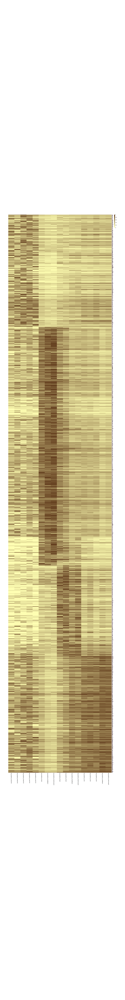

In [43]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [44]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [45]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [46]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [47]:
matrix <- tmp_sample_markers_RNA_mean

In [48]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

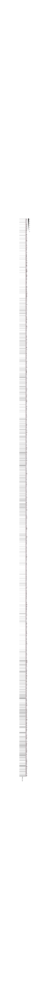

In [49]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, 
cluster_rows=FALSE)
ph

In [50]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [51]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [52]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

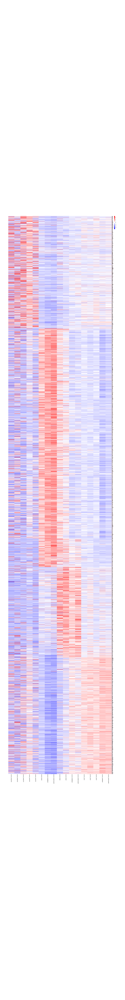

In [53]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [54]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [55]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [56]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [57]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [58]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [59]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

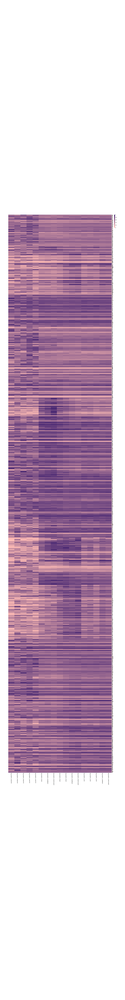

In [60]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [61]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [62]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [63]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [64]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [65]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [66]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

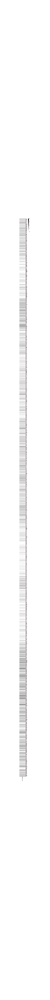

In [67]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [68]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [69]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [70]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [71]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [72]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

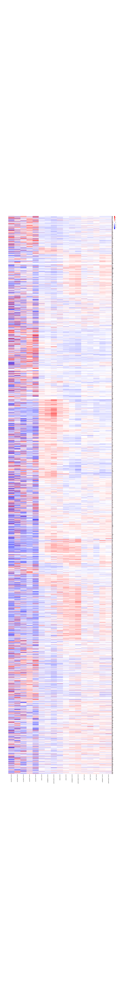

In [73]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [74]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [75]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [76]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [77]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [78]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [79]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

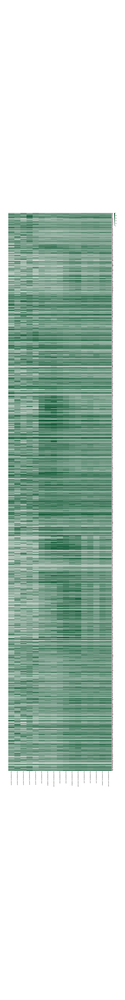

In [80]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [81]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [82]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [83]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [84]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [85]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [86]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

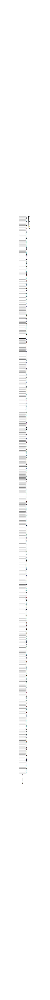

In [87]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [88]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [89]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [90]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [91]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [92]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

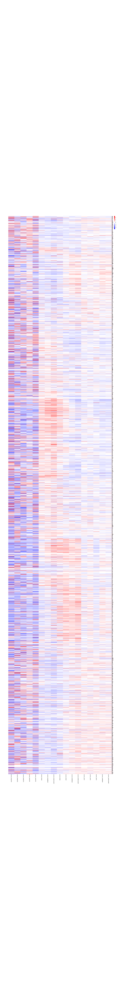

In [93]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [94]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [95]:
Idents(object = tmp) <- "orig.ident_merge"

In [96]:
sample_names <- levels(tmp$orig.ident_merge)

In [97]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [98]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [99]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [100]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [101]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [102]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [103]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [104]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [105]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [106]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [107]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [108]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [109]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [110]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [111]:
saveRDS(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".rds"))

In [112]:
write.csv(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".csv"), row.names=TRUE)

In [113]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [114]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [115]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

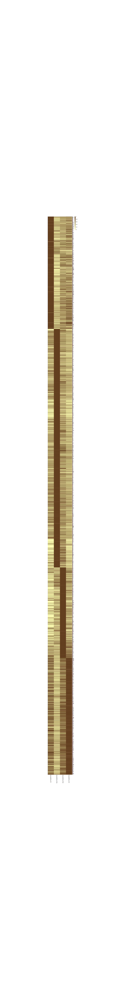

In [116]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [117]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [118]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [119]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [120]:
matrix <- tmp_sample_markers_RNA_mean

In [121]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

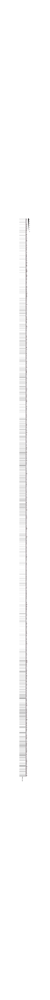

In [122]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [123]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [124]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [125]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

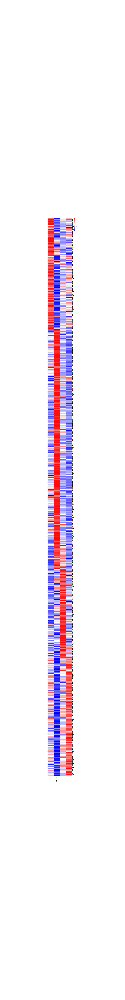

In [126]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [127]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [128]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [129]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [130]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [131]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [132]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

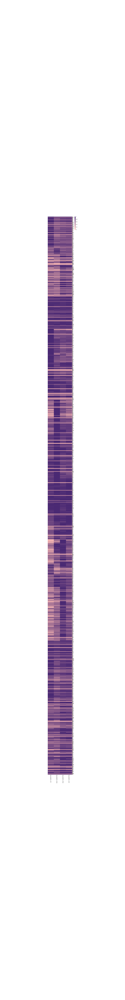

In [133]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [134]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [135]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [136]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [137]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [138]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [139]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

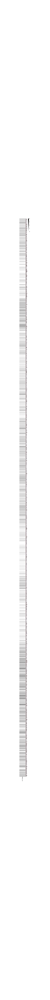

In [140]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [141]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [142]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [143]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [144]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [145]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

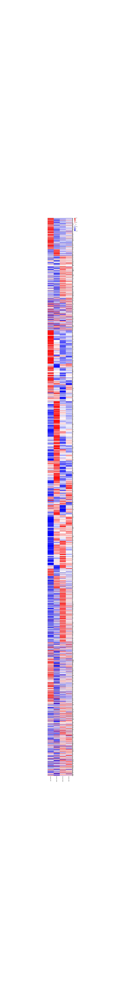

In [146]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [147]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [148]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [149]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [150]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [151]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [152]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

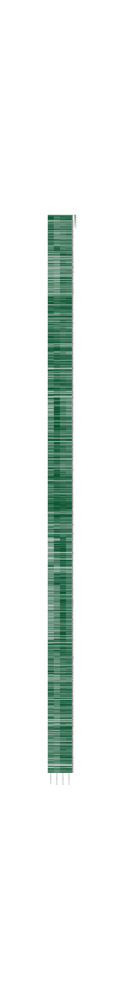

In [153]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [154]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [155]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [156]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [157]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [158]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [159]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

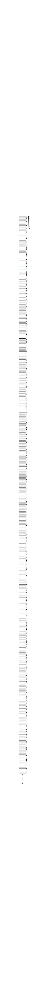

In [160]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [161]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [162]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [163]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [164]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [165]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

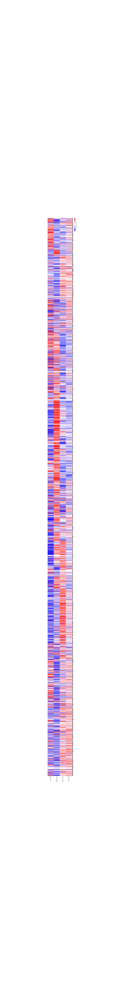

In [166]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [167]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

##### 3.1.2.2 Module dynamics

In [168]:
Idents(object = tmp) <- "orig.ident_merge"

In [169]:
sample_names <- levels(tmp$orig.ident_merge)

In [170]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [171]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [172]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [173]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [174]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [175]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [176]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [177]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [178]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [179]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [180]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [181]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [182]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [183]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [184]:
tmp_sample_markers_RNA_scaled <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [185]:
tmp_sample_markers_GenePromAcc_sub_scaled <- tmp_sample_markers_GenePromAcc_sub/do.call(pmax, tmp_sample_markers_GenePromAcc_sub)

In [186]:
tmp_sample_markers_GeneRegChrom_sub_scaled <- tmp_sample_markers_GeneRegChrom_sub/do.call(pmax, tmp_sample_markers_GeneRegChrom_sub)

###### 3.1.2.2.1 Category 1

In [187]:
gene_list <- c("Osbpl1a","Nnat","Ccdc15","Tyro3","Gm26747","Gm44866","Slc25a27","Crnde","Fosb","Abhd12","Ctsk","Pde5a","Pdk1","Ddah2","Tnfrsf21","Cd300e","Klf11","Hoxa7","Esrrg","Pdlim2","Btd","Anxa5","Deptor","Sort1","Lypd6","Fam117a","Micall2","Mylip","Gpsm1","Orc1","Cenpm","Fahd2a","Hist2h3c2","Slc34a3","Evi5l","4930419G24Rik","Ccdc82","Mfsd13b","Mlc1","Ramp1","Adamts20","Cnksr2","Arid3b","Thbs3","Scel","Gm50013","Gm15886","Tsc22d1","Rab11fip4os1","Cep72","Pmm1","Hs3st1","Ypel1","Enpp1","Gm45479","4932443L11Rik","Pbx3","Lims2","1700094J05Rik","Col9a1","Rccd1","Rwdd3","Ankub1","Jade1","Slc25a18","Tubb2a","B230323A14Rik","Ddb2","Sema4d","Sccpdh","Col9a2","Gm44992","Mpped2","Abca6","Tmeff1","Dlk2","Fsd1","Depdc1b","Epha4","Wls","Gm37459","Zcchc18","Pde4a","Itih3","Masp1","Hacl1","Nppc","Gramd4","Acer2","Rybp","Galnt6os","Gm36278","Ccdc148","A930017K11Rik","Zfp462","Cntfr","Slc7a15","Spock3","Acly","Anxa7","Tbc1d16","Tagln","Gm26759","Gm30613","Gls2","Acsbg1","Clgn","Srsf12","Coro2b","E530011L22Rik","Jph4","Ttll3","Fibin","Supt3","Kcnab1","Vegfb","5330438D12Rik","Sgk2","Lrrc31","Srrd","Slc25a23","Gria4","Lypd6b","Tmem169","Lrrc36","Gm48765","4930426I24Rik","Pdzrn3","Cdh8","Efemp2","9530051G07Rik","Nudt8","Hmmr","Golim4","Iffo1","Tspan7","Aph1b","Gm50232","Folh1","Nipa1","Prtg","Slc1a5","Cipc","Cobl","Adam18","Gm38948","Nek8","Pard6g","Pld2","H1fx","Rasgef1b","Gm37768","Grm3","Rbm11","Adamts2","Wdr17","Ldhb","4921504A21Rik","Slc25a53","Mroh3","Aif1l","Scg5","Mblac2","Nol4l","Slc22a17","Tmtc4","Npb","Anapc2","7630403G23Rik","Gm16000","Clrn1","Slc5a11","Gna12","Bphl","Zc3h8","Gm29361","Kctd16","Sowaha","Ccng2","Gm28379","Gm43376","Letm2","Armcx1","Pkd1l3","Esrra","Unc13b","Pls1","Sorcs3","Naalad2","Fdxr","Kif21b","Chdh","Klf10","Ly6g6f","Wfdc18","Mia","1700015F17Rik","Gm11457","Tub","Vangl1","Rmnd1","Stard4","Serp2","Apex1","H6pd","Shc4","Gm12758","Armcx2","Cacna2d4","Mfsd4a","Gm37756","Ankrd9","Dnajb2","Cox6a2","Gm26660","Plekhf2","Gm11149","Gm17036","Tmem81","Cd300lf","Cmtm7","Zfp839","Fam234a","Dipk1a","Chst8","Rgsl1","Cd55","Nipal3","3010001F23Rik","Ephb2","Stmn3","Gpr176","Tspyl4","Adam22","Adgrb3","Zfp395","Lingo2","Gm37494","Htr2b","Gm4876","Rdh9","Msrb3","5033421B08Rik","Mef2c","Gm16054","Art3","Adarb1","Irak2","Celf2","Ly6g6d","Nebl","4930405A10Rik","Zfhx2os","2210411M09Rik","Grhpr","Gm5441","Snap25","Mfge8","Plp2","Lrat","4930593A02Rik","Mgst3","Gm15764","Sema4a","Casp1","Mgll","Frem2","Gpr137b","Gm37229","Gm9934","Adarb2","4930513D17Rik","Bcas1os2","Gm20631","4933424G05Rik","Gm816","Rora","Syne1","Itpkb","Rnase4","Reln","Tuba1a","Uchl1","Akip1","Kif5a","1110019D14Rik","Filip1","Msi1","Nkx2-9","Rcor2","Frzb","Rapgef4","Serpind1","Gm5089","C030029H02Rik","Slc12a4","Atp13a4","Prdm1","Slc4a4","Gdpd1","A230001M10Rik","6720489N17Rik","Zkscan16","Gm31718","A330008L17Rik","1810010H24Rik","Usp29","C1qc","Spint2","Fcho1","Gm16168","Mfsd4b1","Gm48370","Retn","Sh2d3c","Atcay","Nme5","Pygb","Plekha7","Bace2","Gm15414","Dcdc2a","Kif26b","Fam20c","Gabra2","Kif7","A930024E05Rik","Gm34590","Pdk2","Gm41492","1110046J04Rik","Cd83","A930006I01Rik","Slc9a3r1","Mgat4c","Tnfrsf11a","Aass","Ccdc88c","Hist1h2be","Pacc1","Ntsr2","Tifa","Creg2","Zswim9","Fam181b","Tmem216","Pla2g7","Rida","C230037L18Rik","Luzp2","Fam3c","Rnaset2b","Ncs1","Gm36849","Gm17491","Cavin4","Cux2","Mmp15","Fry","Ndn","Gm35696","Ptpn18","Usp13","Cyp27a1","Col11a2","Ripk4","Cbs","Fam173a","Ranbp17","Ccdc85a","Gm15657","Shld3","Cntnap2","Prrg1","Gm47371","Gjb2","Crip1","Uevld","Mettl7a1","Abcb9","Kcnn3","Nid1","Vmn2r57","Mex3b","Acsf3","Inka1","Sept6","Maf","Nqo1","Vmn2r87","Trim36","Gm3764","Shroom1","2700046A07Rik","Adra1b","9330175M20Rik","Tenm2","Macrod1","Mtmr14","P2ry14","Chn1","Epha10","Suclg2","Kcnip3","Adam1a","Crybb1","Tubb2b","Fn3k","Ephb1","Gm16212","Gm43848","Hist1h1e","Slc9b2","Gm48740","Samd12","Hopx","Kcna2","Sspn","Hist1h4d","Gm48508","Gm28085","Evl","S100b","4930471L23Rik","Car5b","Gm48342","Wdr72","Hhip","Map2k6","Sirt5","9330117O12Rik","4930511M06Rik","Lurap1","Gm45338","Rdm1","Ppm1f","Plch2","Gm32036","1700087I21Rik","Ceacam1","Ccdc30","Aldh2","Gm13708","Myh7b","Gm11437","Slc45a3","9530034E10Rik","Serpinh1","4930469K13Rik","Atp2b2","Tex52","Gm15347","Dnaja4","Dynlt1a","Cryzl2","Gm48742","Shisa8","Ccdc24","Gm48371","Gm33948","Stmn1","Pdcd4","Car7","Ift140","2610206C17Rik","Izumo4","Oser1","Dbil5","Zkscan8","Ppcdc","Pcsk6","Shroom2","Appl2","Gpc5","2810468N07Rik","Pou2f2","Ttc39c","Hspg2","Gmnn","Isca1","Pacsin3","Rbks","Gm15672","Gnai1","Chst12","Wnt5b","Bcorl1","Nkd1","Nat8f1","Golt1b","Npc1","Snx32","Spg20","Afap1","1700066M21Rik","Mvd","B430010I23Rik","Coro7","Relb","Tmx4","Brca1","Hebp1","Cry2","Gpsm2","Gm10827","Pigp","Dgkz","Cep83os","Scamp5","Gjc2","Kctd4","Timp2","Gm10687","Dbp","Gng8","Ankrd44","Adcy9","Gm49012","Bloc1s5","Prxl2a","Itgb4","Lrrc1","Tmem14a","Cat","Maged2","Rfx2","Epn2","2310022B05Rik","Fgd3","Plekhh1","Nfe2l2","Ice2","Sox8","Bfsp2","Jazf1","Rasl11b","Itm2c","Tmem246","Trib3","Scrn1","Pik3c2b","Zc2hc1a","Pnrc1","Mycbp","Gm31152","Ypel2","Cmtm5","Enpp6","Depdc7","Tet1","Tmem143","Dscam","Gm26531","Polq","Mcam","Cdh11","Ilvbl","Gen1","Papss1","Qpct","Arsg","Slc25a42","Gca","Gas2","Efcab2","Stard5","Gm36608","Utp14b","Amdhd2","Commd10","Rdh12","Kiz","Gm15853","Siae","Fam228b","Fbxo17","Slc25a29","Chn2","Gm49519","Ang","Gm42413","1700029J07Rik","Mtus1","Gipc1","Tmem106c","Efcab5","Igsf8","Glod4","Naglu","Xrcc3","Spata24","Serpinb1a","Stau2","Dnajc6","Sel1l3","Rap1gap","Tmem163","Gm38560","Rab7b","Fads1","Gm50399","Tst","Mpv17l","Gm49042","Acy3","Plat","Hilpda","Kif6","Ctnnal1","Btbd8","Grk5","Cep70","Lpar1","Prkca","Pigz","Bahcc1","Cep112","Stk10","Mapre2","Gm12367","C630043F03Rik","Hsd17b7","Arhgef28","Pcx","Kif3a","E230016M11Rik","Gm26542","Lig1","Rims1","Trim13","Pacrg","Nr4a1","Tmem255a","Aspa","Smpdl3a","Slc35e1","Rfc5","Gnb4","Sh2b3","Agbl3","Kctd10","Tes","Gm26618","Lekr1","Ap2a1","Zfp503","Ppip5k2")

In [188]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [189]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [190]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [191]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [192]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [193]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

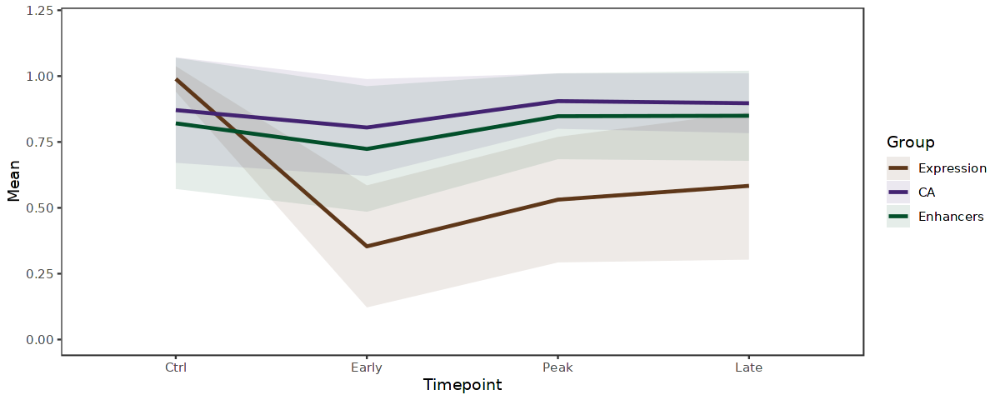

In [195]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.2 Category 2

In [196]:
gene_list <- c("Defb47","Ctsc","Timp1","Igfbp2","Bex2","Oaz3","Tnfsf9","Pgf","Pigo","Angptl1","Rpl24","Irak1","B3gat2","Stk16","Gtpbp4","Lbh","Rpl30","H2afx","Snrpe","Romo1","Mrpl4","Srsf2","Cycs","Txnl4a","Zfp692","Rrp8","Surf2","Dhcr7","Gm47283","Tenm3","Gm34868","Cct6a","Rpl7l1","Gm20319","Hist2h2aa1","Noa1","Ndufa12","Wdr75","Gadd45g","Cacybp","Rpl9","Rpl4","Dancr","Lsm8","Prpf31","Mrpl54","Acbd4","Serpine2","Kdelr2","C1qbp","Tsfm","2410004B18Rik","Timm23","Usp50","C1ql3","Rplp2","Wdr55","Ilf2","Rps20","Rpl29","Rpl41","Rnf126","Rcc2","Elof1","Lrrc59","5430416N02Rik","Lyar","Grpel1","Ptges3","Cdk11b","Rpl22","Ddx24","Nip7","Tbc1d10a","Epas1","Tmem258","Rbmxl1","Mitd1","Acat2","Nsun2","Cyp51","Pmvk","AI506816","Gas5","Phf5a","Rrp9","Prex1","Tmem97","Lsm12","Mak16","Fgfrl1","Kat2a","Polr3d","Clptm1l","Rps19bp1","Mphosph10","Eef1akmt4","Gm38335","Ipo5","Psme3","Alyref","Rps23","Grwd1","Lrrtm2","Pomp","Mdn1","Camk2n2","Shfl","4930599N23Rik","Kri1","Ctdnep1","Uqcrq","Rpl12","Gnl2","Elp5","Ydjc","BC003965","Rpf2","Tbcc","Rpl21","Gas2l1","Ftsj3","Lamtor1","Nhp2","Wdr4","Emc6","Usp19","Slc38a2","Sppl2b","Pgk1","Cdc42se1","Rpl17","Gm26533","Srsf9","Sertad1","Rangrf","Gps1","Taf1d","Ccl2","Baalc","Abracl","Ccnd2","Slc7a10","Gm26672","Slc24a5","Nphs1","Aqp4","Hspb1","Ttc9","Rab33a","Pus3","Grsf1","Eif2ak2","Msantd4","Ifitm3","Adamts1","Ppan","Polr1e","Nop58","Cthrc1","Gemin5","Tomm22","Tgfbi","Hgh1","Rpl8","Gpn2","G6pc3","Med7","Lyn","Mpp6","Nras","Rps25","Nop9","Rps26","Mrpl41","1810009A15Rik","Mrpl30","Rps28","Lmo2","Snhg3","Higd1a","Atad3a","Commd2","Ddx27","Gap43","Alg3","Trmt61a","Nkrf","Dynlt1f","Ebna1bp2","Tmed9","Uba52","Nle1","Idh3b","Noc2l","Bccip","Brix1","Rpgrip1","Gm17300","Agt","Bola3","Tsr1","Ccdc137","Sco2","Wdr74","Sigmar1","Abcg2","Gars","Gm10563","Rps27","2310058D17Rik","Inhbb","Pabpc4","Bak1","Maml2","Atic","Enkd1","Pfn1","Nars","Slc25a5","Eef1d","Lonrf1","Pum3","Ndufaf8","Tomm6","Rpl36al","Rpl31","Kbtbd11","B4galt5","Baz1a","Nup153","Rpl18a","Mettl23","Atp8a2","Gm3435","Gm16316","Gm32568","Gm47898","Gm37165","Unc13a","Ivns1abp","Cfap298","Snu13","Dcp2","Tex261","Sac3d1","Mettl1","Ddx39b","Rsl1d1","Rps2","Rce1","Timm50","Ptprn2","Gm16175","Gm17089","Tpt1","Ppie","Tbrg4","Telo2","Dus4l","Rps14","Ak6","Eif2b1","Rps27l","B9d2","Rps13","Nav2","Gm10701","mt-Nd1","Stk19","Cmtm6","Ddx21","Timp3","1110038F14Rik","Eif3b","Dbt","Leng9","Arhgef40","Nifk","Rpl32","Rps6","Exosc3","Ptges2","Kti12","Rsl24d1","Mrpl12","Strip2","Hs2st1","Ciao2b","Vcan","Sqle","Wdr46","Psme2","Pikfyve","Gm26519","Pdpn","Tcf7l2","Cdk14","Gm32856","Gpr137c","H3f3a","Arpc1a","Mrps22","Fads2","Nfkbia","Pcdh17","Id1","Casp7","Bhlhe40","Ccng1","Rtcb","Esf1","Samhd1","Tmem160","Slc7a1","Yrdc","Upf1","Actr1b","Med22","Rack1","Rpl7","Twistnb","Mcfd2","Rplp1","Polr2k","Ccdc134","Rrs1","Znhit3","Tmsb10","Gcsh","Ltv1","Mrps27","Btf3","0610009E02Rik","Strap","Rpl27a","2810004N23Rik","Dph3","Mrpl49","Arpc5l","Kars","Psmd12","Utp14a","Prelid3b","Clba1","AC160336.1","Trmt1","Nudc","Dalrd3","Smndc1","Eif3i","Chchd4","Prmt5","Rpl10","Eef1g","Elovl1","Dpm2","Polr1d","Rps15","Ddx39","Parp3","Cebpz","Daxx","Rnps1","Arid5a","Ralgds","Cebpd","Mrm1","Eml4","1600010M07Rik","Cgas","Nrxn1","Map3k20","Sharpin","Sox5os4","Adgrg2","Rpl27","Abcf2","Tmem208","Nfkbib","Brd3os","Gm36816","Gm10602","Rpsa","Mrpl52","Ripk2","Srrt","Snhg4","Mdh2","Exosc1","Rpl23","Rnf122","Cct3","Hspa5","Rpl23a","Bcs1l","Gm28221","Mrm3","Insyn2a","Cavin2","Rps16","Rps5","1700126G02Rik","Gm16068","Car10","Gm42047","Nudcd2","Ubqln4","2410006H16Rik","Synpr","Btbd16","Pde3b","Csrnp1","Ecm1","Cntn1","Chl1","Stx1b","Tnfrsf12a","Rgs17","Atf3","Spout1","ccdc198","Fosl1","Il33","Dph5","Tfdp1","Neb","C1ql2","Gsap","Gpr151","Scg3","Fgl2","Ido2","Cdkn1a","Tagln2","1110038B12Rik","Sema3e","Gfra1","Rgcc","Cers6","Igf2bp3","Pcnx","Tmod2","Cebpa","Kctd11","Gm19744","Kdm6b","Gm19935","Tepsin","Emp3","Amotl1","Gm14798","Gm10791","Etv6","Pgs1","Hmga1","Arhgap24","Midn","Rps6ka3","Steap3","Dtna","Ucn2","Casp4","Slfn9","Isg15","Dnttip1","Fchsd2","Sphk1","Cpne8","Mvp","Cacng5","Rnf125","Becn1","Clec2d","Cntd1","Sv2c","Ophn1","Lrtm2","Upp1","Gm3448","Kcnk2","Igf2bp2","Helz2","Slc9a3r2","Asb13","Lysmd2","Psme1","Nab2","Gm16223","Rpl9-ps6","Kcnk10","Folr2","Ldha","Brinp1","Kit","4933406I18Rik","Ric3","Gm20470","Snhg16","Ptpn5","Axl","Rnf213","Ermard","Rgs20","Tubb6","Nrcam","Osmr","Sec61g","Pkig","Cldn11","Gm28370","Crybg1","Gm48708","Dclk2","Maff","Gpatch4","Surf6","Pros1","Slc35f5","Fga","Syne2","Cyp2j9","Sdf2l1","Mafk","Add3","Rdh5","Heatr1","Nradd","Akr1b8","Gdf11","Rchy1","Pop5","Cd200","Pdrg1","Rassf4","Selenow","Dusp7","Znfx1","Fdft1","Setd6","I730030J21Rik","Gm16069","Gm15518","C1qtnf1","Baiap2","Tuba1b","Mat2a","Arpc1b","Nr2c2ap","Bcl3","Nubp1","Arrdc4","Fdps","Nap1l1","Laptm4a","Rab34","Mapk14","Rmdn3","Gadd45b","Pou6f1","Cic","Egr2","Sorcs2","Zrsr2","Tcerg1","Odc1","Ogfr","Zfp36","Rps10","Atp5e","Cd63","Qrsl1","2700038G22Rik","Znrd1","Snhg6","Socs3","Dkc1","Prorsd1","Srxn1","Rrp1b","Bzw2","Sdad1","Mt1","C230035I16Rik","9530082P21Rik","Gpx1","Tubb3","Akap12","Idnk","Soga3","Pdxk","Ascc3","Rnf217","Atp6v1h","Chic2","Bmp1","Cd151","Gm12530","Snhg17","Fbxo27","Socs2","Lypla2","Trmt61b","Rps15a","Ebp","Lyve1","Nudt9","Rbm3","Pi4k2a","Rps12","Ube2v1","Clic4","Psmb10","Rpl13","Pfdn4","Fam216a","Ccnd1","Lsm2","Nampt","Pin4","Kpnb1","C78859","Wsb2","Acd","Rexo2","Manf","Ngdn","Polr2h","Eif5a","Pdcd5","Timm8a1","Creld2","Eif1a","Plod3","Iffo2","Ranbp1","Cdk4","Mbd3","Ptbp1","Gm42917","Gm15601","Gm17494","Ran","Idh3a","Nme2","Nubp2","Btg2","Calr","Ctu2","Trmt6","Prmt1","Lsm4","Txn2","Tomm40l","Rps8","Tma16","Nolc1","Jcad","Map2k3os","Rab26os","Rnf225","Cltb","Cstb","Psmd3","Lmna","Nod1","Grik3","Crem","Metrnl","Tapbp","Myd88","Aasdhppt","Pcbp3","Peak1","4921516A02Rik","Rps29","Wdr43","Nop2","Map2k1","Gpd1","Tmem243","Ndufv2","Phlda3","Gm26788","Syncrip","Il4ra","Ak2","Mob3c","Etv1","Unc79","Tspo","Polr2f","Kcnmb4","Adar","Nsdhl","Ncoa2","Cdh24","Gm26797","Gm4117","Slc45a4","Anks1b","Grik2","9530059O14Rik","Irf2","Pou3f1","Clcf1","Larp1","Rpl5","Rps17","Anp32b","Slc25a22","N4bp1","Ccne2","Stat2","Endod1","Npm3","Hnrnpd","Tomm40","Ssr4","Cad","Spryd4","Rpl10a","Zfp428","Abhd11","Lsm7","Banf1","Rpl37","Rab5if","Fdx2","Utp11","Rab11fip5","Sat1","Pdap1","Tmem147","Tmem88b","Frmd4a","Tent4a","Tars","Brd2","Ada","Zfp207","Nop16","Relt","Yae1d1","Fubp1","1700123O20Rik","Rps3","Wdr89","Tsc22d4","Pcyox1l","Yars","March5","Pqlc1","Sox2","Btg3","Atf4","Lmo4","H3f3b","Pwp2","Gm44777","Eef1akmt1","Insig1","Pcgf5","Tsr3","Zfp593","Fkbp1a","Hnrnpa1","Sc5d","Eif5b","Rpl6","Timm10","Rasip1","Sbno2","Bend6","Egr1","Naa25","Trf","Pcyt2","Xaf1","Msmo1","Cdk6","Syvn1","Pvr","Scfd2","Rtkn","Atp5md","Nrap","Id3","Hspe1","Hspd1","Arf4","Emd","Atp5g1","Chpf","Plscr3","Lmnb2","Cdkn2d","Mrps18b","Taf1c","Ncl","Rhoj","Cfl2","Acod1","Mcub","Gm36043","Rps19","Pithd1","Hmgn1","Zmym1","Arfip2","Taf10","Prr11","Fam136a","Nlgn2","Myc","Lss","Gmppb","Serbp1","Zdhhc13","Zfp281","Selenom","A630089N07Rik","Fndc4","Tnc","8030451A03Rik","Ltbr","Cgref1","Arhgef12","Ldlr","Ier2","Nup210l","Rnf135","Manbal","Il1rap","Gfap","Nfkbiz","Cadps","Antxr1","Cab39l","Ptprj","Gm12940","Vars","Btc","Pvt1","Inpp4a","Slc39a1","Rps27a","Gale","Arap2","Slc7a14","Trib1","Pa2g4","Phb","Ears2","Col16a1","Sec61a1","Trmt112","Impdh2","Ttyh1","Hsph1","Tnni1","Erh","Srsf10","Nop56","Pus7l","Gnb2","Gtpbp6","Rps18","Wars","Ybx1","Rpl18","Cd3eap","Rpl38","Txndc11","Rnf139","Map2k3","Ostc","Ctps","Ccdc124","Arf6","Hnrnpab","Zpr1","Snrpa1","Gm15559","Zfas1","Epb41l4aos","Cybc1","Mrps5","Rplp0","Snhg1","Trmt10c","Nob1","Rrp7a","Rpl22l1","Sub1","Rpl34","Usp36","Eef1e1","N6amt1","Pfdn2","Pusl1","Rpl36","Jagn1","Fau","Noc4l","Pak1ip1","Rpl7a","Pes1","Emg1","Nme1","Mecr","Phb2","Wdr38","Pim1","Ubash3b","Irf2bpl","Pigf","Ctu1","Pim3","Eif2s1","Cggbp1","Ndufaf4","Gjb1","Sf3b4","Gnl3","Ywhab","Timeless","Idi1","Gm38251","Gm43118","Dph2","Ppid","Ddx49","Srsf6","Sra1","Rps3a1","Mcl1","Dis3","Tomm7","Phykpl","Fbl","Rwdd1","Isg20l2","Rangap1","Btg1","Eef1b2","Abce1","E2f4","Jun","Slc25a3","Taf7","Rev1","Wdr77","Gar1","Rabggtb","Rpl19","Upf3a","Nt5c3b","Noct","A930037H05Rik","Ufm1","Dus3l","Bms1","Slc3a2","Brip1","Rpl28","Ppp1cc","Gemin6","Exosc2","Ddost","Eif2s2","Pml","Cyp20a1","Rps7","Rpl35a","Snrpf","Hist1h4h","Chmp4b","Hint1","Mars","Rpl11","Nat14","Pdss1","Cdc14a","Nfyb","Utp20","Nop14","Hap1","Atp1b2","AC156546.1","Gm16982","Map3k1","Ptpn1","Dhcr24","Rpl37a","Acsl3","Scd1","Ap1s1","Selenos","Ppm1e","Rps4x","Rab21","Rps9","3110082I17Rik","Slc31a2","Fhod3","Naca","Snhg5","Naa50","Eef1a1","Ninj1","Hnrnpf","Srpr","Ruvbl2","Ddx54","Mybbp1a","Hnrnpa2b1","Timmdc1","Srp9","Dbi","Azi2","Il6st","Ahctf1","Slc35a4","Slc35b1","Lpo","Pabpc1","Tox2","Sfxn2","Cdv3","1110008P14Rik","Eif4a1","2410002F23Rik","Batf2","Dtymk","Set","Cluh","Gm17108","Ormdl2","Aen","Rps11","Srm","Dad1","Mrto4","Snrpd3","Ntmt1","Taf5l","Dohh","Rps21","Bola2","Slc1a4","Taf4b","Dnph1","Atad1","Src","Txnrd1","Jmjd6","Xbp1","Hmgcr","Pdcd11","Hmgcs1","Notch1","Rpl15","Dnajb5","Snhg8","Eef2kmt","Arid5b","Rbl1","Rnf19b","Srrm3","Carmil1","4933412E12Rik","Psmb5","Ppil1","Ube2cbp","Thg1l","Med8","Mchr1","1810055G02Rik","Mrps23","Psmg4","Rps24","Prmt7","Polr1c","Cct2","Polr3h","Bop1","Cdk2ap1","Ifrd1","Ccdc73","Ppa1","Srsf7","Agpat5","Nol12","Wsb1","Ccdc115","Noc3l","Ythdf2","Imp4","Psmc4","Timm9","Ndst1","Mfsd12","Lsm6","Dda1","G3bp1","Atp5g2","Ccdc86","Snrpg","Llph","Dus1l","Ddx51","Prelid1","Rpl14","Mier2","Ssr2","Pus1","Med10","Ctxn1","Fmn2","AA467197","Ccdc25","Lnx1","Spry1","Cox7b","Spry2","Galntl6","Polr1a","Hddc2","Tmem42","Klhl29","Mfsd10","Ddx18","Daglb","Tent5a","Gm47167","4930452G13Rik","Slc39a10","Gm20721","Mov10","Ddx58","1700001K23Rik","Fcf1","Angptl4","Wdr83os","Nudt19","Polr2l","Tasor2","Nmi","Gsta4","Ubxn8","Sox5","Gm41505","Adsl","Ybx3","Dnajc2","Fastkd1","Rrp15","Npff","Hypk","Dimt1","Ifrd2","Tex30","Eif1ad","Mob4","Eif3j1","Ipo4","Mrpl15","Psma7","Flot1","Mrpl20","Rrp12","Snrpd1","Eif6","Eif3k","Rab5c","Fosl2","Cox5a","Rpl39","Krtcap2","Il17ra","Mrps26","Rars","Snx10","Pno1","4930453N24Rik","Bud23","4930579G18Rik","Gm49066","Bax","Mrpl32","Cbarp","Cep126","Rpl36a","Snhg12","Smyd5","Dnajb11","Ggct","Cct8","Rpl26","Utp4","Mrfap1","Zfp511","Znhit6","Psma4","Slc38a1","Bysl","Npm1","Tmem251","Rpl13a","Spink10","Olfr1369-ps1","Isg20","Irf8","Rtp4","Ifit3","Mrgpra1","Ccl8","Phf11d","Gbp2","Rpl10-ps3","Serpina3f","Gjb6","Trim30d","Timp4","Ms4a4b","Rps27rt","Ifit1","Gm10076","Oas2","Usp18","Ifi35","Pdlim4","Pdzk1","Ccrl2","Asns","Aprt","Ppp5c","Ier5l","Gm26944","Irf1","Nlrc5","Pnpt1","Tut1","Zfp952","Osbpl10","Klhl32","Gm14164","Vgf","Tspan4","Arhgap28","Socs1","Ano3","Gbp3","Fam111a","Mlkl","Pde3a","Cd274","Apobec3","Irf7","Eif3j2","Zc3hav1","Eid2","Bst2","Stk32a","Serpine1","Papss2","Sdc3","Slc10a6","Acsl5","Slc6a20b","Igtp","Cmpk2","Psmb8","Trim21","Gbp5","Pik3r5","Herc6","Neto2","Gabbr2","Tor3a","Dtx3l","Irf9","Syt6","Il15ra","Trim25","Gm15283","Tnfrsf1a","Il12a","Ube2l6","Trim56","Mt2","C1ra","Parp14","Nsun5","Gm11361","Snhg15","Erg28","Znrd2","9030025P20Rik","Hmgn3","Gstm6","Parp9","Gm26749","Atp10a","Slc2a12","AW047730","Ifit3b","Pgghg","Lgals9","Cemip","Plce1","Slc14a1","Egln3","Aacs","Ier3","Tmem47","Tbc1d1","Mt3","Gm16537","Nmnat2","Sparcl1","Runx1","Fen1","Igsf10","Rsad2","Wnk4","Tap2","Far2","A2m","Prr16","Dhx58","Slc35f4","Piwil4","Hk2","Ilrun","Susd6","Adgrl3","Nutf2-ps1","Plvap","H2-T22","Gm12216","Rbm43","Tapbpl","Ppp1r1a","Rnasel","Gpr22","Emc4","Tmem128","Inppl1","Ifih1","Plaur","Sp140","Cxcl10","Glis3","Acsl6","Igfbp3","Sez6l","Atp1a2","Lrfn2","Nim1k","Dgkh","Cldn10","Calhm2","Uchl4","Ndrg2","Slc1a2","Alpk1","Slc6a11","Nek6","Chil1","Klk9","Sdc4","Ddah1")

In [197]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [198]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [199]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [200]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [201]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [202]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

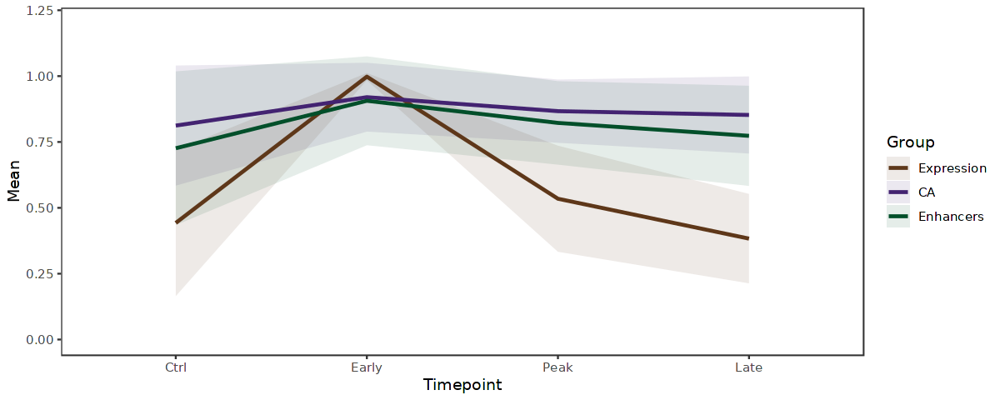

In [203]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.3 Category 3

In [204]:
gene_list <- c("Inhba","Hist1h1c","Stmnd1","Gpx3","Ctnnd2","Snhg18","Ccl5","Phtf1os","Pcdhb18","Saa3","Gm3235","Apoc2","Fhit","Hhatl","Snx22","Dab2","Tmem106a","Dll1","Fgf12","Clstn2","Morc4","Plpp6","Vmac","Vwa1","Sema3f","Aldh5a1","Stat1","Slc9a9","Actn1","Lncpint","Hist2h3c1","Pir","Chil3","Srgn","H2-DMa","Adm","Gsdma","Phka2","Gm42067","Cspg5","Avpi1","Mc1r","Slc39a14","Gpr146","Htatip2","Phyhd1","Fxyd3","Tcim","Cd44","Gm16675","Slc4a11","Ifit2","Slc6a8","Zfand4","Mir22hg","Adam9","Hmga2","Vsir","Mfsd2a","Gm11772","Klf4","Galns","Rbfox1","Zbtb7b","Zfp703","Cpm","Parp11","Txn1","Gch1","Celf4","Plxnb2","Hspb2","Etv4","Plec","Spred3","Atf5","Kndc1","Lgals1","Gm46519","Nde1","B4galt6","Klf9","Cstad","Ehbp1","Fbxo36","Gdap1","Pdgfc","Sap30","Erap1","Pnpla2","Diras1","Sgk1","Capn5","Col5a3","Gbp10","Matn2","Pls3","Kcnb1","C2","Vim","Il12rb1","9330175E14Rik","Tubb4b","Blvrb","Dpy19l3","Tvp23a","Etv5","Myo1c","Arrb1","St3gal3","Zfp488","Pipox","Ifi27l2a","Cxcl14","Lyz2","Vav3","C1qb","Klk8","Them6","Ly6e","Garnl3","Tgtp2","Ccdc122","Gm12185","Ucp2","Parp10","Ifi44","Lrch1","Fam155a","Ly6a","Armc2","Casp12","Itpripl2","Plin2","Fam13a","Dglucy","Fbxo31","Gm7292","BE692007","Serpinb9","Cpe","Pknox2","Ttc12","Mcc","Nos1ap","AU020206","Olfr1124","Scml4","Tuba4a","Rsph9","Itpr1","Ddx60","Mrgpra9","Kcnj6","Gnaz","Cacna1h","Zfp385b","Patl2","Trim34a","Ms4a6c","Shroom4","Gbp6","Pdk4","Paqr6","Gm50237","Rgs1","S100a4","Olfr56","Cercam","Fcer1g","Maml3","Mpeg1","Pald1","Cyba","Me3","Greb1","Pbx1","Aldh3b1","Efhd2","Erp27","Aff2","Lgi4","Podxl","Spp1","Epb41l5","Tap1","Nupr1","Pomc","Crlf2","Gm44850","Pnpla7","AA388235","Agbl4","Oas1a","Serpina3i","Ifitm2","Mocos","Apol9b","Sult1a1","H2-M3","Pycard","Sez6","F830016B08Rik","Serpina3c","9530077C05Rik","Spock1","Tlr3","Gria3","Ccl6","Col1a2","Arhgap44","Slco5a1","Nap1l5","9930111J21Rik2","Rbp1","Hspb8","Mapk8ip2","Gm12326","Gm2245","Tle6","Gbp9","Wwc2","Itga9","Gm17135","Serping1","S100a11","Cntf","Gm4951","Trim30a","Gbp8","AW112010","Gabrb3","Il18bp","H2-DMb1","Aldoc","Gm15417","Clybl","Palm","Cebpb","Adamts9","Nol3","Kcnip4","Fam180a","Irgm2","Parp12","C1qa","S100a10","Pqlc3","Elavl4","Apol9a","Large1","Ciita","Herc3","Hrh2","H2-D1","Fam214a","Serpina3n","H2-Eb1","Vat1l","Lcp1","Psmb9","Fn1","2010300C02Rik","H2-Q6","Ptpre","Ly6c2","Trim47","Gm20559","Mtcl1","Esyt3","Lynx1","Lrp8","Iigp1","Scrg1","Ifi47","Oasl2","Gpr143","Sox4","Ctsh","Cdh13","Akr1b10","Serpina3g","H2-Q4","Trim5","H2-K1","Tmem140","Pdzrn4","Gpnmb","Crmp1","Cast","Aox1","Chst2","Lcn2","Clic1","Ntm","Zbp1","Gldn","B2m","H2-T23","Itgad","Nudt4","Abhd15","Hfe","Mgst2","Fxyd5","Ifit1bl2","Bcat1","S100a6","Mgp","Bmerb1","E230001N04Rik","Trim12c","Gm22146","Traf3","Olfm2","Vwa5a","Gm20536","Tmtc1","Gbp4","Fcgr2b","Dtnbos","Pmepa1","Stx3","Bid","Tcirg1","Dner","Mill2","Gm39469","Arrdc1","Mgst1","C530008M17Rik","Nrg1","Serpina3m","Arg1","Tyrobp","Tnfsf11","Dusp6","Wfdc17","Mrgpra6","Tstd3","Cd74","Serhl","Clca3a1","Pla2g3","Osbpl5","Copz2","Clic5","Cfb","Rab37","Agtrap","Apba2","BC028528","Gpc6","Syn2","Abcc4","Sdk1","B3galnt1","Fam107a","Kcnc3","Shisa5","Gm15243","Lgals3bp","Gm4841","Fyb","Hsd11b1","Eif4ebp1","Fuca2","Tom1l1","Trem2","2210408F21Rik","Mrgpra2b","Ighm","Fbxl7","Irgm1","Ly6c1","Cxcl9","Lgals3","Stat5b","Dync1i1","Gm35360","Snca","Gm19684","Gbp7","Shank2","Trim12a","Itga8","Gm5141","Ppl","Cdh22","Dera","H1f0","Samd9l","Moxd1","Il34","Ccdc149","Klf2","Thrsp","Enah","Gm8369","Rgs16","Gpr37l1","Gm41148","Gm49891","H2-T24","Tafa1","Ralgps2","Uba7","Dock2","Heg1","Barx2","Plin4","Bcan","Fam49a","Gm49890","Dennd5b","Tgtp1","Fap","H2-Q7","Gm28501","Smpd3","Itpr2","Slc44a2","H2-Aa","Chchd10","Ttc26","Gm26854","2810029C07Rik","Ptms","Apln","Dtnb","6330411D24Rik","Cd38","Polr3e","Acot11","Nrtn","Lgals2","Slc16a3","Tgfbr3","Glrx","Gm4013","Abcd1","Il17rc","Junos","Nt5dc1","Itprid1","Emp1","Rragd","Col27a1","Rab3il1","Pih1d2","Pacsin1","Hmgcll1","Bdh1","Fjx1","Fbxo21","Fam83d","Myof","Sord","Prob1","Gm29642","Cadps2","Zfp995","Zfp469","Itpk1","Crlf1","Jade2","Slc30a1","Fam114a1","Rell1","Gm10785","Tfap2a","Trafd1","Ifi30","Otud7a","Mxd4","Pcdh1","Lin52","Apbb2","Mmp2","Fgfbp3","Crip2","H2-Ab1","Fsd1l","Uchl1os","Gm16183","Rnf144a","Rom1","Afap1l2","Grn","2610307P16Rik","Fbxo2","Aldh6a1","Atl1","Cpt1a","Pantr1","Gm48796","Cblb","Kremen1","Ramp2","Dap","Pbxip1","Gse1","Prkaa2","Sik1","Kcnma1","Fkbp14","Uap1l1","Nudt16","Thsd4","Slc25a13","Prkcd","St3gal5","Foxo1","Tenm4","Chst3","Gdpd5","Adcy5","Hunk","Nlgn3","Plxna1","Kif9")

In [205]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [206]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [207]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [208]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [209]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [210]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

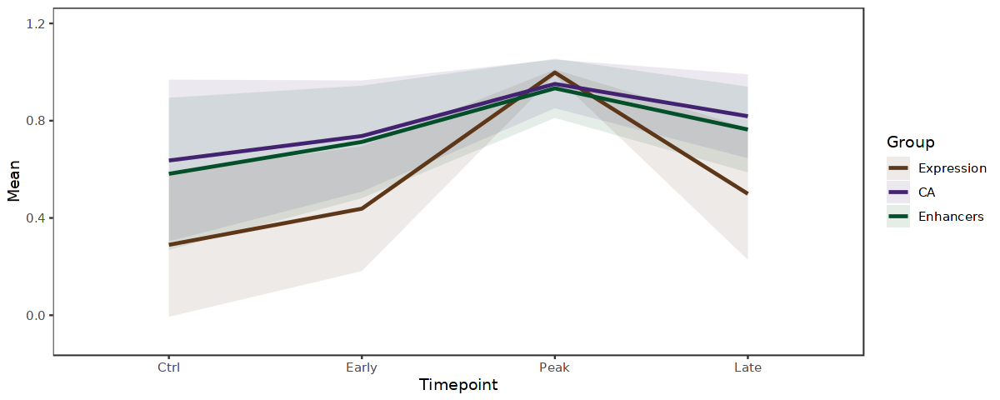

In [212]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.4 Category 4

In [213]:
gene_list <- c("Srgap3","Enox2","4930432K21Rik","Daam1","S100a1","A230057D06Rik","Gm4258","2510009E07Rik","Sqor","Clmn","G630055G22Rik","Bnip3l","Plxnb1","Kat6b","A330023F24Rik","Prima1","4933406C10Rik","Igsf3","St3gal6","Lrrc27","Usp11","Lyplal1","Mob3b","Slc15a4","Gkap1","Wdsub1","Gsta3","Ncam1","Gm34933","Mgat5b","Shcbp1l","Pde8a","Rsph10b","Map1b","Cnbd2","Tmc3","Ttc28","Uvssa","1500015L24Rik","Syt9","Ngfr","Pde10a","Sspo","Tppp3","Grik5","Tbc1d24","Gab1","Anks6","Nr1d2","Cdkl3","Ppm1h","Dscaml1","Pde11a","Hpcal1","Gm14320","Amy1","Scube3","Man1c1","Ptprn","Zmiz1os1","Cdkn1c","Manba","E330020D12Rik","Dzank1","Neat1","Trim59","Gm44899","Tmem117","Plekhg1","Lamp2","Rnf152","Gm40841","Pak1","Gm28941","Prickle3","Lipa","Ajap1","Vamp5","Tmem219","Gm45708","Mboat2","Gm38250","Rftn1","Fggy","Fbxl21","Cntln","Tns1","Zfand5","Vwa3b","Fam222a","Kank2","B230206L02Rik","Zdhhc14","1190005I06Rik","Gm14412","Psd2","Snx29","Ptprz1","Gng7","Defb42","Cdh20","Gm15943","Stpg1","Dach2","Egfem1","Fam102a","Shroom3","Gm29502","Ap3m2","Arl15","Gm43330","Xkr4","Gm39526","Tle2","Tln2","Mroh7","Gm29455","Plxna2","Zeb2","Lrmda","Gm34006","Eya4","Dock7","Gm28836","Rapgef5","Car14","AC241534.1","Zfhx3","Gm26935","Lpcat2","Etl4","Fntb","Acad10","Ano4","Prox2","Map1a","Pacs1","Nubpl","Cenpp","Gm15860","B230206H07Rik","Pak7","Pafah2","Synpo","Gm14966","Gas7","Gm16759","Gm36584","Tcte2","Spdya","Dyrk1b","Sybu","Lhpp","Apba1","Cyp39a1","Elovl7","T2","Fbxl20","Trp53bp2","Pik3cb","Glcci1","Plppr3","Tbc1d4","B3gat1","Tbc1d31","Abcd3","Gm39129","Vamp8","Grik4","Luc7l2","Poln","Ephx1","Pld1","Ugt8a","Gm46515","AI197445","Itgb3","Pkia","Gm43242","Ago4","C2cd2","Dgki","Pard3b","Cul7","Gm12324","Kcnu1","Slc8a1","Tbc1d32","Dzip1","Ak5","Dusp15","Bicd2","Fbxo32","Tspan9","Pik3r3","Rasl12","Podxl2","Sbk3","Bdkrb2","Per3","Zfp975","Phlpp1","Slc24a2","Teddm2","Rps6ka2","Kazn","Ccdc18","Cyfip2","Gpr158","Fbln7","Megf10","Gm4221","Stmn4","Cox6b2","Unc5c","Myrip","Pak3","Slain1","Klhdc1","Sypl","Haghl","Slc12a2","Atp11a","Cdk19","Fnbp1","Gm26881","Rad51b","Bbs9","Gm12743","Atp10b","Zfp169","Flrt1","Gm20754","Prrt1","Tmem132b","Slc35d2","Fam83b","Hscb","Gm43666","Asah2","Dusp8","Brca2","Efs","Tmod1","Ksr1","Gm7598","Thsd7a","Astn1","Gm32926","Gm41836","Gm41333","Epm2a","Pla2g4a","Ppfibp2","Aff3","Atxn1","Mtss1","Gatb","Plekha5","2210011C24Rik","D1Ertd622e","Rap1a","1700012D14Rik","Dtx4","Sorcs1","Rab30","Map3k5","Mthfs","Slit2","Cdk18","Peg13","Sugct","Lrrc4c","Plk3","Gas6","Klf13","Gm4924","Srcin1","Myh14","Atg10","Mkx","Dpysl5","Galnt18","Osbp2","Epb41l2","Rad51d","Edil3","Nck2","6030407O03Rik","Gm14634","Map7","Gm16083","Naaladl2","Notch2","Agmo","Retreg1","Cyth1","Kif16b","Dip2a","2010315B03Rik","Cbx7","Gm35438.1","Col6a1","Rere","Arhgef37","St6galnac3","Smad7","Mast4","Gm13483","Bckdha","St3gal4","Itk","Klhdc8a","Faah","Zfp808","D7Ertd443e","Rassf3","Ezh1","Cyp4f13","Arhgap12","Iqsec1","Gm16124","Pip4k2a","Arnt2","Dact3","Mir100hg","Gm12092","Myzap","Pcdh9","Sept9","Gm26843","2900052L18Rik","Renbp","Nr3c2","Lmo7","Psap","Ccdc191","Rassf8","F8","BC034090","Tpk1","Bcl7a","A330015K06Rik","Fam13c","Nr6a1","2700054A10Rik","5031434O11Rik","Gtdc1","Zfp467","Lima1","Cpeb2","Ccdc62","Zfp438","Usp48","Padi2","Tnxb","Trim7","Khdrbs3","Adam23","Lrrc8d","Fxyd7","Pcdhb17","Platr25","A330049N07Rik","Magi1","Ccdc28a","Gm15912","Gm49130","Vat1","Lrrc4b","Poc1b","Gm19500","Snhg11","Rnf220","Spef2","Zwilch","Kctd9","Catspere2","Nudt14","Itgb5","A530072M11Rik","Gm19519","Synpo2","Tpcn1","Ctsb","Rnf208","Auts2","Cradd","Apod","4930488L21Rik","Prune2","Fam135b","Ccdc187","Cacna1c","Scaper","Wdr95","Aard","Cntrob","Fxyd1","Ccdc192","Megf8","Zfp827","Gm35850","C130060C02Rik","Gxylt2","Gpr21","Gramd3","Dennd4b","Crtac1","Smarcd3","Abca1","Eepd1","Idh2","Slc13a3","Tmcc2","Basp1","St6gal1","Fam228a","Gpx4","Plcl1","Ttc3","Dixdc1","Akt3","Mboat1","Rab43","Dpyd","Lrriq3","Enpp3","Slc16a7","Ildr1","Ttc8","Klhl13","Gulp1","2610316D01Rik","Scn1b","Atp8b5","Olfml1","Frmpd1","Ccdc171","Col6a2","Hecw2","Ldlrad4","Gm35438","Dmd","Grid2","Plekhg3","Sgip1","St5","2310002F09Rik","Prkcz","Gm43328","Gm15246","Gm9801","Slc25a40","Elmo1","Bik","Adamtsl3","Rnf43","Carf","Fbxl4","Fmn1","Trim46","Tmem210","Grk4","Gss","Tead1","Apoe","Zbtb4","Bcas3","Lrp1b","5430402O13Rik","Parn","Megf6","Lgmn","Plxna4","Gm13830","Pkp4","Scn2a","Prmt2","Prdm10","Micall1","Pard3","6030443J06Rik","N4bp2l1","Nckap5","Gramd1c","Lpgat1","Gm32633","Srgap2","Ube2e2","Mrtfb","Gm19938","Prickle2","Epb41l4b","Efcab14","Fam53b","Pappa","Ctnna2","Nuak1","Cachd1","Gm14762","Plxdc2","Colgalt2","Rab40c","Rfx3","Prkn","Greb1l","Smim5","Gm33727","Pcdhb19","Ctif","Csrnp3","Gm28905","Tbc1d5","Fbxo47","Negr1","Slc22a18","Zfp74","BC052040","Ctc1","Nmnat3","Ldb3","4930402H24Rik","Mfsd7a","Ccser2","Lncppara","Man2a2","Gm10863","Bglap2","Ptprm","5430403G16Rik","Tspan17","Slc26a8","Ccnd3","Npat","Atp1b3","Plcb4","Nedd4l","Plag1","Erbin","Cd34","Acsl1","Crybg3","Plin3","AU041133","Gm26638","Shtn1","Macf1","Slc22a23","Nkain2","Rhou","Nemp2","Aplf","Abcg1","Gipr","Bcl9l","Gramd1b","Nipal4","Smarca2","Zfp532","Lhfpl3","Gsn","Wscd2","Rhoc","Robo1","Carmil3","Sema4g","Zfp976","Trim16","Syde2","Kcnj10","Dock4","Cdon","Carns1","Mmp11","Ankrd42","Bhlhe41","1700028E10Rik","Tox","Stxbp6","Clasp2","BC065397","Hdac9","Col13a1","A730081D07Rik","Tiam2","Plcg2","Sh3bp4","Sema3b","2810410L24Rik","Kcnq1ot1","Mttp","Krba1","Rbms3","Eml2","Tmprss5","Sp3os","Pstpip2","Zmat1","Hsd17b11","A830019P07Rik","Cc2d2a","Klf8","Bace1","Mturn","Smyd3","Phkg1","Fmnl3","Magi2","Zswim3","Tmem178b","Rcan3","Qk","Acad12","1500004A13Rik","2610035D17Rik","Adam11","Soat1","Igsf5","Rps6ka5","Ttll1","Mlip","Gm45847","A330076H08Rik","Rexo5","Efcc1","Magee1","Epb41l4a","Ptprd","Hs3st5","Zc3h6","Gm16638","Kcnq3","Nalcn","Rab11fip4","Hip1r","Vps37b","Syne3","D3Ertd751e","Neil2","Selenop","Jakmip3","Arfgef3","Ctxn3","Zbtb20","Amotl2","Slc38a6","Cnnm2","Hdac11","Cdc14b","Glt8d1","Slc27a1","Gm12522","Upp2","9530062K07Rik","Cpeb1","Rapsn","Rffl","Rpgr","Lonrf2","Optn","Rilpl1","Daam2","E130307A14Rik","Ctnna3","Gm50323","Cpd","2310015A10Rik","Bcl2l11","Rgma","Tmcc3","Mdga2")

In [214]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [215]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [216]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [217]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [218]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [219]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

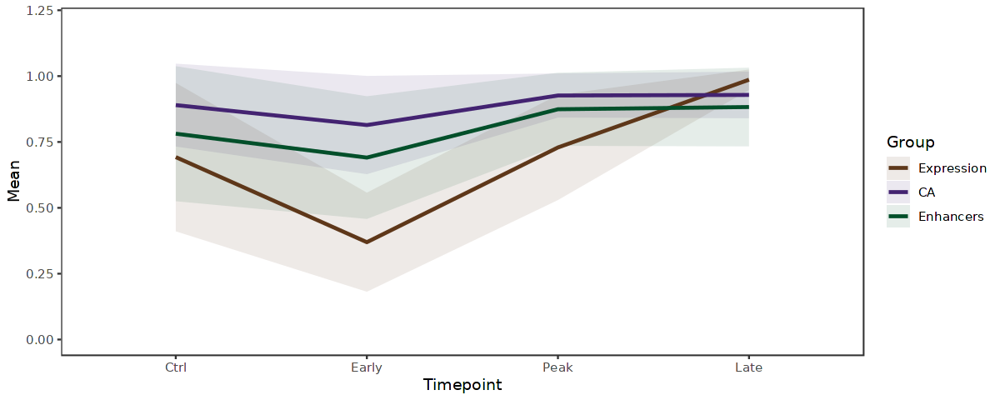

In [220]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.5 Sub category 1

In [221]:
gene_list <- c("Osbpl1a","Nnat","Ccdc15","Tyro3","Gm26747","Gm44866","Slc25a27","Crnde","Fosb","Abhd12","Ctsk","Pde5a","Pdk1","Ddah2","Tnfrsf21","Cd300e","Klf11","Hoxa7","Esrrg","Pdlim2","Btd","Anxa5","Deptor","Sort1","Lypd6","Fam117a","Micall2","Mylip","Gpsm1","Orc1","Cenpm","Fahd2a","Hist2h3c2","Slc34a3","Evi5l","4930419G24Rik","Ccdc82","Mfsd13b","Mlc1","Ramp1","Adamts20","Cnksr2","Arid3b","Thbs3","Scel","Gm50013","Gm15886","Tsc22d1","Rab11fip4os1","Cep72","Pmm1","Hs3st1","Ypel1","Enpp1","Gm45479","4932443L11Rik","Pbx3","Lims2","1700094J05Rik","Col9a1","Rccd1","Rwdd3","Ankub1","Jade1","Slc25a18","Tubb2a","B230323A14Rik","Ddb2","Sema4d","Sccpdh","Col9a2","Gm44992","Mpped2","Abca6","Tmeff1","Dlk2","Fsd1","Depdc1b","Epha4","Wls","Gm37459","Zcchc18","Pde4a","Itih3","Masp1","Hacl1","Nppc","Gramd4","Acer2","Rybp","Galnt6os","Gm36278","Ccdc148","A930017K11Rik","Zfp462","Cntfr","Slc7a15","Spock3","Acly","Anxa7","Tbc1d16","Tagln","Gm26759","Gm30613","Gls2","Acsbg1","Clgn","Srsf12","Coro2b","E530011L22Rik","Jph4","Ttll3","Fibin","Supt3","Kcnab1","Vegfb","5330438D12Rik","Sgk2","Lrrc31","Srrd","Slc25a23","Gria4","Lypd6b","Tmem169","Lrrc36","Gm48765","4930426I24Rik","Pdzrn3","Cdh8","Efemp2","9530051G07Rik","Nudt8","Hmmr","Golim4","Iffo1","Tspan7","Aph1b","Gm50232","Folh1","Nipa1","Prtg","Slc1a5","Cipc","Cobl","Adam18","Gm38948","Nek8","Pard6g","Pld2","H1fx","Rasgef1b","Gm37768","Grm3","Rbm11","Adamts2","Wdr17","Ldhb","4921504A21Rik","Slc25a53","Mroh3","Aif1l","Scg5","Mblac2","Nol4l","Slc22a17","Tmtc4","Npb","Anapc2","7630403G23Rik","Gm16000","Clrn1","Slc5a11","Gna12","Bphl","Zc3h8","Gm29361","Kctd16","Sowaha","Ccng2")

In [223]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [225]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [226]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [227]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [228]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [229]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

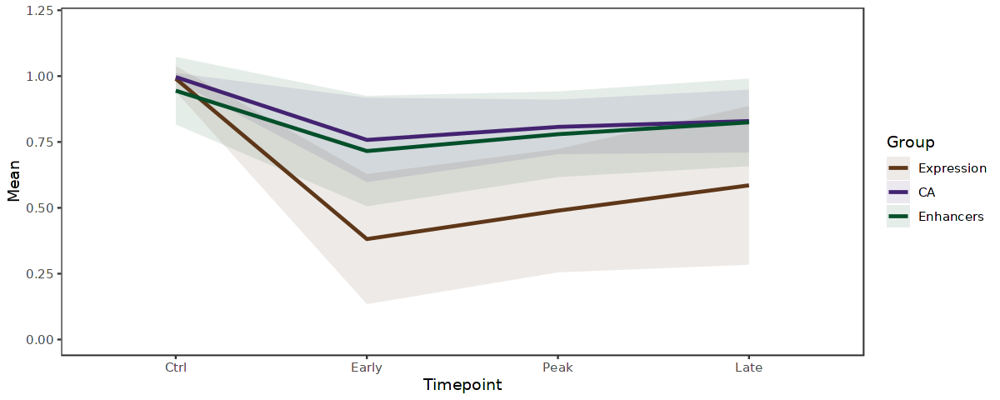

In [230]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.6 Sub category 2

In [231]:
gene_list <- c("Gm28379","Gm43376","Letm2","Armcx1","Pkd1l3","Esrra","Unc13b","Pls1","Sorcs3","Naalad2","Fdxr","Kif21b","Chdh","Klf10","Ly6g6f","Wfdc18","Mia","1700015F17Rik","Gm11457","Tub","Vangl1","Rmnd1","Stard4","Serp2","Apex1","H6pd","Shc4","Gm12758","Armcx2","Cacna2d4","Mfsd4a","Gm37756","Ankrd9","Dnajb2","Cox6a2","Gm26660","Plekhf2","Gm11149","Gm17036")

In [232]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [233]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [234]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [235]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [236]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [237]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

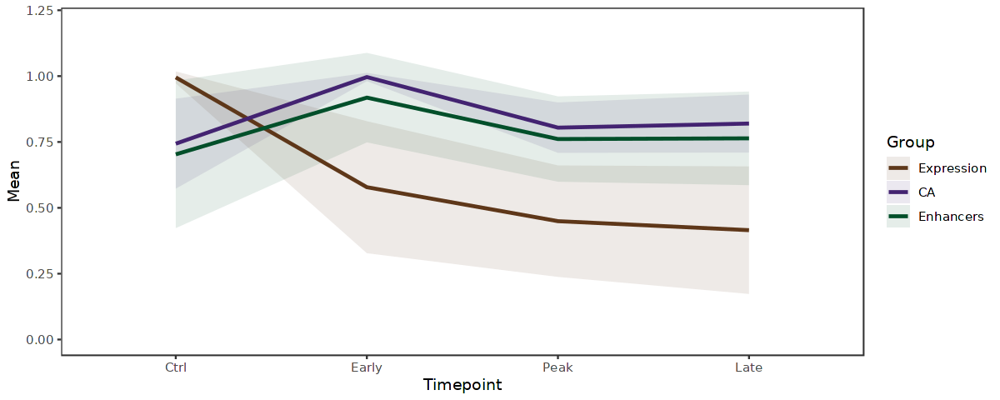

In [238]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.7 Sub category 3

In [239]:
gene_list <- c("Tmem81","Cd300lf","Cmtm7","Zfp839","Fam234a","Dipk1a","Chst8","Rgsl1","Cd55","Nipal3","3010001F23Rik","Ephb2","Stmn3","Gpr176","Tspyl4","Adam22","Adgrb3","Zfp395","Lingo2","Gm37494","Htr2b","Gm4876","Rdh9","Msrb3","5033421B08Rik","Mef2c","Gm16054","Art3","Adarb1","Irak2","Celf2","Ly6g6d","Nebl","4930405A10Rik","Zfhx2os","2210411M09Rik","Grhpr","Gm5441","Snap25","Mfge8","Plp2","Lrat","4930593A02Rik","Mgst3","Gm15764","Sema4a","Casp1","Mgll","Frem2","Gpr137b","Gm37229","Gm9934","Adarb2","4930513D17Rik","Bcas1os2","Gm20631","4933424G05Rik","Gm816","Rora","Syne1","Itpkb","Rnase4","Reln","Tuba1a","Uchl1","Akip1","Kif5a","1110019D14Rik","Filip1","Msi1","Nkx2-9","Rcor2","Frzb","Rapgef4","Serpind1","Gm5089","C030029H02Rik","Slc12a4","Atp13a4","Prdm1","Slc4a4","Gdpd1","A230001M10Rik","6720489N17Rik","Zkscan16","Gm31718","A330008L17Rik","1810010H24Rik","Usp29","C1qc","Spint2","Fcho1","Gm16168","Mfsd4b1","Gm48370","Retn","Sh2d3c","Atcay","Nme5","Pygb","Plekha7","Bace2","Gm15414","Dcdc2a","Kif26b","Fam20c","Gabra2","Kif7","A930024E05Rik","Gm34590","Pdk2","Gm41492","1110046J04Rik","Cd83","A930006I01Rik","Slc9a3r1","Mgat4c","Tnfrsf11a","Aass","Ccdc88c","Hist1h2be","Pacc1","Ntsr2","Tifa","Creg2","Zswim9","Fam181b","Tmem216","Pla2g7","Rida","C230037L18Rik","Luzp2","Fam3c","Rnaset2b","Ncs1","Gm36849","Gm17491","Cavin4","Cux2","Mmp15","Fry","Ndn","Gm35696","Ptpn18","Usp13","Cyp27a1","Col11a2","Ripk4","Cbs","Fam173a","Ranbp17","Ccdc85a","Gm15657","Shld3","Cntnap2","Prrg1","Gm47371","Gjb2","Crip1","Uevld","Mettl7a1","Abcb9","Kcnn3","Nid1","Vmn2r57","Mex3b","Acsf3","Inka1","Sept6","Maf","Nqo1","Vmn2r87","Trim36","Gm3764","Shroom1","2700046A07Rik","Adra1b","9330175M20Rik","Tenm2","Macrod1","Mtmr14","P2ry14","Chn1","Epha10","Suclg2","Kcnip3","Adam1a","Crybb1","Tubb2b","Fn3k","Ephb1","Gm16212","Gm43848","Hist1h1e","Slc9b2","Gm48740","Samd12","Hopx","Kcna2","Sspn","Hist1h4d","Gm48508","Gm28085","Evl","S100b","4930471L23Rik","Car5b","Gm48342","Wdr72","Hhip","Map2k6","Sirt5","9330117O12Rik","4930511M06Rik","Lurap1","Gm45338","Rdm1","Ppm1f","Plch2","Gm32036","1700087I21Rik","Ceacam1","Ccdc30","Aldh2","Gm13708","Myh7b","Gm11437","Slc45a3","9530034E10Rik","Serpinh1","4930469K13Rik","Atp2b2","Tex52","Gm15347","Dnaja4","Dynlt1a","Cryzl2","Gm48742","Shisa8")

In [240]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [241]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [242]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [243]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [244]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [245]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

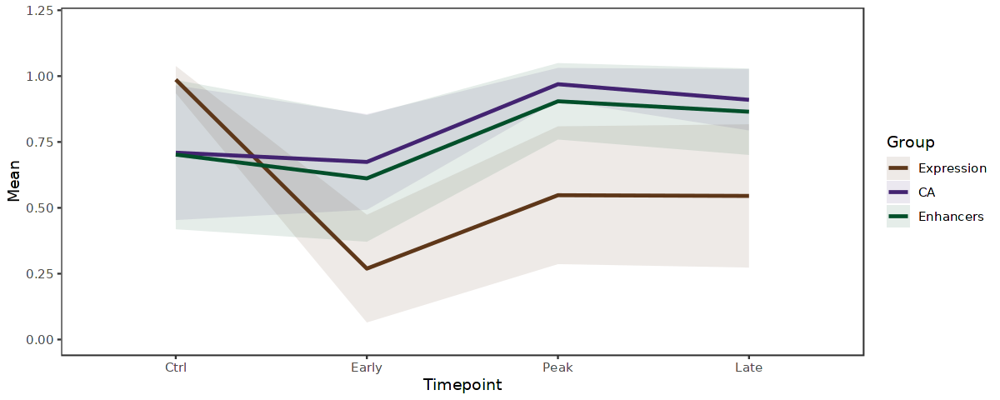

In [246]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.8 Sub category 4

In [247]:
gene_list <- c("Ccdc24","Gm48371","Gm33948","Stmn1","Pdcd4","Car7","Ift140","2610206C17Rik","Izumo4","Oser1","Dbil5","Zkscan8","Ppcdc","Pcsk6","Shroom2","Appl2","Gpc5","2810468N07Rik","Pou2f2","Ttc39c","Hspg2","Gmnn","Isca1","Pacsin3","Rbks","Gm15672","Gnai1","Chst12","Wnt5b","Bcorl1","Nkd1","Nat8f1","Golt1b","Npc1","Snx32","Spg20","Afap1","1700066M21Rik","Mvd","B430010I23Rik","Coro7","Relb","Tmx4","Brca1","Hebp1","Cry2","Gpsm2","Gm10827","Pigp","Dgkz","Cep83os","Scamp5","Gjc2","Kctd4","Timp2","Gm10687","Dbp","Gng8","Ankrd44","Adcy9","Gm49012","Bloc1s5","Prxl2a","Itgb4","Lrrc1","Tmem14a","Cat","Maged2","Rfx2","Epn2","2310022B05Rik","Fgd3","Plekhh1","Nfe2l2","Ice2","Sox8","Bfsp2","Jazf1","Rasl11b","Itm2c","Tmem246","Trib3","Scrn1","Pik3c2b","Zc2hc1a","Pnrc1","Mycbp","Gm31152","Ypel2","Cmtm5","Enpp6","Depdc7","Tet1","Tmem143","Dscam","Gm26531","Polq","Mcam","Cdh11","Ilvbl","Gen1","Papss1","Qpct","Arsg","Slc25a42","Gca","Gas2","Efcab2","Stard5","Gm36608","Utp14b","Amdhd2","Commd10","Rdh12","Kiz","Gm15853","Siae","Fam228b","Fbxo17","Slc25a29","Chn2","Gm49519","Ang","Gm42413","1700029J07Rik","Mtus1","Gipc1","Tmem106c","Efcab5","Igsf8","Glod4","Naglu","Xrcc3","Spata24","Serpinb1a","Stau2","Dnajc6","Sel1l3","Rap1gap","Tmem163","Gm38560","Rab7b","Fads1","Gm50399","Tst","Mpv17l","Gm49042","Acy3","Plat","Hilpda","Kif6","Ctnnal1","Btbd8","Grk5","Cep70","Lpar1","Prkca","Pigz","Bahcc1","Cep112","Stk10","Mapre2","Gm12367","C630043F03Rik","Hsd17b7","Arhgef28","Pcx","Kif3a","E230016M11Rik","Gm26542","Lig1","Rims1","Trim13","Pacrg","Nr4a1","Tmem255a","Aspa","Smpdl3a","Slc35e1","Rfc5","Gnb4","Sh2b3","Agbl3","Kctd10","Tes","Gm26618","Lekr1","Ap2a1","Zfp503","Ppip5k2")

In [248]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [249]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [250]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [251]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [252]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [253]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

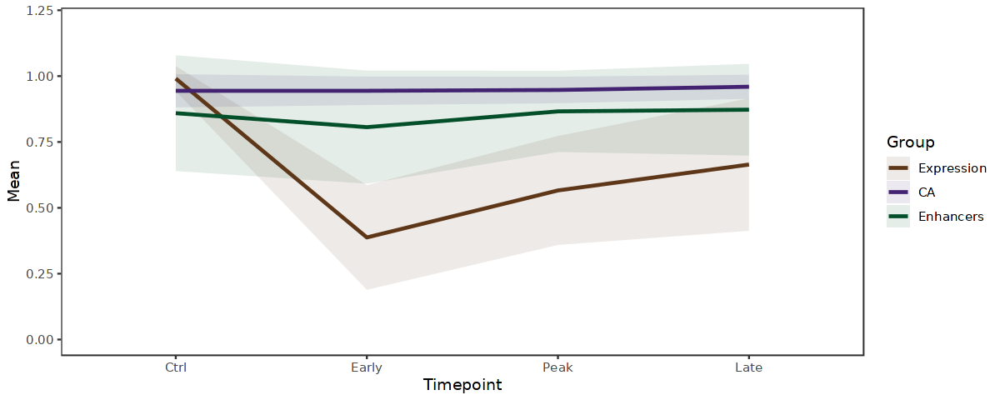

In [254]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.9 Sub category 5

In [255]:
gene_list <- c("Defb47","Ctsc","Timp1","Igfbp2","Bex2","Oaz3","Tnfsf9","Pgf","Pigo","Angptl1","Rpl24","Irak1","B3gat2","Stk16","Gtpbp4","Lbh","Rpl30","H2afx","Snrpe","Romo1","Mrpl4","Srsf2","Cycs","Txnl4a","Zfp692","Rrp8","Surf2","Dhcr7","Gm47283","Tenm3","Gm34868","Cct6a","Rpl7l1","Gm20319","Hist2h2aa1","Noa1","Ndufa12","Wdr75","Gadd45g","Cacybp","Rpl9","Rpl4","Dancr","Lsm8","Prpf31","Mrpl54","Acbd4","Serpine2","Kdelr2","C1qbp","Tsfm","2410004B18Rik","Timm23","Usp50","C1ql3","Rplp2","Wdr55","Ilf2","Rps20","Rpl29","Rpl41","Rnf126","Rcc2","Elof1","Lrrc59","5430416N02Rik","Lyar","Grpel1","Ptges3","Cdk11b","Rpl22","Ddx24","Nip7","Tbc1d10a","Epas1","Tmem258","Rbmxl1","Mitd1","Acat2","Nsun2","Cyp51","Pmvk","AI506816","Gas5","Phf5a","Rrp9","Prex1","Tmem97","Lsm12","Mak16","Fgfrl1","Kat2a","Polr3d","Clptm1l","Rps19bp1","Mphosph10","Eef1akmt4","Gm38335","Ipo5","Psme3","Alyref","Rps23","Grwd1","Lrrtm2","Pomp","Mdn1","Camk2n2","Shfl","4930599N23Rik","Kri1","Ctdnep1","Uqcrq","Rpl12","Gnl2","Elp5","Ydjc","BC003965","Rpf2","Tbcc","Rpl21","Gas2l1","Ftsj3","Lamtor1","Nhp2","Wdr4","Emc6","Usp19","Slc38a2","Sppl2b","Pgk1","Cdc42se1","Rpl17","Gm26533","Srsf9","Sertad1","Rangrf","Gps1","Taf1d","Ccl2","Baalc","Abracl","Ccnd2","Slc7a10","Gm26672","Slc24a5","Nphs1","Aqp4","Hspb1","Ttc9","Rab33a","Pus3","Grsf1","Eif2ak2","Msantd4","Ifitm3","Adamts1","Ppan","Polr1e","Nop58","Cthrc1","Gemin5","Tomm22","Tgfbi","Hgh1","Rpl8","Gpn2","G6pc3","Med7","Lyn","Mpp6","Nras","Rps25","Nop9","Rps26","Mrpl41","1810009A15Rik","Mrpl30","Rps28","Lmo2","Snhg3","Higd1a","Atad3a","Commd2","Ddx27","Gap43","Alg3","Trmt61a","Nkrf","Dynlt1f","Ebna1bp2","Tmed9","Uba52","Nle1","Idh3b","Noc2l","Bccip","Brix1","Rpgrip1","Gm17300","Agt","Bola3","Tsr1","Ccdc137","Sco2","Wdr74","Sigmar1","Abcg2","Gars","Gm10563","Rps27","2310058D17Rik","Inhbb","Pabpc4","Bak1","Maml2","Atic","Enkd1","Pfn1","Nars","Slc25a5","Eef1d","Lonrf1","Pum3","Ndufaf8","Tomm6","Rpl36al","Rpl31","Kbtbd11","B4galt5","Baz1a","Nup153","Rpl18a","Mettl23","Atp8a2","Gm3435","Gm16316","Gm32568","Gm47898","Gm37165","Unc13a","Ivns1abp","Cfap298","Snu13","Dcp2","Tex261","Sac3d1","Mettl1","Ddx39b","Rsl1d1","Rps2","Rce1","Timm50","Ptprn2","Gm16175","Gm17089","Tpt1","Ppie","Tbrg4","Telo2","Dus4l","Rps14","Ak6","Eif2b1","Rps27l","B9d2","Rps13","Nav2","Gm10701","mt-Nd1","Stk19","Cmtm6","Ddx21","Timp3","1110038F14Rik","Eif3b","Dbt","Leng9","Arhgef40","Nifk","Rpl32","Rps6","Exosc3","Ptges2","Kti12","Rsl24d1","Mrpl12","Strip2","Hs2st1","Ciao2b","Vcan","Sqle","Wdr46","Psme2","Pikfyve","Gm26519","Pdpn","Tcf7l2","Cdk14","Gm32856","Gpr137c","H3f3a","Arpc1a","Mrps22","Fads2","Nfkbia","Pcdh17","Id1","Casp7","Bhlhe40","Ccng1","Rtcb","Esf1","Samhd1","Tmem160","Slc7a1","Yrdc","Upf1","Actr1b","Med22","Rack1","Rpl7","Twistnb","Mcfd2","Rplp1","Polr2k","Ccdc134","Rrs1","Znhit3","Tmsb10","Gcsh","Ltv1","Mrps27","Btf3","0610009E02Rik","Strap","Rpl27a","2810004N23Rik","Dph3","Mrpl49","Arpc5l","Kars","Psmd12","Utp14a","Prelid3b","Clba1","AC160336.1","Trmt1","Nudc","Dalrd3","Smndc1","Eif3i","Chchd4","Prmt5","Rpl10","Eef1g","Elovl1","Dpm2","Polr1d","Rps15","Ddx39","Parp3","Cebpz","Daxx","Rnps1","Arid5a","Ralgds","Cebpd","Mrm1","Eml4","1600010M07Rik","Cgas","Nrxn1","Map3k20","Sharpin","Sox5os4","Adgrg2","Rpl27","Abcf2","Tmem208","Nfkbib","Brd3os","Gm36816","Gm10602","Rpsa","Mrpl52","Ripk2","Srrt","Snhg4","Mdh2","Exosc1","Rpl23","Rnf122","Cct3","Hspa5","Rpl23a","Bcs1l","Gm28221","Mrm3","Insyn2a","Cavin2","Rps16","Rps5","1700126G02Rik","Gm16068","Car10","Gm42047","Nudcd2","Ubqln4","2410006H16Rik")

In [256]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [257]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [258]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [259]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [260]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [261]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

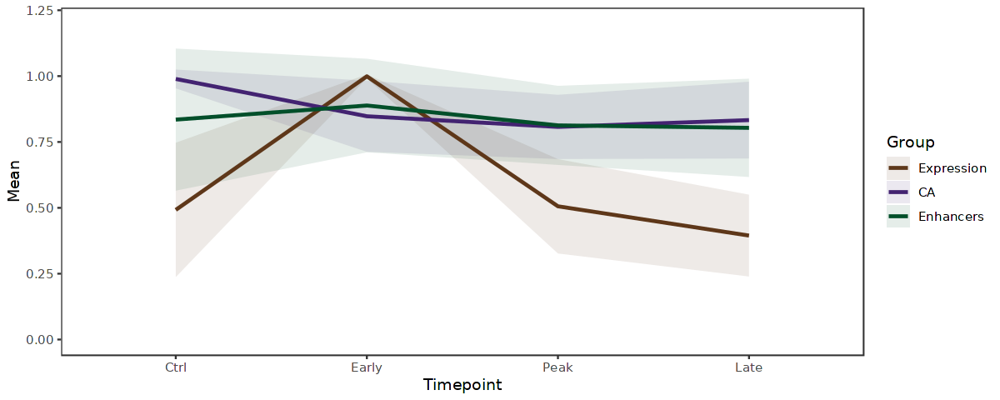

In [262]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.10 Sub category 6

In [263]:
gene_list <- c("Synpr","Btbd16","Pde3b","Csrnp1","Ecm1","Cntn1","Chl1","Stx1b","Tnfrsf12a","Rgs17","Atf3","Spout1","ccdc198","Fosl1","Il33","Dph5","Tfdp1","Neb","C1ql2","Gsap","Gpr151","Scg3","Fgl2","Ido2","Cdkn1a","Tagln2","1110038B12Rik","Sema3e","Gfra1","Rgcc","Cers6","Igf2bp3","Pcnx","Tmod2","Cebpa","Kctd11","Gm19744","Kdm6b","Gm19935","Tepsin","Emp3","Amotl1","Gm14798","Gm10791","Etv6","Pgs1","Hmga1","Arhgap24","Midn","Rps6ka3","Steap3","Dtna","Ucn2","Casp4","Slfn9","Isg15","Dnttip1","Fchsd2","Sphk1","Cpne8","Mvp","Cacng5","Rnf125","Becn1","Clec2d","Cntd1","Sv2c","Ophn1","Lrtm2","Upp1","Gm3448","Kcnk2","Igf2bp2","Helz2","Slc9a3r2","Asb13","Lysmd2","Psme1","Nab2","Gm16223","Rpl9-ps6","Kcnk10","Folr2","Ldha","Brinp1","Kit","4933406I18Rik","Ric3","Gm20470","Snhg16","Ptpn5","Axl","Rnf213","Ermard","Rgs20","Tubb6","Nrcam","Osmr","Sec61g","Pkig","Cldn11","Gm28370","Crybg1","Gm48708","Dclk2","Maff","Gpatch4","Surf6","Pros1","Slc35f5","Fga","Syne2","Cyp2j9","Sdf2l1","Mafk","Add3","Rdh5","Heatr1","Nradd","Akr1b8","Gdf11","Rchy1","Pop5","Cd200","Pdrg1","Rassf4","Selenow","Dusp7","Znfx1","Fdft1","Setd6","I730030J21Rik","Gm16069","Gm15518","C1qtnf1","Baiap2","Tuba1b","Mat2a","Arpc1b","Nr2c2ap","Bcl3","Nubp1","Arrdc4","Fdps","Nap1l1","Laptm4a","Rab34","Mapk14","Rmdn3","Gadd45b","Pou6f1","Cic","Egr2","Sorcs2","Zrsr2","Tcerg1","Odc1","Ogfr","Zfp36","Rps10","Atp5e","Cd63","Qrsl1","2700038G22Rik","Znrd1","Snhg6","Socs3","Dkc1","Prorsd1","Srxn1","Rrp1b","Bzw2","Sdad1","Mt1","C230035I16Rik","9530082P21Rik","Gpx1","Tubb3","Akap12","Idnk","Soga3","Pdxk","Ascc3","Rnf217","Atp6v1h","Chic2","Bmp1","Cd151","Gm12530","Snhg17","Fbxo27","Socs2","Lypla2","Trmt61b","Rps15a","Ebp","Lyve1","Nudt9","Rbm3","Pi4k2a","Rps12","Ube2v1","Clic4","Psmb10","Rpl13","Pfdn4","Fam216a","Ccnd1","Lsm2","Nampt","Pin4","Kpnb1","C78859","Wsb2","Acd","Rexo2","Manf","Ngdn","Polr2h","Eif5a","Pdcd5","Timm8a1","Creld2","Eif1a","Plod3","Iffo2","Ranbp1","Cdk4","Mbd3","Ptbp1","Gm42917","Gm15601","Gm17494","Ran","Idh3a","Nme2","Nubp2","Btg2","Calr","Ctu2","Trmt6","Prmt1","Lsm4","Txn2","Tomm40l","Rps8","Tma16","Nolc1","Jcad","Map2k3os","Rab26os","Rnf225","Cltb","Cstb","Psmd3","Lmna","Nod1","Grik3","Crem","Metrnl","Tapbp","Myd88","Aasdhppt","Pcbp3","Peak1","4921516A02Rik","Rps29","Wdr43","Nop2","Map2k1","Gpd1","Tmem243","Ndufv2","Phlda3","Gm26788","Syncrip","Il4ra","Ak2","Mob3c","Etv1","Unc79","Tspo","Polr2f","Kcnmb4","Adar","Nsdhl","Ncoa2","Cdh24","Gm26797","Gm4117","Slc45a4","Anks1b","Grik2","9530059O14Rik","Irf2","Pou3f1","Clcf1","Larp1","Rpl5","Rps17","Anp32b","Slc25a22","N4bp1","Ccne2","Stat2","Endod1","Npm3","Hnrnpd","Tomm40","Ssr4","Cad","Spryd4","Rpl10a","Zfp428","Abhd11","Lsm7","Banf1","Rpl37","Rab5if","Fdx2","Utp11","Rab11fip5","Sat1","Pdap1","Tmem147","Tmem88b","Frmd4a","Tent4a","Tars","Brd2","Ada","Zfp207","Nop16","Relt","Yae1d1","Fubp1","1700123O20Rik","Rps3","Wdr89","Tsc22d4","Pcyox1l","Yars","March5","Pqlc1","Sox2","Btg3","Atf4","Lmo4","H3f3b","Pwp2","Gm44777","Eef1akmt1","Insig1","Pcgf5","Tsr3","Zfp593","Fkbp1a","Hnrnpa1","Sc5d","Eif5b","Rpl6","Timm10","Rasip1","Sbno2","Bend6","Egr1","Naa25","Trf","Pcyt2","Xaf1","Msmo1","Cdk6","Syvn1","Pvr","Scfd2","Rtkn","Atp5md","Nrap","Id3","Hspe1","Hspd1","Arf4","Emd","Atp5g1","Chpf","Plscr3","Lmnb2","Cdkn2d","Mrps18b","Taf1c","Ncl","Rhoj","Cfl2","Acod1","Mcub","Gm36043","Rps19","Pithd1","Hmgn1","Zmym1","Arfip2","Taf10","Prr11","Fam136a","Nlgn2","Myc","Lss","Gmppb","Serbp1","Zdhhc13","Zfp281","Selenom","A630089N07Rik","Fndc4","Tnc","8030451A03Rik","Ltbr","Cgref1","Arhgef12","Ldlr","Ier2","Nup210l","Rnf135","Manbal","Il1rap","Gfap","Nfkbiz","Cadps","Antxr1","Cab39l","Ptprj","Gm12940","Vars","Btc","Pvt1","Inpp4a","Slc39a1","Rps27a","Gale","Arap2","Slc7a14","Trib1","Pa2g4","Phb","Ears2","Col16a1","Sec61a1","Trmt112","Impdh2","Ttyh1","Hsph1","Tnni1")

In [264]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [265]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [266]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [267]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [268]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [269]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

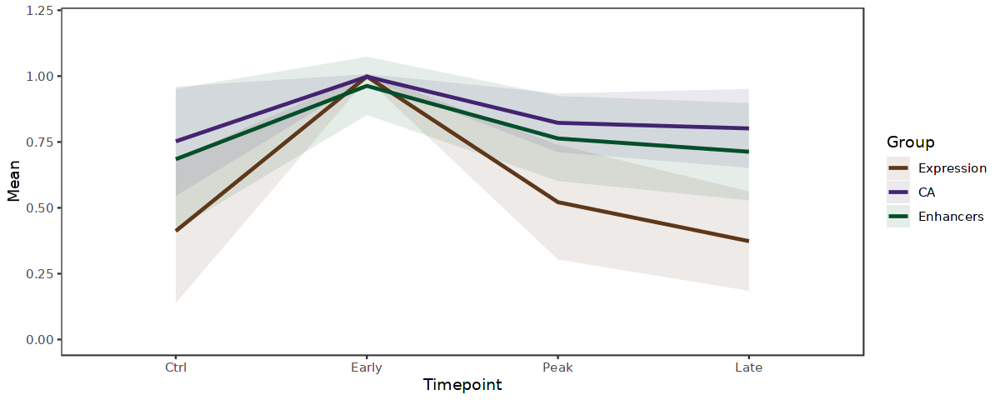

In [270]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.11 Sub category 7

In [271]:
gene_list <- c("Erh","Srsf10","Nop56","Pus7l","Gnb2","Gtpbp6","Rps18","Wars","Ybx1","Rpl18","Cd3eap","Rpl38","Txndc11","Rnf139","Map2k3","Ostc","Ctps","Ccdc124","Arf6","Hnrnpab","Zpr1","Snrpa1","Gm15559","Zfas1","Epb41l4aos","Cybc1","Mrps5","Rplp0","Snhg1","Trmt10c","Nob1","Rrp7a","Rpl22l1","Sub1","Rpl34","Usp36","Eef1e1","N6amt1","Pfdn2","Pusl1","Rpl36","Jagn1","Fau","Noc4l","Pak1ip1","Rpl7a","Pes1","Emg1","Nme1","Mecr","Phb2","Wdr38","Pim1","Ubash3b","Irf2bpl","Pigf","Ctu1","Pim3","Eif2s1","Cggbp1","Ndufaf4","Gjb1","Sf3b4","Gnl3","Ywhab","Timeless","Idi1","Gm38251","Gm43118","Dph2","Ppid","Ddx49","Srsf6","Sra1","Rps3a1","Mcl1","Dis3","Tomm7","Phykpl","Fbl","Rwdd1","Isg20l2","Rangap1","Btg1","Eef1b2","Abce1","E2f4","Jun","Slc25a3","Taf7","Rev1","Wdr77","Gar1","Rabggtb","Rpl19","Upf3a","Nt5c3b","Noct","A930037H05Rik","Ufm1","Dus3l","Bms1","Slc3a2","Brip1","Rpl28","Ppp1cc","Gemin6","Exosc2","Ddost","Eif2s2","Pml","Cyp20a1","Rps7","Rpl35a","Snrpf","Hist1h4h","Chmp4b","Hint1","Mars","Rpl11","Nat14","Pdss1","Cdc14a","Nfyb","Utp20","Nop14","Hap1","Atp1b2","AC156546.1","Gm16982","Map3k1","Ptpn1","Dhcr24","Rpl37a","Acsl3","Scd1","Ap1s1","Selenos","Ppm1e","Rps4x","Rab21","Rps9","3110082I17Rik","Slc31a2","Fhod3","Naca","Snhg5","Naa50","Eef1a1","Ninj1","Hnrnpf","Srpr","Ruvbl2","Ddx54","Mybbp1a","Hnrnpa2b1","Timmdc1","Srp9","Dbi","Azi2","Il6st","Ahctf1","Slc35a4","Slc35b1","Lpo","Pabpc1","Tox2","Sfxn2","Cdv3","1110008P14Rik","Eif4a1","2410002F23Rik","Batf2","Dtymk","Set","Cluh","Gm17108","Ormdl2","Aen","Rps11","Srm","Dad1","Mrto4","Snrpd3","Ntmt1","Taf5l","Dohh","Rps21","Bola2","Slc1a4","Taf4b","Dnph1","Atad1","Src","Txnrd1","Jmjd6","Xbp1","Hmgcr","Pdcd11","Hmgcs1","Notch1","Rpl15","Dnajb5","Snhg8","Eef2kmt","Arid5b","Rbl1","Rnf19b","Srrm3","Carmil1","4933412E12Rik","Psmb5","Fen1","Ccdc73","Ppil1","Ube2cbp","Thg1l","Med8","Mchr1","1810055G02Rik","Mrps23","Psmg4","Rps24","Prmt7","Polr1c","Cct2","Polr3h","Bop1","Cdk2ap1","Ifrd1","Ppa1","Srsf7","Agpat5","Nol12","Wsb1","Ccdc115","Noc3l","Ythdf2","Imp4","Psmc4","Timm9","Ndst1","Mfsd12","Lsm6","Dda1","G3bp1","Atp5g2","Ccdc86","Snrpg","Llph","Dus1l","Ddx51","Prelid1","Rpl14","Mier2","Ssr2","Pus1","Med10","Ctxn1","Fmn2","AA467197","Ccdc25","Lnx1","Spry1","Cox7b","Spry2","Galntl6","Polr1a","Hddc2","Tmem42","Klhl29","Mfsd10","Ddx18","Daglb","Tent5a","Gm47167","4930452G13Rik","Slc39a10","Gm20721","Mov10","Ddx58","1700001K23Rik","Fcf1","Angptl4","Wdr83os","Nudt19","Polr2l","Tasor2","Nmi","Gsta4","Ubxn8","Sox5","Gm41505","Adsl","Ybx3","Dnajc2","Fastkd1","Rrp15","Npff","Hypk","Dimt1","Ifrd2","Tex30","Eif1ad","Mob4","Eif3j1","Ipo4","Mrpl15","Psma7","Flot1","Mrpl20","Rrp12","Snrpd1","Eif6","Eif3k","Rab5c","Fosl2","Cox5a","Rpl39","Krtcap2","Il17ra","Mrps26","Rars","Snx10","Pno1","4930453N24Rik","Bud23","4930579G18Rik","Gm49066","Bax","Mrpl32","Cbarp","Cep126","Rpl36a","Snhg12","Smyd5","Dnajb11","Ggct","Cct8","Rpl26","Utp4","Mrfap1","Zfp511","Znhit6","Psma4","Slc38a1","Bysl","Npm1","Tmem251","Rpl13a","Spink10")

In [272]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [273]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [274]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [275]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [276]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [277]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

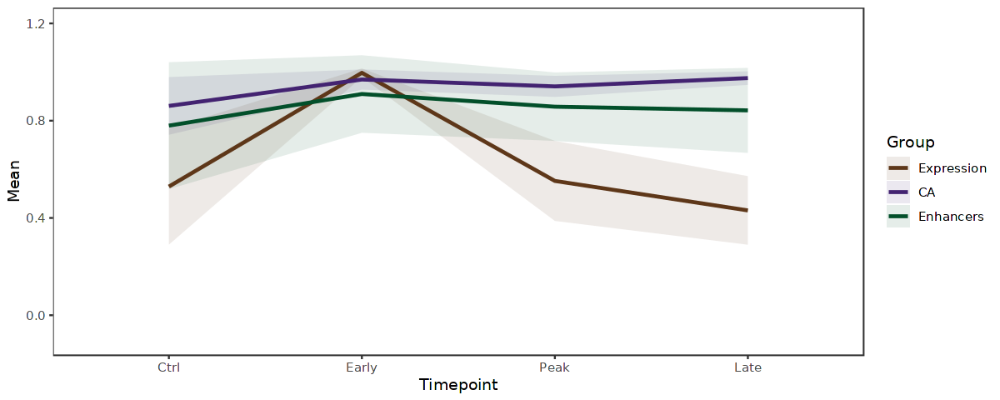

In [278]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.12 Sub category 8

In [279]:
gene_list <- c("Olfr1369-ps1","Isg20","Irf8","Rtp4","Ifit3","Mrgpra1","Ccl8","Phf11d","Gbp2","Rpl10-ps3","Serpina3f","Gjb6","Trim30d","Timp4","Ms4a4b","Rps27rt","Ifit1","Gm10076","Oas2","Usp18","Ifi35","Pdlim4","Pdzk1","Ccrl2","Asns","Aprt","Ppp5c","Ier5l","Gm26944","Irf1","Nlrc5","Pnpt1","Tut1","Zfp952","Osbpl10","Klhl32","Gm14164","Vgf","Tspan4","Arhgap28","Socs1","Ano3","Gbp3","Fam111a","Mlkl","Pde3a","Cd274","Apobec3","Irf7","Eif3j2","Zc3hav1","Eid2","Bst2","Stk32a","Serpine1","Papss2","Sdc3","Slc10a6","Acsl5","Slc6a20b","Igtp","Cmpk2","Psmb8","Trim21","Gbp5","Pik3r5","Herc6","Neto2","Gabbr2","Tor3a","Dtx3l","Irf9","Syt6","Il15ra","Trim25","Gm15283","Tnfrsf1a","Il12a","Ube2l6","Trim56","Mt2","C1ra","Parp14","Nsun5","Gm11361","Snhg15","Erg28","Znrd2","9030025P20Rik","Hmgn3","Gstm6","Parp9","Gm26749","Atp10a","Slc2a12","AW047730","Ifit3b","Pgghg","Lgals9","Cemip","Plce1","Slc14a1","Egln3","Aacs","Ier3","Tmem47","Tbc1d1","Mt3","Gm16537","Nmnat2","Sparcl1","Runx1","Igsf10","Rsad2","Wnk4","Tap2","Far2","A2m","Prr16","Dhx58","Slc35f4","Piwil4","Hk2","Ilrun","Susd6","Adgrl3","Nutf2-ps1","Plvap","H2-T22","Gm12216","Rbm43","Tapbpl","Ppp1r1a","Rnasel","Gpr22","Emc4","Tmem128","Inppl1","Ifih1","Plaur","Sp140","Cxcl10","Glis3","Acsl6","Igfbp3","Sez6l","Atp1a2","Lrfn2","Nim1k","Dgkh","Cldn10","Calhm2","Uchl4","Ndrg2","Slc1a2","Alpk1","Slc6a11","Nek6","Chil1","Klk9","Sdc4","Ddah1")

In [280]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [281]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [282]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [283]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [284]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [285]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

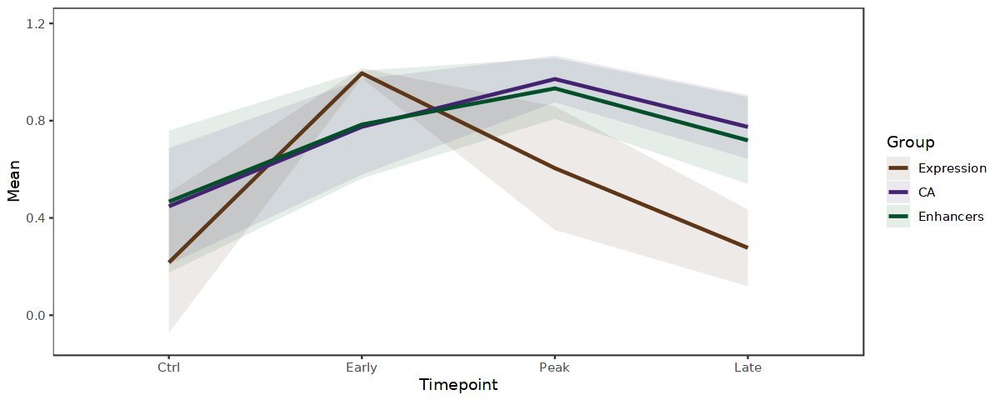

In [287]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.13 Sub category 9

In [288]:
gene_list <- c("Inhba","Hist1h1c","Stmnd1","Gpx3","Ctnnd2","Snhg18","Ccl5","Phtf1os","Pcdhb18","Saa3","Gm3235","Apoc2","Fhit","Hhatl","Snx22","Dab2","Tmem106a","Dll1","Fgf12","Clstn2","Morc4","Plpp6","Vmac","Vwa1","Sema3f","Aldh5a1","Stat1","Slc9a9","Actn1","Lncpint","Hist2h3c1","Pir","Chil3","Srgn","H2-DMa","Adm","Gsdma","Phka2","Gm42067","Cspg5","Avpi1")

In [289]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [290]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [291]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [292]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [293]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [294]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

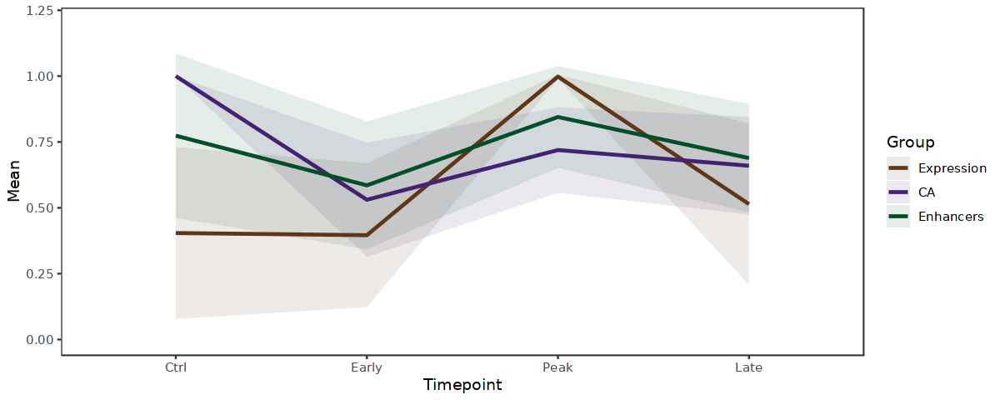

In [295]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.14 Sub category 10

In [296]:
gene_list <- c("Mc1r","Slc39a14","Gpr146","Htatip2","Phyhd1","Fxyd3","Tcim","Cd44","Gm16675","Slc4a11","Ifit2","Slc6a8","Zfand4","Mir22hg","Adam9","Hmga2","Vsir","Mfsd2a","Gm11772","Klf4","Galns","Rbfox1","Zbtb7b","Zfp703","Cpm","Parp11","Txn1","Gch1","Celf4","Plxnb2","Hspb2","Etv4","Plec","Spred3","Atf5","Kndc1","Lgals1","Gm46519","Nde1","B4galt6","Klf9","Cstad","Ehbp1","Fbxo36","Gdap1","Pdgfc","Sap30","Erap1","Pnpla2","Diras1","Sgk1","Capn5","Col5a3","Gbp10","Matn2","Pls3","Kcnb1","C2","Vim","Il12rb1","9330175E14Rik","Tubb4b","Blvrb","Dpy19l3","Tvp23a","Etv5","Myo1c","Arrb1","St3gal3","Zfp488","Pipox")

In [297]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [298]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [299]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [300]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [301]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [302]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

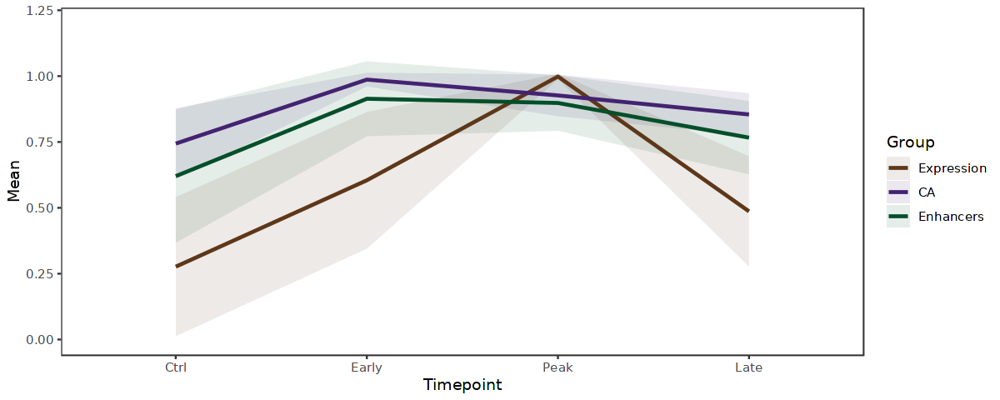

In [303]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.15 Sub category 11

In [304]:
gene_list <- c("Ifi27l2a","Cxcl14","Lyz2","Vav3","C1qb","Klk8","Them6","Ly6e","Garnl3","Tgtp2","Ccdc122","Gm12185","Ucp2","Parp10","Ifi44","Lrch1","Fam155a","Ly6a","Armc2","Casp12","Itpripl2","Plin2","Fam13a","Dglucy","Fbxo31","Gm7292","BE692007","Serpinb9","Cpe","Pknox2","Ttc12","Mcc","Nos1ap","AU020206","Olfr1124","Scml4","Tuba4a","Rsph9","Itpr1","Ddx60","Mrgpra9","Kcnj6","Gnaz","Cacna1h","Zfp385b","Patl2","Trim34a","Ms4a6c","Shroom4","Gbp6","Pdk4","Paqr6","Gm50237","Rgs1","S100a4","Olfr56","Cercam","Fcer1g","Maml3","Mpeg1","Pald1","Cyba","Me3","Greb1","Pbx1","Aldh3b1","Efhd2","Erp27","Aff2","Lgi4","Podxl","Spp1","Epb41l5","Tap1","Nupr1","Pomc","Crlf2","Gm44850","Pnpla7","AA388235","Agbl4","Oas1a","Serpina3i","Ifitm2","Mocos","Apol9b","Sult1a1","H2-M3","Pycard","Sez6","F830016B08Rik","Serpina3c","9530077C05Rik","Spock1","Tlr3","Gria3","Ccl6","Col1a2","Arhgap44","Slco5a1","Nap1l5","9930111J21Rik2","Rbp1","Hspb8","Mapk8ip2","Gm12326","Gm2245","Tle6","Gbp9","Wwc2","Itga9","Gm17135","Serping1","S100a11","Cntf","Gm4951","Trim30a","Gbp8","AW112010","Gabrb3","Il18bp","H2-DMb1","Aldoc","Gm15417","Clybl","Palm","Cebpb","Adamts9","Nol3","Kcnip4","Fam180a","Irgm2","Parp12","C1qa","S100a10","Pqlc3","Elavl4","Apol9a","Large1","Ciita","Herc3","Hrh2","H2-D1","Fam214a","Serpina3n","H2-Eb1","Vat1l","Lcp1","Psmb9","Fn1","2010300C02Rik","H2-Q6","Ptpre","Ly6c2","Trim47","Gm20559","Mtcl1","Esyt3","Lynx1","Lrp8","Iigp1","Scrg1","Ifi47","Oasl2","Gpr143","Sox4","Ctsh","Cdh13","Akr1b10","Serpina3g","H2-Q4","Trim5","H2-K1","Tmem140","Pdzrn4","Gpnmb","Crmp1","Cast","Aox1","Chst2","Lcn2","Clic1","Ntm","Zbp1","Gldn","B2m","H2-T23","Itgad","Nudt4","Abhd15","Hfe","Mgst2","Fxyd5","Ifit1bl2","Bcat1","S100a6","Mgp","Bmerb1","E230001N04Rik","Trim12c","Gm22146","Traf3","Olfm2","Vwa5a","Gm20536","Tmtc1","Gbp4","Fcgr2b","Dtnbos","Pmepa1","Stx3","Bid","Tcirg1","Dner","Mill2","Gm39469","Arrdc1","Mgst1","C530008M17Rik","Nrg1","Serpina3m","Arg1","Tyrobp","Tnfsf11","Dusp6","Wfdc17","Mrgpra6","Tstd3","Cd74","Serhl","Clca3a1","Pla2g3","Osbpl5","Copz2","Clic5","Cfb","Rab37","Agtrap","Apba2","BC028528","Gpc6","Syn2","Abcc4","Sdk1","B3galnt1","Fam107a","Kcnc3","Shisa5","Gm15243","Lgals3bp","Gm4841","Fyb","Hsd11b1","Eif4ebp1","Fuca2","Tom1l1","Trem2","2210408F21Rik","Mrgpra2b","Ighm","Fbxl7","Irgm1","Ly6c1","Cxcl9","Lgals3","Stat5b","Dync1i1","Gm35360","Snca","Gm19684","Gbp7","Shank2","Trim12a","Itga8","Gm5141","Ppl","Cdh22","Dera","H1f0","Samd9l","Moxd1","Il34","Ccdc149","Klf2","Thrsp","Enah","Gm8369","Rgs16","Gpr37l1","Gm41148","Gm49891","H2-T24","Tafa1","Ralgps2","Uba7","Dock2","Heg1","Barx2","Plin4","Bcan","Fam49a","Gm49890","Dennd5b","Tgtp1","Fap","H2-Q7","Gm28501","Smpd3","Itpr2","Slc44a2","H2-Aa")

In [305]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [306]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [307]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [308]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [309]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [310]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

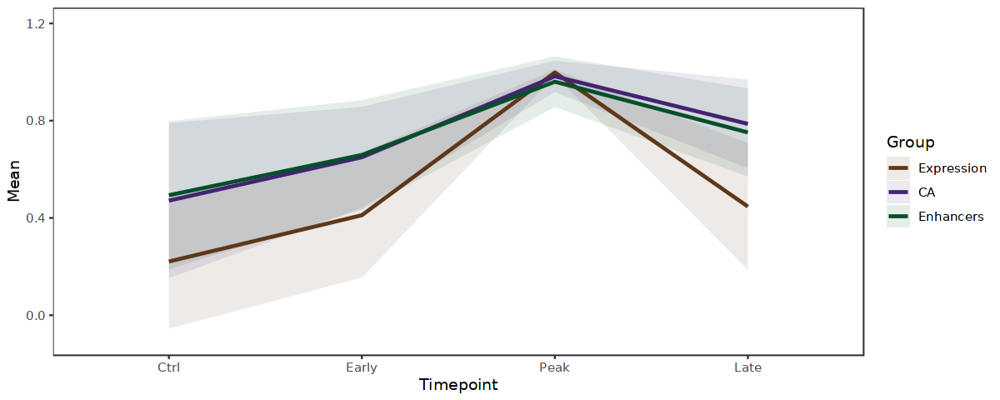

In [312]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.16 Sub category 12

In [313]:
gene_list <- c("Chchd10","Ttc26","Gm26854","2810029C07Rik","Ptms","Apln","Dtnb","6330411D24Rik","Cd38","Polr3e","Acot11","Nrtn","Lgals2","Slc16a3","Tgfbr3","Glrx","Gm4013","Abcd1","Il17rc","Junos","Nt5dc1","Itprid1","Emp1","Rragd","Col27a1","Rab3il1","Pih1d2","Pacsin1","Hmgcll1","Bdh1","Fjx1","Fbxo21","Fam83d","Myof","Sord","Prob1","Gm29642","Cadps2","Zfp995","Zfp469","Itpk1","Crlf1","Jade2","Slc30a1","Fam114a1","Rell1","Gm10785","Tfap2a","Trafd1","Ifi30","Otud7a","Mxd4","Pcdh1","Lin52","Apbb2","Mmp2","Fgfbp3","Crip2","H2-Ab1","Fsd1l","Uchl1os","Gm16183","Rnf144a","Rom1","Afap1l2","Grn","2610307P16Rik","Fbxo2","Aldh6a1","Atl1","Cpt1a","Pantr1","Gm48796","Cblb","Kremen1","Ramp2","Dap","Pbxip1","Gse1","Prkaa2","Sik1","Kcnma1","Fkbp14","Uap1l1","Nudt16","Thsd4","Slc25a13","Prkcd","St3gal5","Foxo1","Tenm4","Chst3","Gdpd5","Adcy5","Hunk","Nlgn3","Plxna1","Kif9")

In [314]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [315]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [316]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [317]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [318]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [319]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

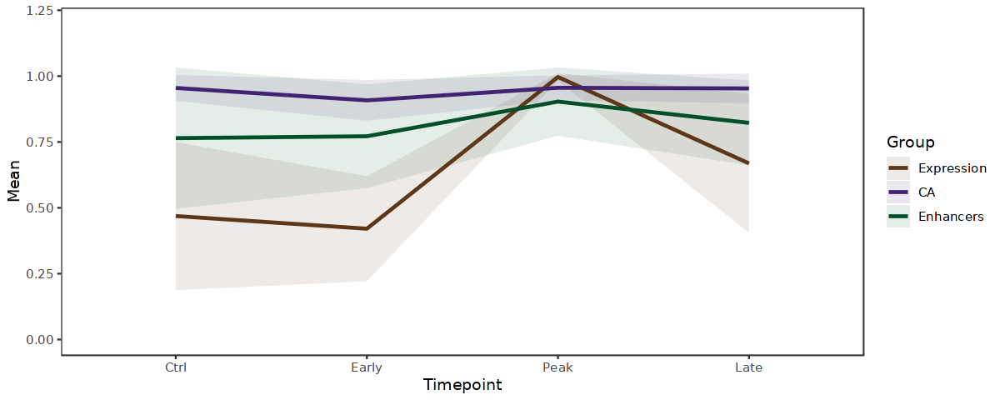

In [320]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.17 Sub category 13

In [321]:
gene_list <- c("Srgap3","Enox2","4930432K21Rik","Daam1","S100a1","A230057D06Rik","Gm4258","2510009E07Rik","Sqor","Clmn","G630055G22Rik","Bnip3l","Plxnb1","Kat6b","A330023F24Rik","Prima1","4933406C10Rik","Igsf3","St3gal6","Lrrc27","Usp11","Lyplal1","Mob3b","Slc15a4","Gkap1","Wdsub1","Gsta3","Ncam1","Gm34933","Mgat5b","Shcbp1l","Pde8a","Rsph10b","Map1b","Cnbd2","Tmc3","Ttc28","Uvssa","1500015L24Rik","Syt9","Ngfr","Pde10a","Sspo","Tppp3","Grik5","Tbc1d24","Gab1","Anks6","Nr1d2","Cdkl3","Ppm1h","Dscaml1","Pde11a","Hpcal1","Gm14320","Amy1","Scube3","Man1c1","Ptprn","Zmiz1os1","Cdkn1c","Manba","E330020D12Rik","Dzank1","Neat1","Trim59","Gm44899","Tmem117","Plekhg1","Lamp2","Rnf152","Gm40841","Pak1","Gm28941","Prickle3","Lipa","Ajap1","Vamp5","Tmem219","Gm45708","Mboat2","Gm38250","Rftn1","Fggy","Fbxl21","Cntln","Tns1","Zfand5","Vwa3b","Fam222a","Kank2","B230206L02Rik","Zdhhc14","1190005I06Rik","Gm14412","Psd2","Snx29","Ptprz1","Gng7","Defb42","Cdh20","Gm15943","Stpg1","Dach2","Egfem1","Fam102a","Shroom3","Gm29502","Ap3m2","Arl15","Gm43330","Xkr4","Gm39526","Tle2","Tln2","Mroh7","Gm29455","Plxna2","Zeb2","Lrmda","Gm34006","Eya4","Dock7","Gm28836","Rapgef5","Car14","AC241534.1","Zfhx3","Gm26935","Lpcat2","Etl4","Fntb","Acad10","Ano4","Prox2","Map1a","Pacs1","Nubpl","Cenpp","Gm15860","B230206H07Rik","Pak7","Pafah2","Synpo","Gm14966","Gas7","Gm16759","Gm36584","Tcte2","Spdya","Dyrk1b","Sybu","Lhpp","Apba1","Cyp39a1","Elovl7","T2","Fbxl20","Trp53bp2","Pik3cb","Glcci1","Plppr3","Tbc1d4","B3gat1","Tbc1d31","Abcd3","Gm39129","Vamp8","Grik4","Luc7l2","Poln","Ephx1","Pld1","Ugt8a","Gm46515","AI197445","Itgb3","Pkia","Gm43242","Ago4","C2cd2","Dgki","Pard3b","Cul7","Gm12324","Kcnu1","Slc8a1","Tbc1d32","Dzip1","Ak5","Dusp15","Bicd2","Fbxo32","Tspan9","Pik3r3","Rasl12","Podxl2","Sbk3","Bdkrb2","Per3","Zfp975","Phlpp1","Slc24a2","Teddm2","Rps6ka2","Kazn","Ccdc18","Cyfip2","Gpr158","Fbln7","Megf10","Gm4221","Stmn4","Cox6b2","Unc5c","Myrip","Pak3","Slain1","Klhdc1","Sypl","Haghl","Slc12a2","Atp11a","Cdk19","Fnbp1","Gm26881","Rad51b","Bbs9","Gm12743","Atp10b","Zfp169","Flrt1","Gm20754","Prrt1","Tmem132b","Slc35d2","Fam83b","Hscb","Gm43666","Asah2","Dusp8","Brca2","Efs","Tmod1","Ksr1","Gm7598","Thsd7a","Astn1","Gm32926","Gm41836","Gm41333","Epm2a","Pla2g4a","Ppfibp2","Aff3","Atxn1","Mtss1")

In [322]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [323]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [324]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [325]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [326]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [327]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

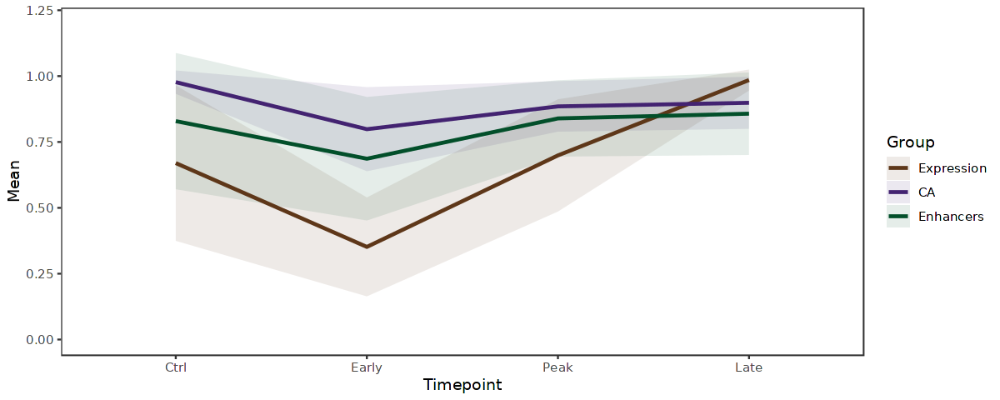

In [328]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.2.2.18 Sub category 14

In [329]:
gene_list <- c("Gatb","Plekha5","2210011C24Rik","D1Ertd622e","Rap1a","1700012D14Rik","Dtx4","Sorcs1","Rab30","Map3k5","Mthfs","Slit2","Cdk18","Peg13","Sugct","Lrrc4c","Plk3","Gas6","Klf13","Gm4924","Srcin1","Myh14","Atg10","Mkx","Dpysl5","Galnt18","Osbp2","Epb41l2","Rad51d","Edil3","Nck2","6030407O03Rik","Gm14634","Map7","Gm16083","Naaladl2","Notch2","Agmo","Retreg1","Cyth1","Kif16b","Dip2a","2010315B03Rik","Cbx7","Gm35438.1","Col6a1","Rere","Arhgef37","St6galnac3","Smad7","Mast4","Gm13483","Bckdha","St3gal4","Itk","Klhdc8a","Faah","Zfp808","D7Ertd443e","Rassf3","Ezh1","Cyp4f13","Arhgap12","Iqsec1","Gm16124","Pip4k2a","Arnt2","Dact3","Mir100hg","Gm12092","Myzap","Pcdh9","Sept9","Gm26843","2900052L18Rik","Renbp","Nr3c2","Lmo7","Psap","Ccdc191","Rassf8","F8","BC034090","Tpk1","Bcl7a","A330015K06Rik","Fam13c","Nr6a1","2700054A10Rik","5031434O11Rik","Gtdc1","Zfp467","Lima1","Cpeb2","Ccdc62","Zfp438","Usp48","Padi2","Tnxb","Trim7","Khdrbs3","Adam23","Lrrc8d","Fxyd7","Pcdhb17","Platr25","A330049N07Rik","Magi1","Ccdc28a","Gm15912","Gm49130","Vat1","Lrrc4b","Poc1b","Gm19500","Snhg11","Rnf220","Spef2","Zwilch","Kctd9","Catspere2","Nudt14","Itgb5","A530072M11Rik","Gm19519","Synpo2","Tpcn1","Ctsb","Rnf208","Auts2","Cradd","Apod","4930488L21Rik","Prune2","Fam135b","Ccdc187","Cacna1c","Scaper","Wdr95","Aard","Cntrob","Fxyd1","Ccdc192","Megf8","Zfp827","Gm35850","C130060C02Rik","Gxylt2","Gpr21","Gramd3","Dennd4b","Crtac1","Smarcd3","Abca1","Eepd1","Idh2","Slc13a3","Tmcc2","Basp1","St6gal1","Fam228a","Gpx4","Plcl1","Ttc3","Dixdc1","Akt3","Mboat1","Rab43","Dpyd","Lrriq3","Enpp3","Slc16a7","Ildr1","Ttc8","Klhl13","Gulp1","2610316D01Rik","Scn1b","Atp8b5","Olfml1","Frmpd1","Ccdc171","Col6a2","Hecw2","Ldlrad4","Gm35438","Dmd","Grid2","Plekhg3","Sgip1","St5","2310002F09Rik","Prkcz","Gm43328","Gm15246","Gm9801","Slc25a40","Elmo1","Bik","Adamtsl3","Rnf43","Carf","Fbxl4","Fmn1","Trim46","Tmem210","Grk4","Gss","Tead1","Apoe","Zbtb4","Bcas3","Lrp1b","5430402O13Rik","Parn","Megf6","Lgmn","Plxna4","Gm13830","Pkp4","Scn2a","Prmt2","Prdm10","Micall1","Pard3","6030443J06Rik","N4bp2l1","Nckap5","Gramd1c","Lpgat1","Gm32633","Srgap2","Ube2e2","Mrtfb","Gm19938","Prickle2","Epb41l4b","Efcab14","Fam53b","Pappa","Ctnna2","Nuak1","Cachd1","Gm14762","Plxdc2","Colgalt2","Rab40c","Rfx3","Prkn","Greb1l","Smim5","Gm33727","Pcdhb19","Ctif","Csrnp3","Gm28905","Tbc1d5","Fbxo47","Negr1","Slc22a18","Zfp74","BC052040","Ctc1","Nmnat3","Ldb3","4930402H24Rik","Mfsd7a","Ccser2","Lncppara","Man2a2","Gm10863","Bglap2","Ptprm","5430403G16Rik","Tspan17","Slc26a8","Ccnd3","Npat","Atp1b3","Plcb4","Nedd4l","Plag1","Erbin","Cd34","Acsl1","Crybg3","Plin3","AU041133","Gm26638","Shtn1","Macf1","Slc22a23","Nkain2","Rhou","Nemp2","Aplf","Abcg1","Gipr","Bcl9l","Gramd1b","Nipal4","Smarca2","Zfp532","Lhfpl3","Gsn","Wscd2","Rhoc","Robo1","Carmil3","Sema4g","Zfp976","Trim16","Syde2","Kcnj10","Dock4","Cdon","Carns1","Mmp11","Ankrd42","Bhlhe41","1700028E10Rik","Tox","Stxbp6","Clasp2","BC065397","Hdac9","Col13a1","A730081D07Rik","Tiam2","Plcg2","Sh3bp4","Sema3b","2810410L24Rik","Kcnq1ot1","Mttp","Krba1","Rbms3","Eml2","Tmprss5","Sp3os","Pstpip2","Zmat1","Hsd17b11","A830019P07Rik","Cc2d2a","Klf8","Bace1","Mturn","Smyd3","Phkg1","Fmnl3","Magi2","Zswim3","Tmem178b","Rcan3","Qk","Acad12","1500004A13Rik","2610035D17Rik","Adam11","Soat1","Igsf5","Rps6ka5","Ttll1","Mlip","Gm45847","A330076H08Rik","Rexo5","Efcc1","Magee1","Epb41l4a","Ptprd","Hs3st5","Zc3h6","Gm16638","Kcnq3","Nalcn","Rab11fip4","Hip1r","Vps37b","Syne3","D3Ertd751e","Neil2","Selenop","Jakmip3","Arfgef3","Ctxn3","Zbtb20","Amotl2","Slc38a6","Cnnm2","Hdac11","Cdc14b","Glt8d1","Slc27a1","Gm12522","Upp2","9530062K07Rik","Cpeb1","Rapsn","Rffl","Rpgr","Lonrf2","Optn","Rilpl1","Daam2","E130307A14Rik","Ctnna3","Gm50323","Cpd","2310015A10Rik","Bcl2l11","Rgma","Tmcc3","Mdga2")

In [330]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [331]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [332]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [333]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [334]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Early","Peak","Late"),3),
  Group=c(rep("Expression",4), rep("CA",4), rep("Enhancers",4))
)

In [335]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Early","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

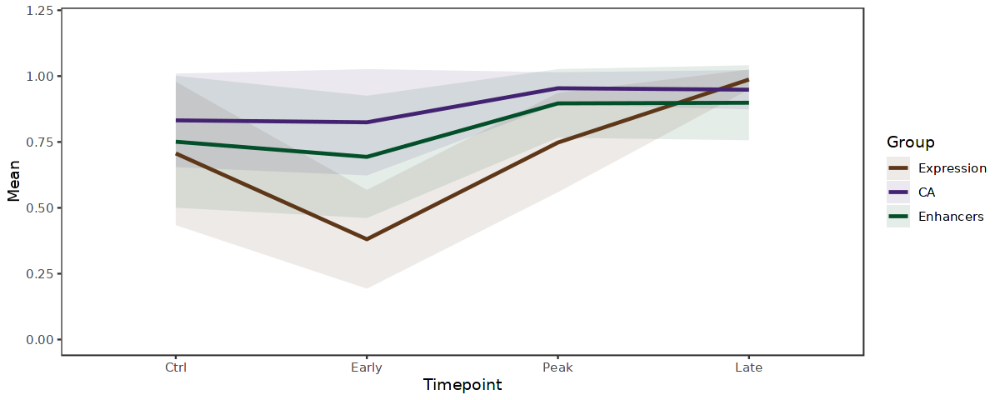

In [336]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

#### 3.1.3 OPC

In [11]:
cluster_choice = "OPC"

In [12]:
tmp <- subset(MORNAATACCOL, subset = cellType_OL_merge == cluster_choice)

Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_peaks_ol_ to umappeaksol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_bimod_ol_ to umapbimodol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_generegchrom_ol_ to pcageneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_generegchrom_ol_ to umapgeneregchromol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from pca_dorcs_ol_ to pcadorcsol_"
Warning message:
"Keys should be one or more alphanumeric characters followed by an underscore, setting key from umap_dorcs_ol_ to umapdorcsol_"


In [13]:
table_sample_low <- table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident)[cluster_choice,] <= 5]
table_sample_low

sample_keep <- names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)]

EarlyCtrl2   EarlyCtrl3    PeakCtrl3   EarlyMale3 EarlyFemale3 
           2            1            4            5            2

In [14]:
#Remove sample with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident %in% (names(table_sample_low)),])
tmp <- subset(tmp, cells=keepcells)

In [15]:
table_group_low <-table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,][table(MORNAATACCOL$cellType_OL_merge, MORNAATACCOL$orig.ident_merge)[cluster_choice,] <= 30]
table_group_low

group_keep <- names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)]

Early 
   26

In [16]:
#Remove timepoint with low number of cells
keepcells <- rownames(tmp@meta.data[!tmp$orig.ident_merge %in% (names(table_group_low)),])
tmp <- subset(tmp, cells=keepcells)

In [17]:
tmp$orig.ident <- factor(x = tmp$orig.ident, levels = names(orig.ident_colors)[!names(orig.ident_colors) %in% names(table_sample_low)])
tmp$orig.ident_merge <- factor(x = tmp$orig.ident_merge, levels = names(orig.ident_merge_colors)[!names(orig.ident_merge_colors) %in% names(table_group_low)])

In [18]:
DefaultAssay(tmp) <- "GenePromAcc"

In [19]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [20]:
DefaultAssay(tmp) <- "RNA"

In [21]:
tmp <- NormalizeData(tmp, normalization.method = "LogNormalize", scale.factor = 10000, margin = 1, verbose = TRUE)

Performing log-normalization
0%   10   20   30   40   50   60   70   80   90   100%
[----|----|----|----|----|----|----|----|----|----|
**************************************************|


In [22]:
dynamics_genes <- c("Epn2","Zfp704","Dusp26","Vwc2","Dnah5","Dnm1","Gm48091","Grik1","Emid1","Hdac9","Aldoc","Sncaip","Grm7","Egfem1","Ttll3","Meox1","Gpr158","Lpcat2","Adam12","Gabbr2","Ptprd","Tmem163","Rnf150","Dpp10","Kirrel3","Ror2","Pdzd2","Megf11","Igtp","Psmb8","Psme1","Shisa5","Rnf19b","Irgm2","Bst2","Tapbpl","Snx10","Mcam","Airn","Adamts1","Hspb1","Parp14","Vwa5a","Gbp3","Tlr3","Isg15","Parp12","Ifit3b","Top2a","Psmb9","Irf7","Irgm1","Col18a1","Cacng5","Mis18bp1","Nlrc5","Cebpd","Stat2","Xaf1","Tubb3","Irf1","Rras","Gm13684","Gbp7","Impa1","Chil3","Ifi27l2a","Serpina3i","Ly6a","H2-T23","Serpina3n","Casp12","Ciita","Gm3448","Cav2","Mt2","Ermard","Dkk3","Tes","Col16a1","C4b","Tgtp1","Gm4841","Wfdc17","Zbp1","Cd74","Iigp1","Clec2d","Gm12185","Hpgd","Gbp4","Gbp2","Ifit3","Gm3435","9030025P20Rik","Lyz2","Tgtp2","Gbp9","Saa3","Ccl6","Ifi47","Olfr56","Col20a1","Pros1","Oasl2","D130009I18Rik","Osmr","Gbp6","Serping1","Gm4951","Arhgef4","H2-D1","Erbb3","Cdh18","Dtx3l","Tap1","Stat1","Tmem176a","Plce1","Slc14a1","Mill2","H2-K1","Gm813","H2-Q4","H2-Q7","Itih5","B2m","Gbp5","Glis3","Tmsb10","Ccl5","Tafa1","Matn2","Mctp1","Tspo","Il17ra","Clvs1","Ly6e","Tmem176b","Gpnmb","Arg1","F830016B08Rik","Arpc1b","Mt1","Neat1","Parp11","Zfp521","Gm36107","C1ra","Itpkb","Tapbp","St3gal6","Cd274","AY036118","Vim","Ptprn","Gm50237","Rtp4","Chst2","H2-T22","H2-Ab1","Ranbp9","Sugct","Robo2","Nampt","Gpd1","Zfp365","Cp","Nfasc","Mroh3","Pou2f2","Kif20b","Galntl6","Alk","Mybl1","Shisa9","Kif26b","Plxna4")

In [23]:
gene_list <- dynamics_genes

##### 3.1.3.1 Heatmaps

In [838]:
Idents(object = tmp) <- "orig.ident"

In [839]:
sample_names <- levels(tmp$orig.ident)

In [840]:
sample_names <- sample_names[sample_names != "Early1"]

In [841]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [842]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [843]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [844]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [845]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [846]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [847]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [848]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [849]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [850]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [851]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [852]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [853]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [854]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing acro

In [855]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [856]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [857]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

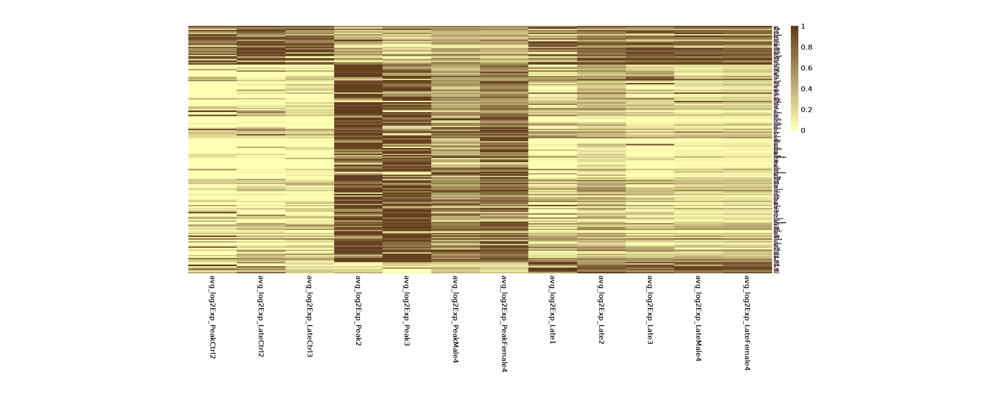

In [858]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [859]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [860]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [861]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [862]:
matrix <- tmp_sample_markers_RNA_mean

In [863]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

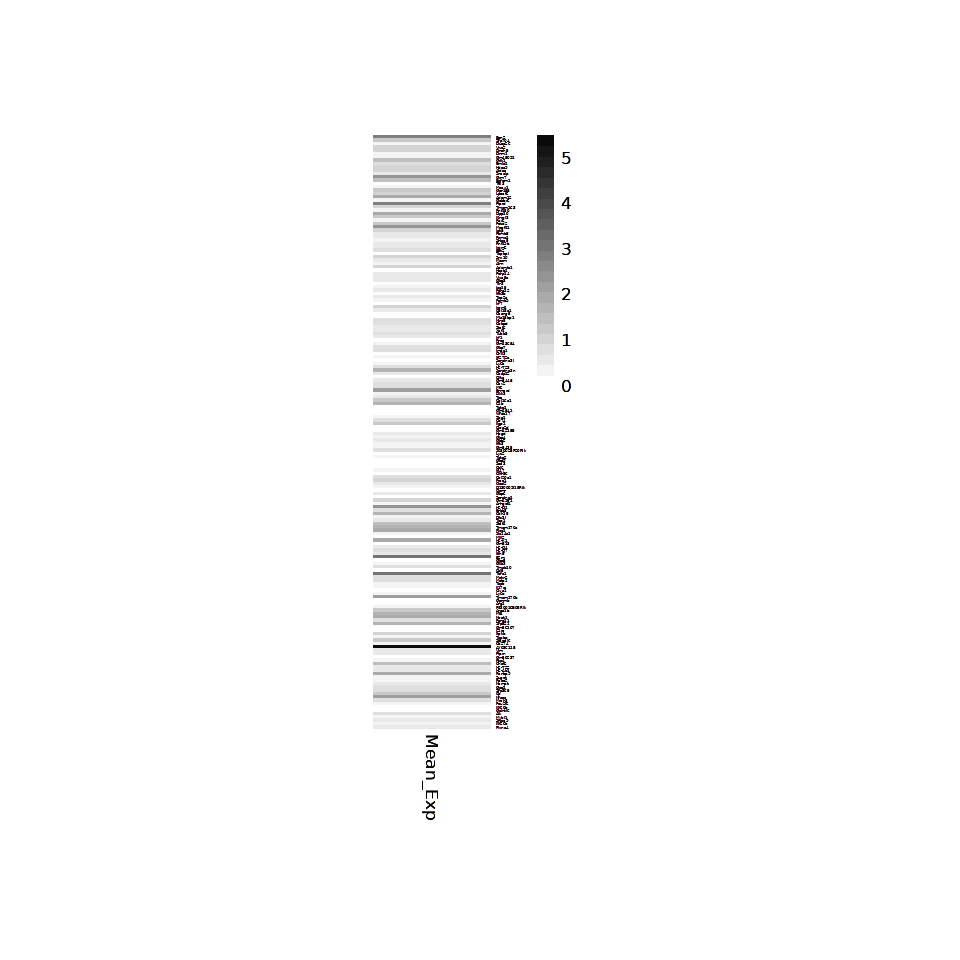

In [864]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, 
cluster_rows=FALSE)
ph

In [865]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [866]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [867]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

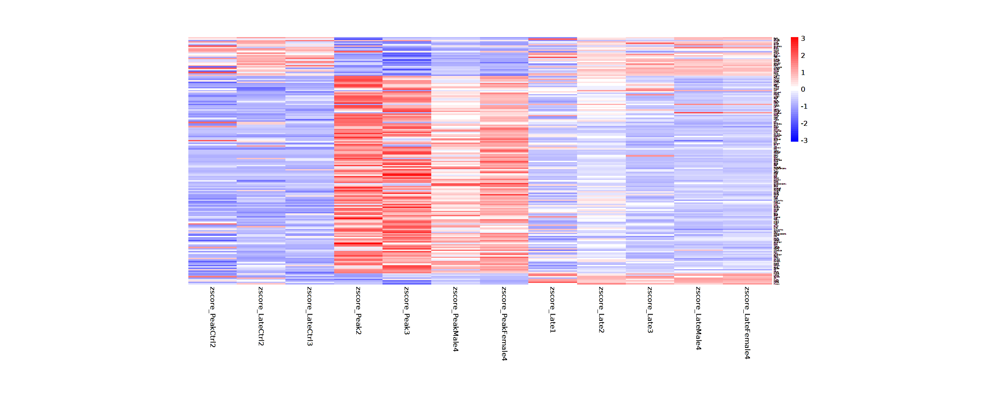

In [868]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [869]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [870]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [871]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [872]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [873]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [874]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

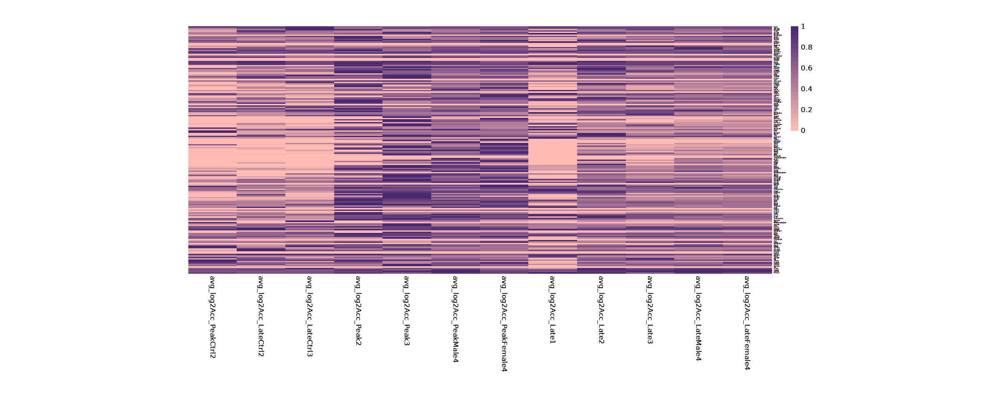

In [875]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [876]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [877]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [878]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [879]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [880]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [881]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

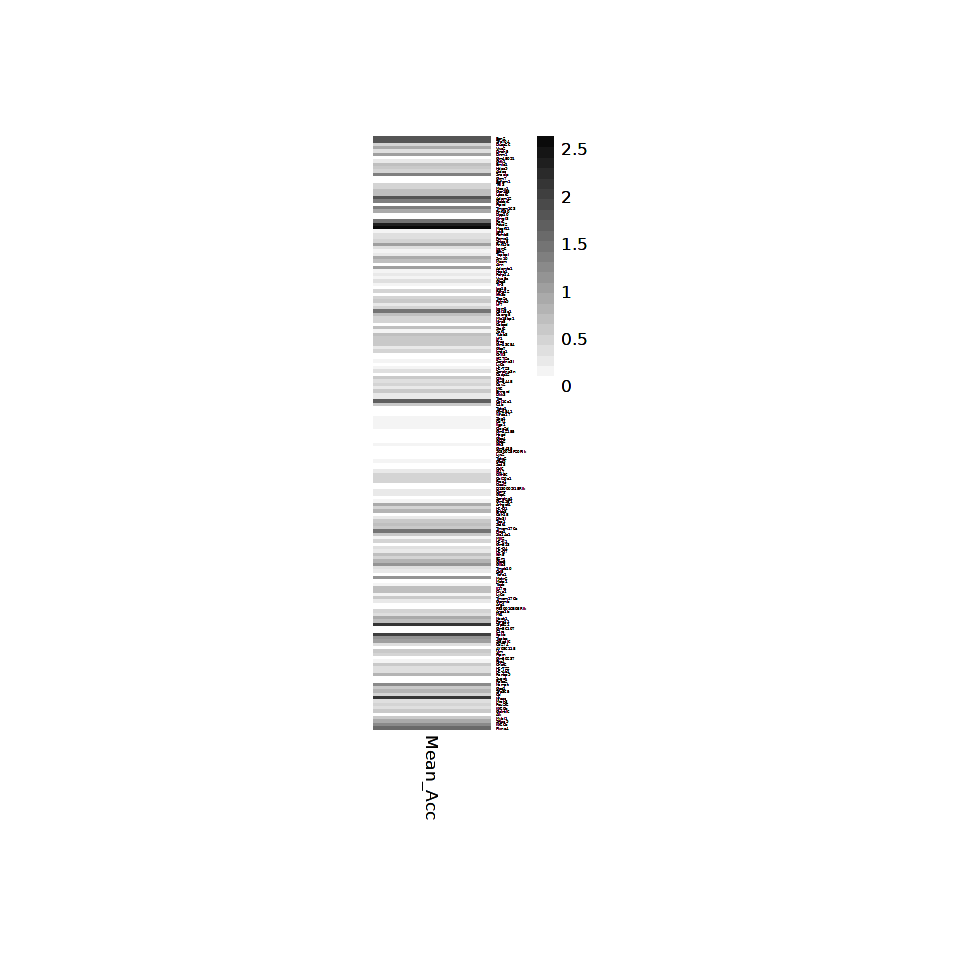

In [882]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [883]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [884]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [885]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [886]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [887]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

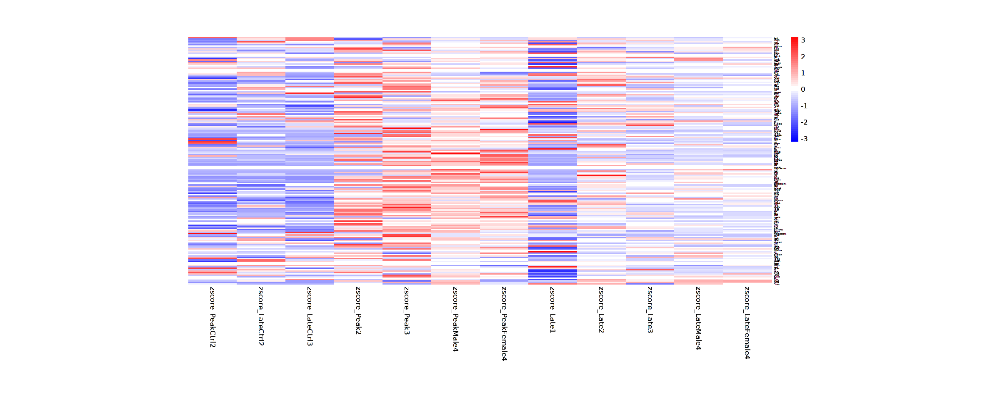

In [888]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [889]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [890]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [891]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [892]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [893]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [894]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

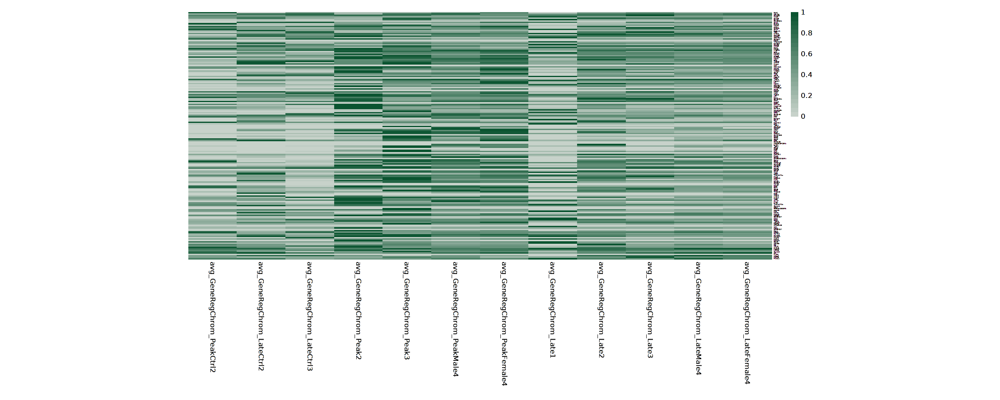

In [895]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [896]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep.pdf"), width=20, height=plot_height)

png 
  2

In [897]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [898]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [899]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [900]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [901]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

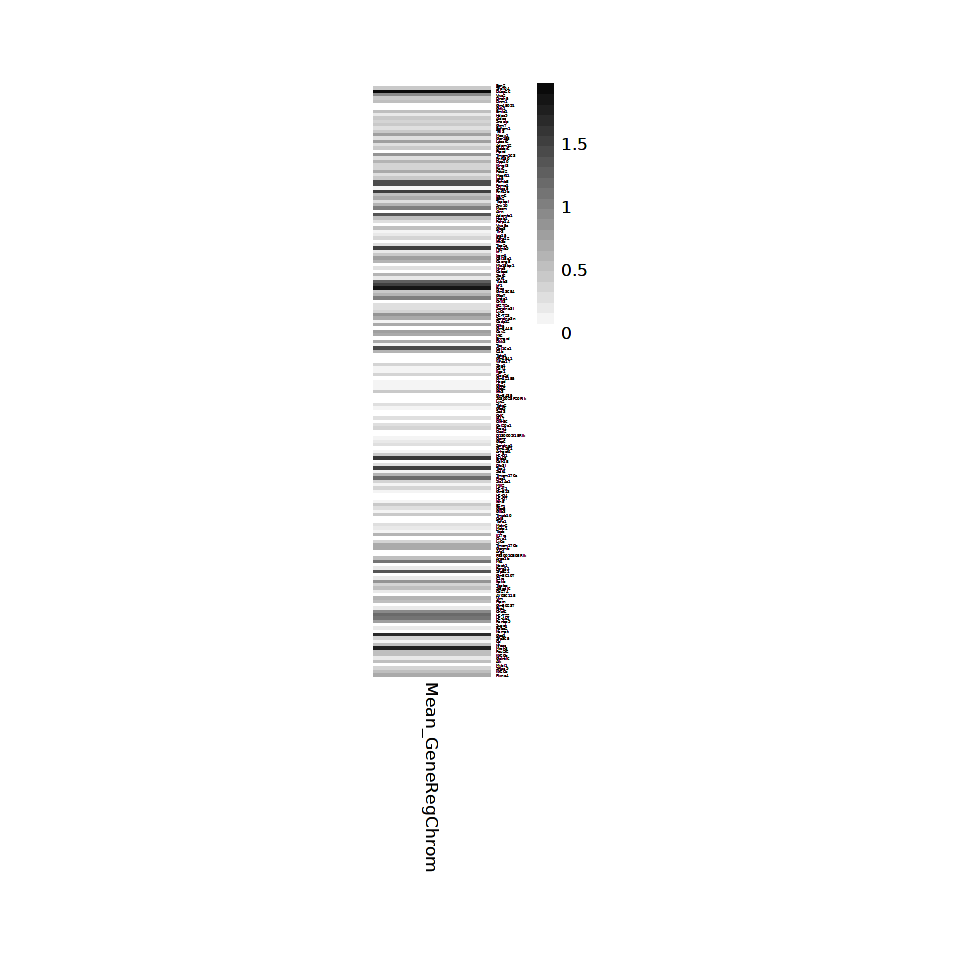

In [902]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [903]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_mean.pdf"), width=7, height=plot_height)

png 
  2

In [904]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [905]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [906]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [907]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

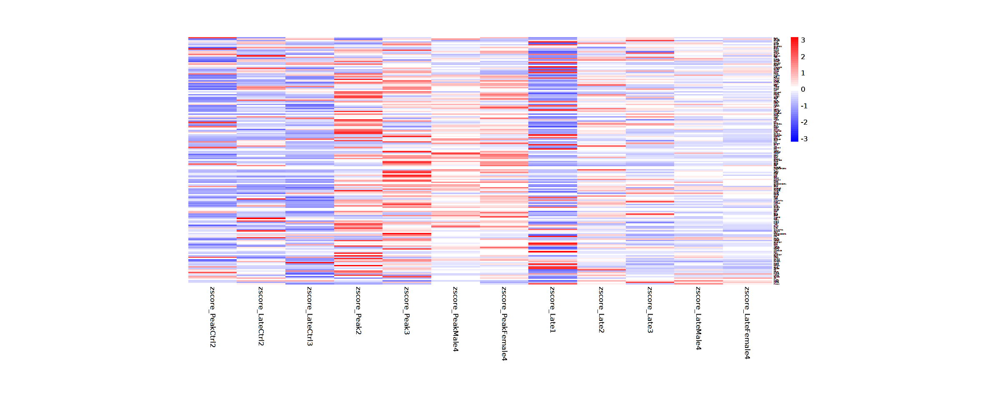

In [908]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [909]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_sep_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [910]:
Idents(object = tmp) <- "orig.ident_merge"

In [911]:
sample_names <- levels(tmp$orig.ident_merge)

In [912]:
sample_names <- sample_names[sample_names != "Early1"]

In [913]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [914]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [915]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [916]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [917]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [918]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [919]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [920]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [921]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [922]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [923]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [924]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [925]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [926]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [927]:
saveRDS(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".rds"))
saveRDS(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".rds"))

In [928]:
write.csv(tmp_sample_markers_RNA, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GenePromAcc_sub, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".csv"), row.names=TRUE)
write.csv(tmp_sample_markers_GeneRegChrom_sub, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".csv"), row.names=TRUE)

In [929]:
matrix <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [930]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFFFB3", "#5E3719"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

In [931]:
plot_height <- ifelse(as.integer(nrow(matrix)/20)<=5, 5, as.integer(nrow(matrix)/20))

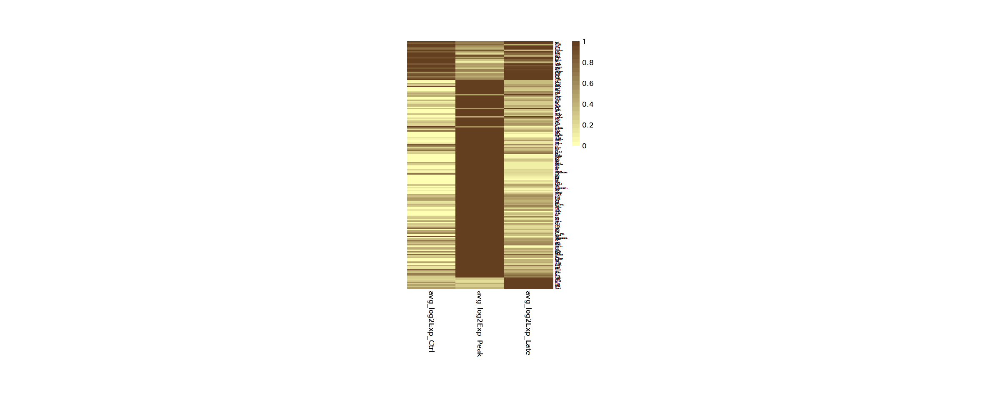

In [932]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [933]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [934]:
tmp_sample_markers_RNA_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Exp")))

In [935]:
tmp_sample_markers_RNA_mean[rownames(tmp_sample_markers_RNA),"Mean_Exp"] <- rowMeans(tmp_sample_markers_RNA)

In [936]:
matrix <- tmp_sample_markers_RNA_mean

In [937]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

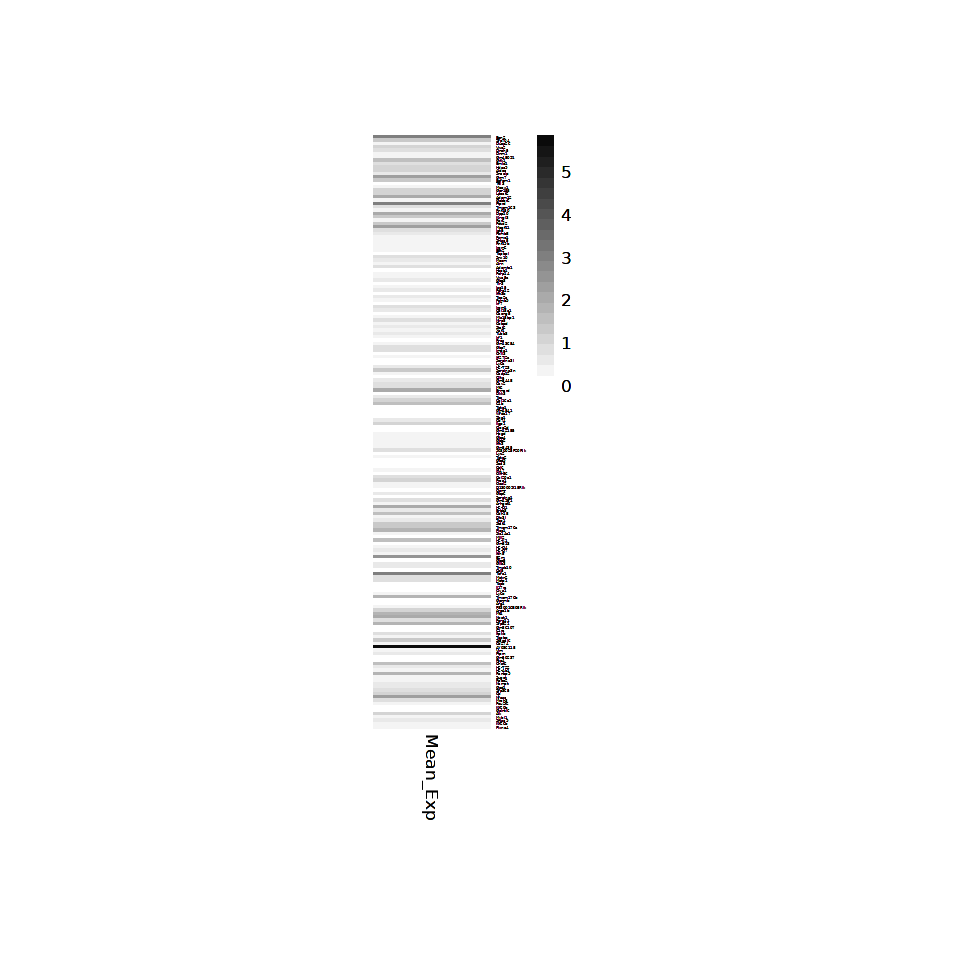

In [938]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [939]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [940]:
tmp_sample_markers_zscore <- t(apply(tmp_sample_markers_RNA[gene_list,], 1, scale))
colnames(tmp_sample_markers_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_zscore

In [941]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

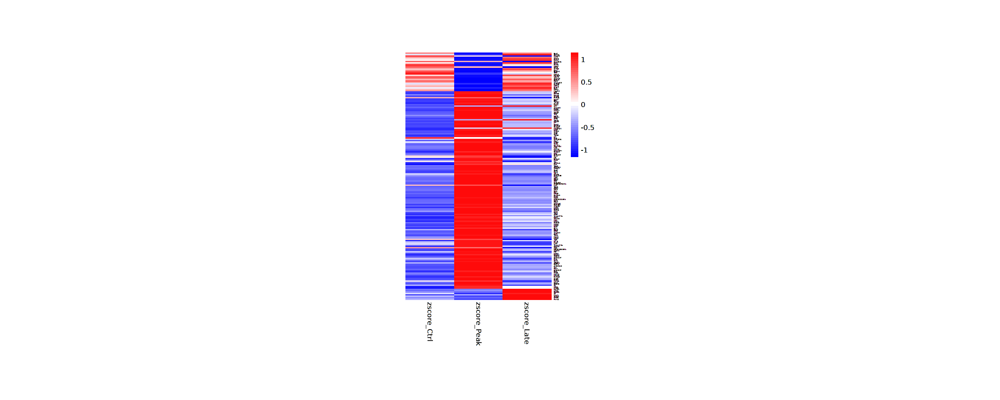

In [942]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [943]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_RNA_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [944]:
matrix <- tmp_sample_markers_GenePromAcc
matrix_sub <- tmp_sample_markers_GenePromAcc_sub

In [945]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [946]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [947]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [948]:
paletteLength <- 50
myColor <- colorRampPalette(c("#FFBCB5", "#432371"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

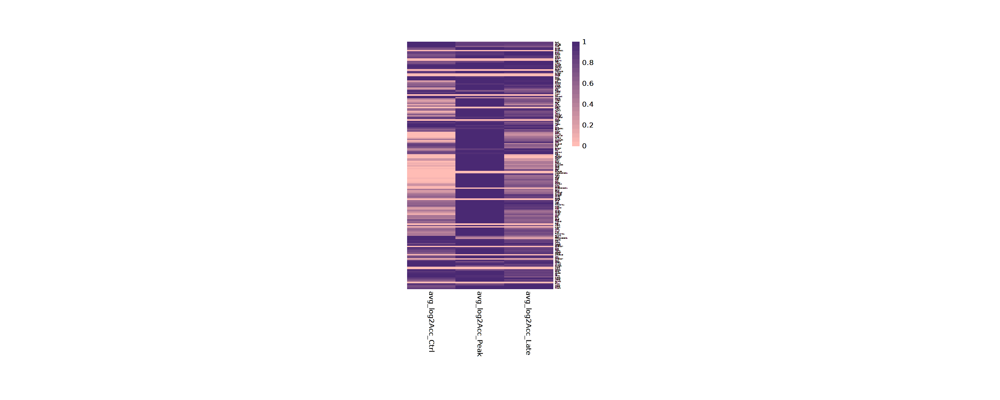

In [949]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [950]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [951]:
tmp_sample_markers_GenePromAcc_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_Acc")))

In [952]:
tmp_sample_markers_GenePromAcc_mean[rownames(tmp_sample_markers_GenePromAcc_sub),"Mean_Acc"] <- rowMeans(tmp_sample_markers_GenePromAcc_sub)

In [953]:
matrix <- tmp_sample_markers_GenePromAcc_mean

In [954]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [955]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

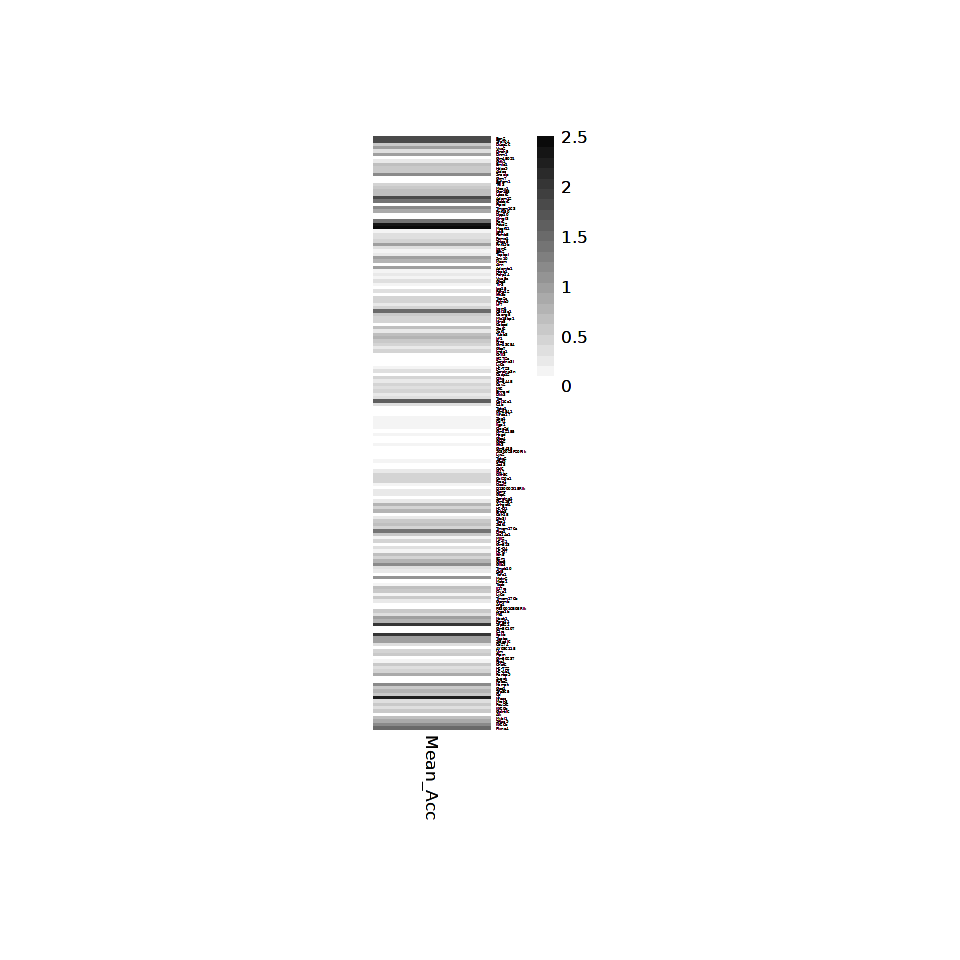

In [956]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [957]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [958]:
tmp_sample_markers_GenePromAcc[rownames(tmp_sample_markers_GenePromAcc_sub),] <- tmp_sample_markers_GenePromAcc_sub

In [959]:
tmp_sample_markers_GenePromAcc_zscore <- t(apply(tmp_sample_markers_GenePromAcc[gene_list,], 1, scale))
colnames(tmp_sample_markers_GenePromAcc_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GenePromAcc_zscore

In [960]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [961]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

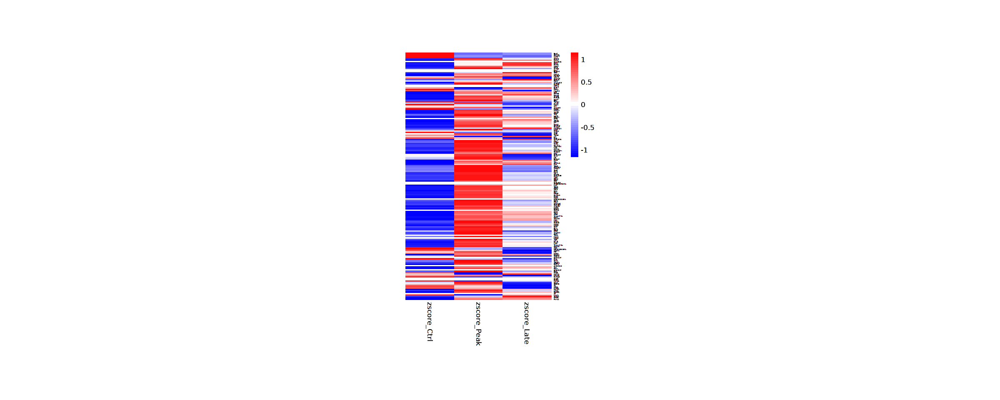

In [962]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [963]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Acc_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

In [964]:
matrix <- tmp_sample_markers_GeneRegChrom
matrix_sub <- tmp_sample_markers_GeneRegChrom_sub

In [965]:
matrix_sub <- matrix_sub/do.call(pmax, matrix_sub)

In [966]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.nan))

matrix_sub[is.nan.data.frame(matrix_sub)] <- 0

In [967]:
matrix[rownames(matrix_sub),] <- matrix_sub
matrix <- matrix[gene_list,]

In [968]:
paletteLength <- 50
myColor <- colorRampPalette(c("#C7D2CA", "#024F2A"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

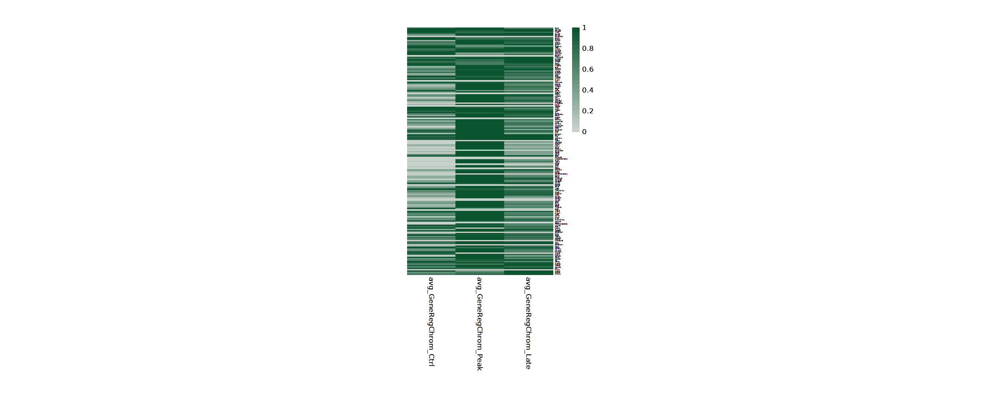

In [969]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [970]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,".pdf"), width=20, height=plot_height)

png 
  2

In [971]:
tmp_sample_markers_GeneRegChrom_mean <- data.frame(matrix(0L, ncol=1, nrow=length(gene_list), dimnames=list(gene_list, "Mean_GeneRegChrom")))

In [972]:
tmp_sample_markers_GeneRegChrom_mean[rownames(tmp_sample_markers_GeneRegChrom_sub),"Mean_GeneRegChrom"] <- rowMeans(tmp_sample_markers_GeneRegChrom_sub)

In [973]:
matrix <- tmp_sample_markers_GeneRegChrom_mean

In [974]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [975]:
paletteLength <- 50
myColor <- colorRampPalette(c("white", "black"))(paletteLength/2)
myBreaks <- c(seq(0, max(matrix), length.out=floor(paletteLength/2)))

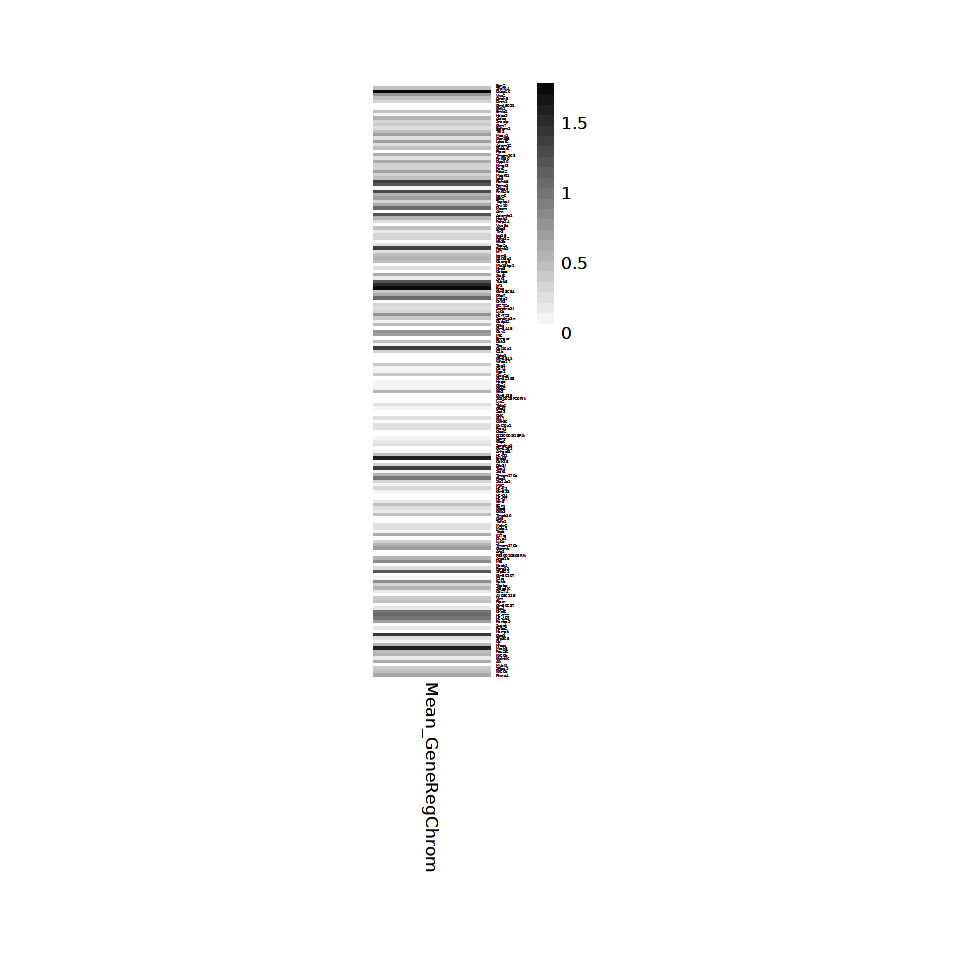

In [976]:
options(repr.plot.width=8, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [977]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_mean.pdf"), width=7, height=plot_height)

png 
  2

In [978]:
tmp_sample_markers_GeneRegChrom[rownames(tmp_sample_markers_GeneRegChrom_sub),] <- tmp_sample_markers_GeneRegChrom_sub

In [979]:
tmp_sample_markers_GeneRegChrom_zscore <- t(apply(tmp_sample_markers_GeneRegChrom[gene_list,], 1, scale))
colnames(tmp_sample_markers_GeneRegChrom_zscore) <- paste0("zscore_", sample_names)
matrix <- tmp_sample_markers_GeneRegChrom_zscore

In [980]:
is.nan.data.frame <- function(x)
do.call(cbind, lapply(x, is.na))

matrix[is.na.data.frame(matrix)] <- 0

In [981]:
paletteLength <- 100
myColor <- colorRampPalette(c("blue", "white", "red"))(paletteLength/2)
myBreaks <- c(seq(-max(abs(matrix)), max(abs(matrix)), length.out=floor(paletteLength/2)))
myColor[(paletteLength/4):((paletteLength/4)+1)] <- c("#FFFFFF", "#FFFFFF")

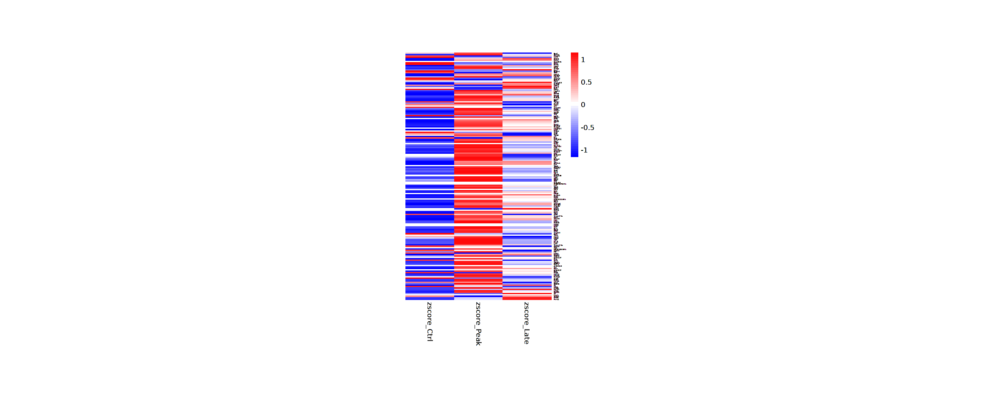

In [982]:
options(repr.plot.width=20, repr.plot.height=plot_height)
ph <- pheatmap(matrix, cellheight = 2, cellwidth = 70, fontsize_number = 2, fontsize_row=2, display_numbers = F, color=myColor, breaks=myBreaks, cluster_cols=FALSE, cluster_rows=FALSE)
ph

In [983]:
save_pheatmap_pdf(ph, paste0(OS_path_outputs, "Dynamics_DGE_Enhancers_",cluster_choice,"_zscore.pdf"), width=20, height=plot_height)

png 
  2

##### 3.1.3.2 Module dynamics

In [24]:
Idents(object = tmp) <- "orig.ident_merge"

In [25]:
sample_names <- levels(tmp$orig.ident_merge)

In [26]:
tmp_sample_markers_RNA <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Exp_", sample_names))))

In [27]:
sample_names <- sample_names[sample_names != "Early1"]

In [28]:
for (i in 1:length(colnames(tmp_sample_markers_RNA))){
    tmp_sample_markers_RNA[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "RNA", features = gene_list, slot = "data")[['RNA']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [29]:
tmp_sample_markers_GenePromAcc <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_log2Acc_", sample_names))))

In [30]:
gene_list_GenePromAcc <- gene_list[gene_list %in% rownames(tmp[['GenePromAcc']])]

In [31]:
genes0 <- names(rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,])[rowSums(tmp[['GenePromAcc']]@counts[gene_list_GenePromAcc,]) == 0])

In [32]:
gene_list_GenePromAcc <- gene_list_GenePromAcc[!gene_list_GenePromAcc %in% genes0]

In [33]:
tmp_sample_markers_GenePromAcc_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GenePromAcc), dimnames=list(gene_list_GenePromAcc, paste0("avg_log2Acc_", sample_names))))

In [34]:
for (i in 1:length(colnames(tmp_sample_markers_GenePromAcc_sub))){
    tmp_sample_markers_GenePromAcc_sub[,i] <- log2(as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GenePromAcc", features = gene_list_GenePromAcc, slot = "data")[['GenePromAcc']])+1)
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [35]:
tmp_sample_markers_GeneRegChrom <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list), dimnames=list(gene_list, paste0("avg_GeneRegChrom_", sample_names))))

In [36]:
gene_list_GeneRegChrom <- gene_list[gene_list %in% rownames(tmp[['GeneRegChrom']])]

In [37]:
genes0 <- names(rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,])[rowSums(tmp[['GeneRegChrom']]@counts[gene_list_GeneRegChrom,]) == 0])

In [38]:
gene_list_GeneRegChrom <- gene_list_GeneRegChrom[!gene_list_GeneRegChrom %in% genes0]

In [39]:
tmp_sample_markers_GeneRegChrom_sub <- data.frame(matrix(0L, ncol=length(sample_names), nrow=length(gene_list_GeneRegChrom), dimnames=list(gene_list_GeneRegChrom, paste0("avg_GeneRegChrom_", sample_names))))

In [40]:
for (i in 1:length(colnames(tmp_sample_markers_GeneRegChrom_sub))){
    tmp_sample_markers_GeneRegChrom_sub[,i] <- as.vector(AverageExpression(subset(x = tmp, subset = orig.ident_merge == sample_names[i]), assays = "GeneRegChrom", features = gene_list_GeneRegChrom, slot = "counts")[['GeneRegChrom']])
}

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.

The following grouping variables have 1 value and will be ignored: ident

All grouping variables have 1 value only. Computing across all cells.



In [41]:
tmp_sample_markers_RNA_scaled <- tmp_sample_markers_RNA/do.call(pmax, tmp_sample_markers_RNA)

In [42]:
tmp_sample_markers_GenePromAcc_sub_scaled <- tmp_sample_markers_GenePromAcc_sub/do.call(pmax, tmp_sample_markers_GenePromAcc_sub)

In [43]:
tmp_sample_markers_GeneRegChrom_sub_scaled <- tmp_sample_markers_GeneRegChrom_sub/do.call(pmax, tmp_sample_markers_GeneRegChrom_sub)

###### 3.1.3.2.1 Category 1

In [44]:
gene_list <- c("Epn2","Zfp704","Dusp26","Vwc2","Dnah5","Dnm1","Gm48091","Grik1","Emid1","Hdac9","Aldoc","Sncaip","Grm7","Egfem1","Ttll3","Meox1","Gpr158","Lpcat2","Adam12","Gabbr2","Ptprd","Tmem163","Rnf150","Dpp10","Kirrel3","Ror2","Pdzd2","Megf11")

In [45]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [46]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [47]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [48]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [49]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Peak","Late"),3),
  Group=c(rep("Expression",3), rep("CA",3), rep("Enhancers",3))
)

In [50]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

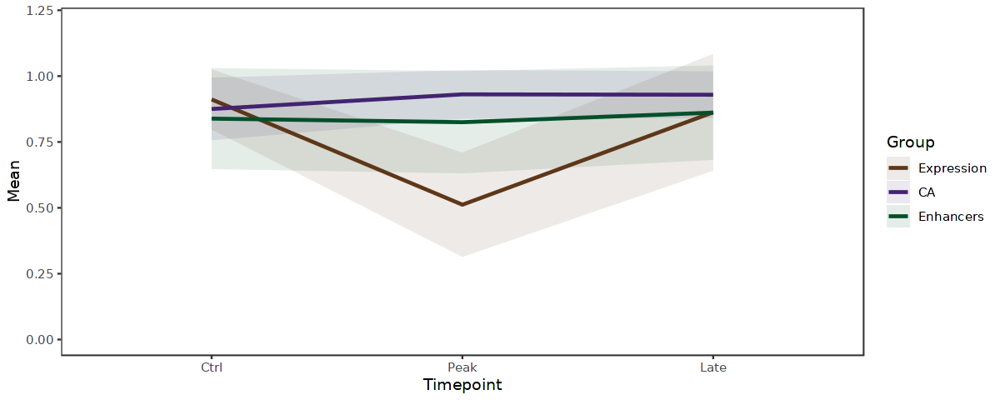

In [51]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(0, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.2 Category 2

In [52]:
gene_list <- c("Igtp","Psmb8","Psme1","Shisa5","Rnf19b","Irgm2","Bst2","Tapbpl","Snx10","Mcam","Airn","Adamts1","Hspb1","Parp14","Vwa5a","Gbp3","Tlr3","Isg15","Parp12","Ifit3b","Top2a","Psmb9","Irf7","Irgm1","Col18a1","Cacng5","Mis18bp1","Nlrc5","Cebpd","Stat2","Xaf1","Tubb3","Irf1","Rras","Gm13684","Gbp7","Impa1","Chil3","Ifi27l2a","Serpina3i","Ly6a","H2-T23","Serpina3n","Casp12","Ciita","Gm3448","Cav2","Mt2","Ermard","Dkk3","Tes","Col16a1","C4b","Tgtp1","Gm4841","Wfdc17","Zbp1","Cd74","Iigp1","Clec2d","Gm12185","Hpgd","Gbp4","Gbp2","Ifit3","Gm3435","9030025P20Rik","Lyz2","Tgtp2","Gbp9","Saa3","Ccl6","Ifi47","Olfr56","Col20a1","Pros1","Oasl2","D130009I18Rik","Osmr","Gbp6","Serping1","Gm4951","Arhgef4","H2-D1","Erbb3","Cdh18","Dtx3l","Tap1","Stat1","Tmem176a","Plce1","Slc14a1","Mill2","H2-K1","Gm813","H2-Q4","H2-Q7","Itih5","B2m","Gbp5","Glis3","Tmsb10","Ccl5","Tafa1","Matn2","Mctp1","Tspo","Il17ra","Clvs1","Ly6e","Tmem176b","Gpnmb","Arg1","F830016B08Rik","Arpc1b","Mt1","Neat1","Parp11","Zfp521","Gm36107","C1ra","Itpkb","Tapbp","St3gal6","Cd274","AY036118","Vim","Ptprn","Gm50237","Rtp4","Chst2","H2-T22","H2-Ab1","Ranbp9","Sugct","Robo2","Nampt","Gpd1","Zfp365","Cp","Nfasc","Mroh3")

In [53]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [54]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [55]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [56]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [57]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Peak","Late"),3),
  Group=c(rep("Expression",3), rep("CA",3), rep("Enhancers",3))
)

In [58]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

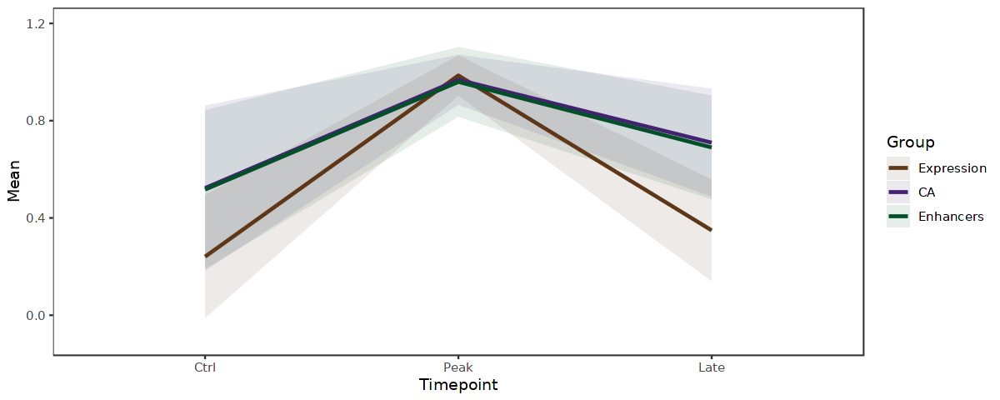

In [59]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())

###### 3.1.1.2.3 Category 3

In [60]:
gene_list <- c("Pou2f2","Kif20b","Galntl6","Alk","Mybl1","Shisa9","Kif26b","Plxna4")

In [61]:
gene_list <- gene_list[gene_list %in% dynamics_genes]

In [62]:
df_RNA <- tmp_sample_markers_RNA_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_RNA_scaled)],]
df_GenePromAcc <- tmp_sample_markers_GenePromAcc_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GenePromAcc_sub_scaled)],]
df_GeneRegChrom <- tmp_sample_markers_GeneRegChrom_sub_scaled[gene_list[gene_list %in% rownames(tmp_sample_markers_GeneRegChrom_sub_scaled)],]

In [63]:
mean_RNA <- sapply(df_RNA, mean)
mean_GenePromAcc <- sapply(df_GenePromAcc, mean)
mean_GeneRegChrom <- sapply(df_GeneRegChrom, mean)

In [64]:
sd_RNA <- sapply(df_RNA, sd)
sd_GenePromAcc <- sapply(df_GenePromAcc, sd)
sd_GeneRegChrom <- sapply(df_GeneRegChrom, sd)

In [65]:
df <- data.frame(
  Mean=c(mean_RNA,mean_GenePromAcc,mean_GeneRegChrom),
  SD=c(sd_RNA,sd_GenePromAcc,sd_GeneRegChrom),
  Timepoint=rep(c("Ctrl","Peak","Late"),3),
  Group=c(rep("Expression",3), rep("CA",3), rep("Enhancers",3))
)

In [66]:
df$Timepoint <- factor(df$Timepoint, levels = c("Ctrl","Peak","Late"))
df$Group <- factor(df$Group, levels = c("Expression","CA","Enhancers"))

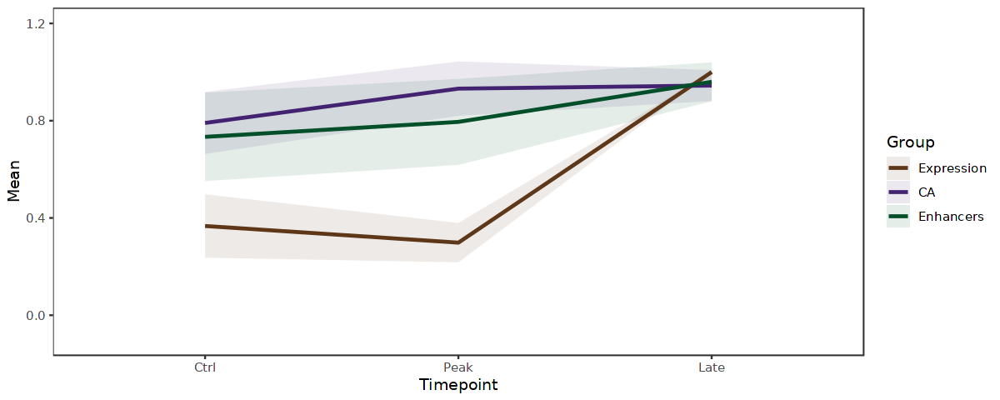

In [67]:
options(repr.plot.width=10, repr.plot.height=4)
ggplot(data = df, aes(x = Timepoint, group = Group)) + 
  geom_ribbon(aes(y = Mean, ymin = Mean - SD, ymax = Mean + SD, fill = Group), alpha = .1) +
  geom_line(aes(y = Mean, color = Group), linewidth = 1) + 
  scale_color_manual(values=c("#5E3719", "#432371","#024F2A")) +
  scale_fill_manual(values=c("#5E3719", "#432371","#024F2A")) +
  ylim(-0.1, 1.2) +
  theme_bw() +
  theme(panel.grid.major = element_blank(), panel.grid.minor = element_blank())